In [1]:
import os

import numpy as np
import math
import uproot as uproot
import pandas as pd

import matplotlib.pyplot as plt
import matplotlib.colors
from matplotlib.colors import LinearSegmentedColormap
from matplotlib import ticker
from matplotlib.ticker import (AutoMinorLocator, MultipleLocator)
from matplotlib import gridspec
import dunestyle.matplotlib as dunestyle

import scipy.stats as stats
from scipy.stats import norm
from scipy.stats import median_abs_deviation
from scipy.interpolate import CubicSpline
from scipy.optimize import curve_fit
import scipy.linalg as la
import scipy.optimize as opt
from scipy.optimize import Bounds, LinearConstraint
from scipy.stats import chisquare

import pandas_helpers as ph
import cc2p_reco_var as cc2preco
import stat_helpers as sh

#np.seterr(divide='ignore', invalid='ignore')
np.seterr(divide='ignore', invalid='ignore', over='ignore')

DUNE plot style enabled


{'divide': 'warn', 'over': 'warn', 'under': 'ignore', 'invalid': 'warn'}

In [2]:
def InFV_trk(data): # cm
    xmin = -190.
    ymin = -190.
    zmin = 10.
    xmax = 190.
    ymax =  190.
    zmax =  490.
    return (data.x > xmin) & (data.x < xmax) & (data.y > ymin) & (data.y < ymax) & (data.z > zmin) & (data.z < zmax)

def InFV(data): # cm
    xmin = -190.
    ymin = -190.
    zmin = 10.
    xmax = 190.
    ymax =  190.
    zmax =  450.
    return (np.abs(data.x) > 10) & (np.abs(data.x) < 190) & (data.y > ymin) & (data.y < ymax) & (data.z > zmin) & (data.z < zmax)

In [3]:
## -- for MC spring 25, Moon processed CAF without SCE correction
#### ==== but measured c_cal of the sample is 2.019e-2

mc_file = "/exp/sbnd/data/users/apapadop/dfs/v10_06_00_02/2025B_final_valid_v_10_06_00_02_mc_bnb_cosmics_pandora.df"
mc_hdr_df = pd.read_hdf(mc_file, key='hdr')
mc_pot_df = pd.read_hdf(mc_file, key='pot')
mc_reco_df_ = pd.read_hdf(mc_file, key='evt')
mc_nudf_ = pd.read_hdf(mc_file, key='mcnu')

In [5]:
mc_hdr_df

pot  first_in_subrun  ismc  run  subrun  ngenevt  \
__ntuple entry                                                              
68       0      1.336361e+15                1     1   26      79      100   
         1      0.000000e+00                0     1   26      79      100   
         2      0.000000e+00                0     1   26      79      100   
         3      0.000000e+00                0     1   26      79      100   
         4      0.000000e+00                0     1   26      79      100   
...                      ...              ...   ...  ...     ...      ...   
996      137    0.000000e+00                0     1   77      85      100   
         138    0.000000e+00                0     1   77      85      100   
         139    0.000000e+00                0     1   77      85      100   
         140    0.000000e+00                0     1   77      85      100   
         141    0.000000e+00                0     1   77      85      100   

                evt  proc   cluster  fno  
__ntuple entry                            
68       0        1     0  21094435    0  
         1       10     0  21094435    0  
         2       13     0  21094435    0  
         3       18     0  21094435    0  
         4       19     0  21094435    0  
...             ...   ...       ...  ...  
996      137     77     0  21106772    0  
         138     84     0  21106772    0  
         139     87     0  21106772    0  
         140     93     0  21106772    0  
         141     97     0  21106772    0  

[172607 rows x 10 columns]

In [ ]:
mc_intime_file = "/exp/sbnd/data/users/apapadop/dfs/v10_06_00_02/2025B_final_valid_v_10_06_00_02_data_intime_cosmics_300file_pandora.df"
mc_intime_hdr_df = pd.read_hdf(mc_intime_file, key='hdr')

TypeError: cannot pass a where specification when reading from a Fixed format store. this store must be selected in its entirety

In [5]:
mc_intime_pot_df = pd.read_hdf(mc_intime_file, key='pot')

In [ ]:
mc_intime_reco_df_ = pd.read_hdf(mc_intime_file, key='evt')

In [ ]:


## -- for data spring 25
#### ==== default CAF: 100 ms e-lifetime correction
#data_file = "/data/sungbino/sbnd/2025B/2025B_final_valid_data_bnb_light_pandora.df"
#### ==== reprocessed CAF: 35 ms e-lifetime correction
data_file = "/exp/sbnd/data/users/apapadop/dfs/v10_06_00_02/2025B_final_valid_data_bnb_light_etau_35ms_pandora.df"
#### == reprocessed CAF: 35 ms e-lifetime correction and corresponding C_cals
#data_file = "/data/sungbino/sbnd/2025B/2025B_data_bnb_light_etau_ccal_v10_06_00_pandora.df"
data_hdr_df = pd.read_hdf(data_file, key='hdr')
data_pot_df = pd.read_hdf(data_file, key='pot')
data_reco_df_ = pd.read_hdf(data_file, key='evt')

FileNotFoundError: File /exp/data/sungbino/sbnd/2025B/2025B_final_valid_mc_bnb_cosmics_pandora.df does not exist

In [5]:
sample_str = "2025B (v10_06_00)"

In [6]:
mc_nudf_ = pd.read_hdf(mc_file, key='mcnu')

In [7]:
## POT and Gate accounting
#### == POT
mc_tot_pot = mc_hdr_df['pot'].sum()
data_tot_pot = data_hdr_df['pot'].sum()
data_tot_TOR860 = data_pot_df['TOR860'].sum()
data_tot_TOR875 = data_pot_df['TOR875'].sum()

#### == Gate
f_factor = 0.08 ## -- page 6 of https://sbn-docdb.fnal.gov/cgi-bin/sso/RetrieveFile?docid=41013&filename=2025-05-08_Absolute-Normalization-Data-MC.pdf&version=4
data_gates = len(data_pot_df)
intime_gates = ngenevt_sum = mc_intime_hdr_df[mc_intime_hdr_df['first_in_subrun'] == 1]['ngenevt'].sum()

print("mc_tot_pot: %e" %(mc_tot_pot))
print("data_tot_pot: %e" %(data_tot_pot))
print("data_tot_TOR860: %e" %(data_tot_TOR860))
print("data_tot_TOR875: %e" %(data_tot_TOR875))
target_pot = data_tot_pot
mc_pot_scale = target_pot / mc_tot_pot
print("target pot: %e" % (target_pot))
print("MC POT scale: %.3f" %(mc_pot_scale))

print("data_gates: %e" %(data_gates))
print("intime_gates: %e" %(intime_gates))
mc_gate_scale = (1. - f_factor) * (data_gates + 0.) / (intime_gates + 0.)
mc_gate_scale = mc_gate_scale # * 2. * 1.08 ## it is just for a test FIXME
print("MC gate scale: %.3f" %(mc_gate_scale))

mc_tot_pot: 5.787966e+19
data_tot_pot: 4.596608e+18
data_tot_TOR860: 4.554151e+18
data_tot_TOR875: 4.596608e+18
target pot: 4.596608e+18
MC POT scale: 0.079
data_gates: 9.554510e+05
intime_gates: 2.433700e+07
MC gate scale: 0.036


In [8]:
data_hdr_df.run.value_counts()

run
18255    65801
18259    23743
Name: count, dtype: int64

In [9]:
## -- truth level flags
def Signal(df): # definition
    is_fv = InFV(df.position)
    is_numu = (df.pdg == 14) | (df.pdg == -14)
    is_cc = (df.iscc == 1)
    is_coh = (df.genie_mode == 3)
    is_1pi0p = (df.nmu_40MeV == 1) & (df.npi_30MeV == 1) & (df.np_50MeV == 0) & (df.npi0 == 0)
    return is_fv & is_numu & is_cc & is_1pi0p & is_coh

def CCCOH(df):
    is_cc = df.iscc
    genie_mode = df.genie_mode
    return is_cc & (genie_mode == 3)

In [10]:
mc_reco_df = mc_reco_df_
mc_nudf = mc_nudf_
mc_intime_reco_df = mc_intime_reco_df_
data_reco_df = data_reco_df_

In [11]:
is_fv = InFV(mc_nudf.position)
is_signal = Signal(mc_nudf)
is_cc = mc_nudf.iscc
genie_mode = mc_nudf.genie_mode
w = mc_nudf.w

try :
    nuint_categ = pd.Series(8, index=mc_nudf.index)
    #print(f"done init nuint_categ")
except Exception as e:
    print(f"Error init nuint_categ")

nuint_categ[~is_fv] = -1  # Out of FV
nuint_categ[is_fv & ~is_cc] = 0  # NC
nuint_categ[is_fv & is_cc & is_signal] = 1  # Signal
nuint_categ[is_fv & is_cc & ~is_signal & (genie_mode == 3)] = 2  # Non-signal CCCOH
nuint_categ[is_fv & is_cc & (genie_mode == 0)] = 3  # CCQE
nuint_categ[is_fv & is_cc & (genie_mode == 10)] = 4  # 2p2h
nuint_categ[is_fv & is_cc & (genie_mode != 0) & (genie_mode != 3) & (genie_mode != 10) & ((w < 1.4) | (genie_mode == 1))] = 5  # RES
nuint_categ[is_fv & is_cc & (genie_mode != 0) & (genie_mode != 3) & (genie_mode != 10) & ((w > 2.0) | (genie_mode == 2))] = 6  # DIS
nuint_categ[is_fv & is_cc & ((1.4 < w) & (w < 2.0) & (genie_mode != 1) & (genie_mode != 2) & (genie_mode != 0) & (genie_mode != 3) & (genie_mode != 10))] = 7  # INEL

mc_nudf['nuint_categ'] = nuint_categ

In [12]:
def add_n_slice_col(reco_df):
    df_reset = reco_df.reset_index()
    slc_counts = (
        df_reset[['__ntuple', 'entry', 'rec.slc..index']]
        .drop_duplicates()
        .groupby(['__ntuple', 'entry'])
        .size()
        .reset_index(name='n_slc_per_entry')
    )

    slc_counts.columns = pd.MultiIndex.from_tuples([
        ('__ntuple', '', '', '', '', ''),
        ('entry', '', '', '', '', ''),
        ('slc', 'n_slc_per_entry', '', '', '', '')
    ])
    df_reset = df_reset.merge(slc_counts, on=[('__ntuple', '', '', '', '', ''), ('entry', '', '', '', '', '')])
    df_reset = df_reset.set_index(["__ntuple", "entry", "rec.slc..index", "rec.slc.reco.pfp..index"], verify_integrity=True)
    return df_reset

In [13]:
mc_reco_df = add_n_slice_col(mc_reco_df)
mc_intime_reco_df = add_n_slice_col(mc_intime_reco_df)
data_reco_df = add_n_slice_col(data_reco_df)

In [14]:
## 1) Vertex FV
mc_reco_df = mc_reco_df[InFV(mc_reco_df.slc.vertex)]
mc_intime_reco_df = mc_intime_reco_df[InFV(mc_intime_reco_df.slc.vertex)]
data_reco_df = data_reco_df[InFV(data_reco_df.slc.vertex)]

## 2) Not clear cosmic
mc_reco_df = mc_reco_df[mc_reco_df.slc.is_clear_cosmic == 0]
mc_intime_reco_df = mc_intime_reco_df[mc_intime_reco_df.slc.is_clear_cosmic == 0]
data_reco_df = data_reco_df[data_reco_df.slc.is_clear_cosmic == 0]

In [15]:
# match for mc bnb cosmic
mc_nudf.columns = pd.MultiIndex.from_tuples([('gen',) + col if isinstance(col, tuple) else ('gen', col) for col in mc_nudf.columns])
mc_nudf.columns = pd.MultiIndex.from_tuples([
    col + ('',) * (6 - len(col)) for col in mc_nudf.columns
])
mc_reco_df = ph.multicol_merge(mc_reco_df.reset_index(), mc_nudf.reset_index(),
                            left_on=[('__ntuple', '', '', '', '', ''), ('entry', '', '', '', '', ''), ('slc','tmatch', 'idx', '', '', '')],
                            right_on=[('__ntuple', '', '', '', '', ''), ('entry', '', '', '', '', ''), ('rec.mc.nu..index', '','', '', '', '')], 
                            how="left") ## -- save all sllices
mc_reco_df = mc_reco_df.set_index(["__ntuple", "entry", "rec.slc..index", "rec.slc.reco.pfp..index"], verify_integrity=True)
mc_reco_df.loc[mc_reco_df[('gen', 'nuint_categ', '', '', '', '')].isna(), [('gen', 'nuint_categ', '', '', '', '')]] = -2


In [16]:
mc_reco_df
mc_intime_reco_df[('gen', 'nuint_categ', '', '', '', '')] = -3

In [17]:
# selected true neutrino events interaction breakdown
mode_list = [1, 2, 0, 3, 4, 5, 6, -1, -2, -3]
mode_labels = ["Signal", "Non-Sig. CCCOH", "NC", "QE", "2p2h", "RES", "DIS", "Non-FV", "Others", "Intime Cosmics"]
colors = ['#d62728',  # Red            
          '#1f77b4',  # Blue
          '#ff7f0e',  # Orange
          '#2ca02c',  # Green
          '#17becf',  # Teal
          '#9467bd',  # Purple
          '#8c564b',  # Brown
          '#e377c2',  # Pink
          '#7f7f7f',  # Gray
          '#bcbd22']  # Yellow-green
          #'#17becf']  # Teal

def draw_reco_stacked_hist(var_mc_bnb_cosmic, var_mc_intime_cosmic, is_logx, is_logy,
                           title_x, title_y, x_min, x_max, nbins, outname,
                           data_overlay=False, var_data=[], draw_density=False):
    
    ## Define the output figure to have two pads
    fig = plt.figure(figsize=(8, 8), dpi=100)
    gs = gridspec.GridSpec(2, 1, height_ratios=[5, 1], hspace=0.10)
    ax_main = fig.add_subplot(gs[0])
    ax_ratio = fig.add_subplot(gs[1], sharex=ax_main)
    
    if is_logx:
        ax_main.set_xscale('log')
        ax_ratio.set_xscale('log')        
    if is_logy:
        ax_main.set_yscale('log')


    ax_main.set_xlabel("")  # Only bottom has x-label
    ax_main.set_ylabel(title_y)
    ax_ratio.set_ylabel("Data/MC", fontsize=12)
    ax_ratio.set_xlabel(title_x, fontsize = 20)

    ax_ratio.axhline(1.0, color='red', linestyle='--', linewidth=1)
    ax_ratio.set_ylabel("Data/MC", fontsize=12)
    ax_ratio.set_xlabel(title_x, fontsize=12)
    ax_ratio.set_ylim(0.4, 1.6)
    ax_ratio.tick_params(width=2, length=6)
    for spine in ax_ratio.spines.values():
        spine.set_linewidth(2)

    plt.setp(ax_main.get_xticklabels(), visible=False)

    ## Define scaling parameters
    POT_scale = 1.
    Gate_scale = 1.
    if not draw_density:
        POT_scale = mc_pot_scale
        Gate_scale = mc_gate_scale

    ## Defind binning
    if is_logx:
        bins = np.logspace(np.log10(x_min), np.log10(x_max), nbins + 1)
        bin_centers = np.sqrt(bins[:-1] * bins[1:])
    else:
        bins = np.linspace(x_min, x_max, nbins + 1)
        bin_centers = 0.5 * (bins[:-1] + bins[1:])

    ## Define data for MC
    all_mc_data = var_mc_bnb_cosmic + var_mc_intime_cosmic
    all_weights = (
        [np.ones_like(data) * POT_scale for data in var_mc_bnb_cosmic] +
        [np.ones_like(data) * Gate_scale for data in var_mc_intime_cosmic]
    )
    each_mc_hist_data = [np.histogram(data, bins=bins, weights=w)[0] for data, w in zip(all_mc_data, all_weights)]
    total_mc = np.sum(each_mc_hist_data, axis=0)

    ## Plot stacked MC
    hist_data, bins, _ = ax_main.hist(all_mc_data,
                                      bins=bins,
                                      weights=all_weights,
                                      stacked=True,
                                      color=colors,
                                      label=mode_labels,
                                      edgecolor='none',
                                      linewidth=0,
                                      density=draw_density,
                                      histtype='stepfilled')

    max_y = np.max(total_mc)

    ## Plot MC stat error box
    each_mc_hist_data = []
    each_mc_hist_err2 = []  # sum of squared weights for error

    for data, w in zip(all_mc_data, all_weights):
        hist_vals, _ = np.histogram(data, bins=bins, weights=w)
        hist_err2, _ = np.histogram(data, bins=bins, weights=np.square(w))
        each_mc_hist_data.append(hist_vals)
        each_mc_hist_err2.append(hist_err2)

    total_mc = np.sum(each_mc_hist_data, axis=0)
    total_mc_err2 = np.sum(each_mc_hist_err2, axis=0)
    mc_stat_err = np.sqrt(total_mc_err2)
    #mc_stat_err = np.sqrt(total_mc)

    ax_main.bar(
       bin_centers,
        2 * mc_stat_err,
        width=np.diff(bins),
        bottom=total_mc - mc_stat_err,
        facecolor='none',             # transparent fill
        edgecolor='black',            # outline color of the hatching
        hatch='xxxx',                 # hatch pattern similar to ROOT's 3004
        linewidth=0.0,
        label='MC Stat. Unc.'
    )

    ax_main.tick_params(width=2, length=10)
    for spine in ax_main.spines.values():
        spine.set_linewidth(2)

    ## Draw Ratio error bar
    mc_stat_err_ratio = mc_stat_err / total_mc
    mc_content_ratio = total_mc / total_mc
    mc_stat_err_ratio = np.nan_to_num(mc_stat_err_ratio, nan=0.)
    mc_content_ratio = np.nan_to_num(mc_content_ratio, nan=-999.)
    ax_ratio.bar(
        bin_centers,
        2*mc_stat_err_ratio,
        width=np.diff(bins),
        bottom=mc_content_ratio - mc_stat_err_ratio,
        facecolor='none',             # transparent fill
        edgecolor='black',            # outline color of the hatching
        hatch='xxxx',                 # hatch pattern similar to ROOT's 3004
        linewidth=0.0,
        label='MC Stat. Unc.'
    )

    ## Draw data too
    if data_overlay:
        ax_main.set_ylabel("Events (POT = %.2e)" % target_pot)
        if draw_density:
            ax_main.set_ylabel("A.U.")

        ## Define data histogram
        counts, _ = np.histogram(var_data, bins=bins)

        bin_widths = np.diff(bins)
        total_data = np.sum(counts)
        norm_counts = counts
        data_eylow, data_eyhigh = sh.return_data_stat_err(counts)

        if draw_density:
            norm_counts = counts / (total_data * bin_widths)
            data_eylow = data_eylow / (total_data * bin_widths) if total_data > 0 else np.zeros_like(counts)
            data_eyhigh = data_eyhigh / (total_data * bin_widths) if total_data > 0 else np.zeros_like(counts)

        errors = data_eylow + data_eyhigh
        
        ## Plot data points on main histogram
        #ax_main.errorbar(bin_centers, norm_counts, yerr=errors,
        #                 fmt='o', color='black', label='Data',
        #                 markersize=5, capsize=3, linewidth=1.5)
        
        ax_main.errorbar(bin_centers, norm_counts,
                 yerr=np.vstack((data_eylow, data_eyhigh)),
                 fmt='o', color='black', label='Data',
                 markersize=5, capsize=3, linewidth=1.5)
        
        max_y_data = np.max(norm_counts + data_eyhigh)
        #print("max_y: %f" %(max_y))
        #print("max_y_data: %f" %(max_y_data))
        max_y = max(max_y, max_y_data)
        #print("max_y: %f" %(max_y))

        ## Make data/mc ratio plot
        data_ratio = norm_counts / total_mc
        data_ratio_eylow = data_eylow / total_mc
        data_ratio_eyhigh = data_eyhigh / total_mc
        data_ratio = np.nan_to_num(data_ratio, nan=-999.)
        data_ratio_eylow = np.nan_to_num(data_ratio_eylow, nan=0.)
        data_ratio_eyhigh = np.nan_to_num(data_ratio_eyhigh, nan=0.)
        
        #data_ratio_errors = data_ratio_eylow + data_ratio_eyhigh
        #ax_ratio.errorbar(bin_centers, data_ratio, yerr=data_ratio_errors,
        #                 fmt='o', color='black', label='Data',
        #                 markersize=5, capsize=3, linewidth=1.5)

        ax_ratio.errorbar(bin_centers, data_ratio,
                  yerr=np.vstack((data_ratio_eylow, data_ratio_eyhigh)),
                  fmt='o', color='black', label='Data',
                  markersize=5, capsize=3, linewidth=1.5)

    ## Set ax_main axes variables
    ax_main.set_xlim(x_min, x_max)
    ax_main.set_ylim(0.0, max_y * 1.5)
    if is_logy:
        ax_main.set_ylim(0.1, max_y * 600)
    
    # Legend with fractions
    accum_sum = [np.sum(data) for data in hist_data]
    accum_sum = [0.] + accum_sum
    total_sum = accum_sum[-1]
    individual_sums = [accum_sum[i + 1] - accum_sum[i] for i in range(len(accum_sum) - 1)]
    fractions = [(count / total_sum) * 100 for count in individual_sums]
    legend_labels = [f"{label} ({frac:.1f}%)" for label, frac in zip(mode_labels[::-1], fractions[::-1])]
    if data_overlay:
        if draw_density:
            legend_labels.append("Data")
        else:
            legend_labels.append(f"Total MC Stat. Unc. ({total_sum:.0f})")
            legend_labels.append(f"Data ({total_data:.0f})")
            #legend_labels.append(f"Data ({total_data:.0f})")
    ax_main.legend(legend_labels, loc='upper left', fontsize=10, frameon=False, ncol=3, bbox_to_anchor=(0.05, 0.98))

    legend_labels_ratio = ["y=1", "MC (Stat. Only)", "Data/MC"]
    ax_ratio.legend(legend_labels_ratio, loc='upper left', fontsize=7, frameon=False, ncol=3, bbox_to_anchor=(0.05, 0.98))


    ax_main.text(0.00, 1.02, "SBND " + sample_str + ", Preliminary",
                 transform=ax_main.transAxes, fontsize=14, fontweight='bold')

    fig.savefig("./plots/pandora_df/2025B_final_valid/" + outname + ".pdf", format='pdf', bbox_inches='tight')
    plt.show()
    plt.close()

def draw_mc_data_shape_comp_per_slc(mc_bnb_cosmic_df, mc_bnb_intime_df, data_df, column, x_title, y_title, x_min, x_max, n_bins, out_name, is_logx = False, is_logy = False):
    nuint_categ_col = ('gen', 'nuint_categ', '', '', '', '')
    if "entry" in out_name:
        mc_bnb_cosmic_df_per_slc = mc_bnb_cosmic_df.groupby([('__ntuple'), ('entry')])[[column, nuint_categ_col]].first()
        mc_bnb_intime_df_per_slc = mc_bnb_intime_df.groupby([('__ntuple'), ('entry')])[[column, nuint_categ_col]].first()

        data_df_per_slc = data_df.groupby([('__ntuple'), ('entry')])[[column]].first()

    else:
        mc_bnb_cosmic_df_per_slc = mc_bnb_cosmic_df.groupby([('__ntuple'), ('entry'), ('rec.slc..index')])[[column, nuint_categ_col]].first()
        mc_bnb_intime_df_per_slc = mc_bnb_intime_df.groupby([('__ntuple'), ('entry'), ('rec.slc..index')])[[column, nuint_categ_col]].first()

        data_df_per_slc = data_df.groupby([('__ntuple'), ('entry'), ('rec.slc..index')])[[column]].first()

    mode_list_bnb_cosmic = [m for m in mode_list if m != -3]
    var_mc_bnb_cosmic = [mc_bnb_cosmic_df_per_slc[mc_bnb_cosmic_df_per_slc[nuint_categ_col] == mode][column]for mode in mode_list_bnb_cosmic]
    #var_mc_bnb_cosmic = [mc_bnb_cosmic_df_per_slc[mc_bnb_cosmic_df_per_slc.nuint_categ == mode][column] for mode in mode_list]
    #var_mc_bnb_intime = [mc_bnb_intime_df_per_slc[mc_bnb_intime_df_per_slc.nuint_categ == mode][column] for mode in mode_list]
    var_mc_bnb_intime = [mc_bnb_intime_df_per_slc[mc_bnb_intime_df_per_slc.gen.nuint_categ == -3][column]]
    var_data = data_df_per_slc[column]
    draw_reco_stacked_hist(var_mc_bnb_cosmic, var_mc_bnb_intime, is_logx, is_logy, x_title, y_title, x_min, x_max, n_bins, out_name, True, var_data)

def draw_reco_valid_plots(mc_bnb_cosmic_df, mc_bnb_intime_df, data_df, suffix, is_logx = False, is_logy = False):
    ## draw 1) clear cosmic, 2) nu score, 3) vertex x,y and z
    
    ## -- 0) N(slc) per entry
    n_slc_col = ('slc', 'n_slc_per_entry', '', '', '', '')
    draw_mc_data_shape_comp_per_slc(mc_bnb_cosmic_df, mc_bnb_intime_df, data_df, n_slc_col, "N(slice)", "A.U.", -0.5, 25.5, 26, suffix + "_entry_n_slc", is_logx, is_logy)

    ## -- 1) Clear cosmic
    clear_cosmic_col = ('slc', 'is_clear_cosmic', '', '', '', '')
    draw_mc_data_shape_comp_per_slc(mc_bnb_cosmic_df, mc_bnb_intime_df, data_df, clear_cosmic_col, "Is Clear Cosmic", "A.U.", -0.5, 1.5, 2, suffix + "_slc_is_clear_cosmic", is_logx, is_logy)

    ## -- 2) vertex x,y,z
    vtx_x_col = ('slc', 'vertex', 'x', '', '', '')
    vtx_y_col = ('slc', 'vertex', 'y', '', '', '')
    vtx_z_col = ('slc', 'vertex', 'z', '', '', '')
    draw_mc_data_shape_comp_per_slc(mc_bnb_cosmic_df, mc_bnb_intime_df, data_df, vtx_x_col, "Slice Vertex X [cm]", "A.U.", -300, 300, 60, suffix + "_slc_vtx_x", is_logx, is_logy)
    draw_mc_data_shape_comp_per_slc(mc_bnb_cosmic_df, mc_bnb_intime_df, data_df, vtx_y_col, "Slice Vertex Y [cm]", "A.U.", -300, 300, 60, suffix + "_slc_vtx_y", is_logx, is_logy)
    draw_mc_data_shape_comp_per_slc(mc_bnb_cosmic_df, mc_bnb_intime_df, data_df, vtx_z_col, "Slice Vertex Z [cm]", "A.U.", -100, 600, 70, suffix + "_slc_vtx_z", is_logx, is_logy)

    mc_bnb_cosmic_df_east = mc_bnb_cosmic_df[mc_bnb_cosmic_df.slc.vertex.x < 0.]
    mc_bnb_intime_df_east = mc_bnb_intime_df[mc_bnb_intime_df.slc.vertex.x < 0.]
    data_df_east = data_df[data_df.slc.vertex.x < 0.]
    mc_bnb_cosmic_df_west = mc_bnb_cosmic_df[mc_bnb_cosmic_df.slc.vertex.x > 0.]
    mc_bnb_intime_df_west = mc_bnb_intime_df[mc_bnb_intime_df.slc.vertex.x > 0.]
    data_df_west = data_df[data_df.slc.vertex.x > 0.]

    draw_mc_data_shape_comp_per_slc(mc_bnb_cosmic_df_east, mc_bnb_intime_df_east, data_df_east, vtx_y_col, "East TPC Slice Vertex Y [cm]", "A.U.", -300, 300, 60, suffix + "_slc_vtx_y_east", is_logx, is_logy)
    draw_mc_data_shape_comp_per_slc(mc_bnb_cosmic_df_west, mc_bnb_intime_df_west, data_df_west, vtx_y_col, "West TPC Slice Vertex Y [cm]", "A.U.", -300, 300, 60, suffix + "_slc_vtx_y_west", is_logx, is_logy)
    
    draw_mc_data_shape_comp_per_slc(mc_bnb_cosmic_df_east, mc_bnb_intime_df_east, data_df_east, vtx_z_col, "East TPC Slice Vertex Z [cm]", "A.U.", -100, 600, 70, suffix + "_slc_vtx_z_east", is_logx, is_logy)
    draw_mc_data_shape_comp_per_slc(mc_bnb_cosmic_df_west, mc_bnb_intime_df_west, data_df_west, vtx_z_col, "West TPC Slice Vertex Z [cm]", "A.U.", -100, 600, 70, suffix + "_slc_vtx_z_west", is_logx, is_logy)

    ## -- 3) Check longest and second longest track variables
    longtrk_mc = mc_bnb_cosmic_df.sort_values(by=("pfp", "trk", "len", "", "", ""), ascending=False).groupby(level=[0,1]).nth(0)
    shorttrk_mc = mc_bnb_cosmic_df.sort_values(by=("pfp", "trk", "len", "", "", ""), ascending=False).groupby(level=[0,1]).nth(1)

    longtrk_intime_mc = mc_bnb_intime_df.sort_values(by=("pfp", "trk", "len", "", "", ""), ascending=False).groupby(level=[0,1]).nth(0)
    shorttrk_intime_mc = mc_bnb_intime_df.sort_values(by=("pfp", "trk", "len", "", "", ""), ascending=False).groupby(level=[0,1]).nth(1)

    longtrk_data = data_df.sort_values(by=("pfp", "trk", "len", "", "", ""), ascending=False).groupby(level=[0,1]).nth(0)
    shorttrk_data = data_df.sort_values(by=("pfp", "trk", "len", "", "", ""), ascending=False).groupby(level=[0,1]).nth(1)

    trk_score_col = ('pfp', 'trackScore', '', '', '', '')
    draw_mc_data_shape_comp_per_slc(longtrk_mc, longtrk_intime_mc, longtrk_data, trk_score_col, "Longest Track Track Score", "A.U.", 0, 1., 50, suffix + "_trk_score_long", False, False)
    draw_mc_data_shape_comp_per_slc(shorttrk_mc, shorttrk_intime_mc, shorttrk_data, trk_score_col, "Second Longest Track Track Score", "A.U.", 0, 1., 50, suffix + "_trk_score_short", False, False)

    chi2_muon_col = ('pfp', 'trk', 'chi2pid', 'I2', 'chi2_muon', '')
    chi2_proton_col = ('pfp', 'trk', 'chi2pid', 'I2', 'chi2_proton', '')
    draw_mc_data_shape_comp_per_slc(longtrk_mc, longtrk_intime_mc, longtrk_data, chi2_muon_col, r"$\mathrm{Longest~Track~\chi^2_{\mu}}$", "A.U.", 0, 70., 50, suffix + "_chi2pid_muon_long", False, False)    
    draw_mc_data_shape_comp_per_slc(longtrk_mc, longtrk_intime_mc, longtrk_data, chi2_proton_col, r"$\mathrm{Longest~Track~\chi^2_{p}}$", "A.U.", 0, 400., 50, suffix + "_chi2pid_proton_long", False, False)

    draw_mc_data_shape_comp_per_slc(shorttrk_mc, shorttrk_intime_mc, shorttrk_data, chi2_muon_col, r"$\mathrm{Second~Longest~Track~\chi^2_{\mu}}$", "A.U.", 0, 70., 50, suffix + "_chi2pid_muon_short", False, False)
    draw_mc_data_shape_comp_per_slc(shorttrk_mc, shorttrk_intime_mc, shorttrk_data, chi2_proton_col, r"$\mathrm{Second~Longest~Track~\chi^2_{p}}$", "A.U.", 0, 400., 50, suffix + "_chi2pid_proton_short", False, False)
    
    
    trk_dir_x_col = ('pfp', 'trk', 'dir', 'x', '', '')
    trk_dir_y_col = ('pfp', 'trk', 'dir', 'y', '', '')
    trk_dir_z_col = ('pfp', 'trk', 'dir', 'z', '', '')

    draw_mc_data_shape_comp_per_slc(longtrk_mc, longtrk_intime_mc, longtrk_data, trk_dir_x_col, "Longest Track Dir. X", "A.U.", -1.2, 1.2, 60, suffix + "_trk_dir_x_long")
    draw_mc_data_shape_comp_per_slc(longtrk_mc, longtrk_intime_mc, longtrk_data, trk_dir_y_col, "Longest Track Dir. Y", "A.U.", -1.2, 1.2, 60, suffix + "_trk_dir_y_long")
    draw_mc_data_shape_comp_per_slc(longtrk_mc, longtrk_intime_mc, longtrk_data, trk_dir_z_col, "Longest Track Dir. Z", "A.U.", -1.2, 1.2, 60, suffix + "_trk_dir_z_long")
    draw_mc_data_shape_comp_per_slc(longtrk_mc, longtrk_intime_mc, longtrk_data, trk_dir_z_col, "Longest Track Dir. Z", "A.U.", -1.2, 1.2, 60, suffix + "_trk_dir_z_long_logy", False, True)


    draw_mc_data_shape_comp_per_slc(shorttrk_mc, shorttrk_intime_mc, shorttrk_data, trk_dir_y_col, "Second Longest Track Dir. Y", "A.U.", -1.2, 1.2, 60, suffix + "_trk_dir_y_short")
    draw_mc_data_shape_comp_per_slc(shorttrk_mc, shorttrk_intime_mc, shorttrk_data, trk_dir_z_col, "Second Longest Track Dir. Z", "A.U.", -1.2, 1.2, 60, suffix + "_trk_dir_z_short_logy", False, True)

    trk_len_col = ('pfp', 'trk', 'len', '', '', '')
    draw_mc_data_shape_comp_per_slc(longtrk_mc, longtrk_intime_mc, longtrk_data, trk_len_col, "Longest Track Length [cm]", "A.U.", 0.5, 800., 80, suffix + "_trk_len_long", True, False)
    draw_mc_data_shape_comp_per_slc(shorttrk_mc, shorttrk_intime_mc, shorttrk_data, trk_len_col, "Second Longest Track Length [cm]", "A.U.", 0.5, 800, 80, suffix + "_trk_len_short", True, False)

    trk_start_x_col = ('pfp', 'trk', 'start', 'x', '', '')
    trk_end_x_col = ('pfp', 'trk', 'end', 'x', '', '')
    draw_mc_data_shape_comp_per_slc(longtrk_mc, longtrk_intime_mc, longtrk_data, trk_start_x_col, "Longest Track Start X [cm]", "A.U.", -300, 300, 120, suffix + "_trk_start_x_long", is_logx, is_logy)
    draw_mc_data_shape_comp_per_slc(longtrk_mc, longtrk_intime_mc, longtrk_data, trk_end_x_col, "Longest Track End X [cm]", "A.U.", -300, 300, 120, suffix + "_trk_end_x_long", is_logx, is_logy)
    draw_mc_data_shape_comp_per_slc(shorttrk_mc, shorttrk_intime_mc, shorttrk_data, trk_start_x_col, "Second Longest Track Start X [cm]", "A.U.", -300, 300, 120, suffix + "_trk_start_x_short", is_logx, is_logy)
    draw_mc_data_shape_comp_per_slc(shorttrk_mc, shorttrk_intime_mc, shorttrk_data, trk_end_x_col, "Second Longest Track End X [cm]", "A.U.", -300, 300, 120, suffix + "_trk_end_x_short", is_logx, is_logy)

    ## -- 4) more details for the longest track in slice
    trk_len_ranges = [(0, 10), (10, 20), (20, 40), (40, 80), (80, 120), (120, 200), (200, 300), (300, 500), (500, 1000)]

    for lo, hi in trk_len_ranges:
        label = f"{int(lo)}_{int(hi)}"
    
        longtrk_mc_cut = longtrk_mc[(longtrk_mc[trk_len_col] >= lo) & (longtrk_mc[trk_len_col] < hi)]
        longtrk_intime_mc_cut = longtrk_intime_mc[(longtrk_intime_mc[trk_len_col] >= lo) & (longtrk_intime_mc[trk_len_col] < hi)]
        longtrk_data_cut = longtrk_data[(longtrk_data[trk_len_col] >= lo) & (longtrk_data[trk_len_col] < hi)]

        draw_mc_data_shape_comp_per_slc(longtrk_mc_cut, longtrk_intime_mc_cut, longtrk_data_cut, trk_dir_x_col, f"Longest Track Dir. X (Track Length: {lo}–{hi} cm)", "A.U.", -1.2, 1.2, 60, suffix + f"_trk_dir_x_long_len_{label}", is_logx, is_logy)
        draw_mc_data_shape_comp_per_slc(longtrk_mc_cut, longtrk_intime_mc_cut, longtrk_data_cut, trk_dir_y_col, f"Longest Track Dir. Y (Track Length: {lo}–{hi} cm)", "A.U.", -1.2, 1.2, 60, suffix + f"_trk_dir_y_long_len_{label}", is_logx, is_logy)
        draw_mc_data_shape_comp_per_slc(longtrk_mc_cut, longtrk_intime_mc_cut, longtrk_data_cut, trk_dir_z_col, f"Longest Track Dir. Z (Track Length: {lo}–{hi} cm)", "A.U.", -1.2, 1.2, 60, suffix + f"_trk_dir_z_long_len_{label}", is_logx, is_logy)
        draw_mc_data_shape_comp_per_slc(longtrk_mc_cut, longtrk_intime_mc_cut, longtrk_data_cut, trk_score_col, f"Longest Track Track Score (Track Length: {lo}–{hi} cm)", "A.U.", -1.2, 1.2, 60, suffix + f"_trk_score_long_len_{label}", is_logx, is_logy)


    

In [18]:
def draw_reco_stacked_hist_blind(
    var_mc_bnb_cosmic, var_mc_intime_cosmic, is_logx, is_logy,
    title_x, title_y, x_min, x_max, nbins, outname,
    data_overlay=False, var_data=[], draw_density=False,
    blind=True, blind_req=0.1
):
    fig = plt.figure(figsize=(8, 8), dpi=100)
    gs = gridspec.GridSpec(2, 1, height_ratios=[5, 1], hspace=0.10)
    ax_main = fig.add_subplot(gs[0])
    ax_ratio = fig.add_subplot(gs[1], sharex=ax_main)

    if is_logx:
        ax_main.set_xscale('log')
        ax_ratio.set_xscale('log')
    if is_logy:
        ax_main.set_yscale('log')

    ax_main.set_xlabel("")
    ax_main.set_ylabel(title_y)
    ax_ratio.set_ylabel("Data/MC", fontsize=12)
    ax_ratio.set_xlabel(title_x, fontsize=12)
    ax_ratio.axhline(1.0, color='red', linestyle='--', linewidth=1)
    ax_ratio.set_ylim(0.4, 1.6)
    ax_ratio.tick_params(width=2, length=6)
    for spine in ax_ratio.spines.values():
        spine.set_linewidth(2)

    plt.setp(ax_main.get_xticklabels(), visible=False)

    ## Scaling factors (set your own global values)
    POT_scale = 1. if draw_density else mc_pot_scale
    Gate_scale = 1. if draw_density else mc_gate_scale

    bins = np.logspace(np.log10(x_min), np.log10(x_max), nbins + 1) if is_logx else np.linspace(x_min, x_max, nbins + 1)
    bin_centers = np.sqrt(bins[:-1] * bins[1:]) if is_logx else 0.5 * (bins[:-1] + bins[1:])

    all_mc_data = var_mc_bnb_cosmic + var_mc_intime_cosmic
    all_weights = (
        [np.ones_like(data) * POT_scale for data in var_mc_bnb_cosmic] +
        [np.ones_like(data) * Gate_scale for data in var_mc_intime_cosmic]
    )

    each_mc_hist_data = [
        np.histogram(data, bins=bins, weights=w)[0]
        for data, w in zip(all_mc_data, all_weights)
    ]
    total_mc = np.sum(each_mc_hist_data, axis=0)

    hist_data, bins, _ = ax_main.hist(
        all_mc_data, bins=bins, weights=all_weights,
        stacked=True, color=colors, label=mode_labels,
        edgecolor='none', linewidth=0, density=draw_density, histtype='stepfilled'
    )

    max_y = np.max(total_mc)
    each_mc_hist_data = []
    each_mc_hist_err2 = []  # sum of squared weights for error

    for data, w in zip(all_mc_data, all_weights):
        hist_vals, _ = np.histogram(data, bins=bins, weights=w)
        hist_err2, _ = np.histogram(data, bins=bins, weights=np.square(w))
        each_mc_hist_data.append(hist_vals)
        each_mc_hist_err2.append(hist_err2)

    total_mc = np.sum(each_mc_hist_data, axis=0)
    total_mc_err2 = np.sum(each_mc_hist_err2, axis=0)
    mc_stat_err = np.sqrt(total_mc_err2)
    #mc_stat_err = np.sqrt(total_mc)

    ax_main.bar(
        bin_centers, 2 * mc_stat_err,
        width=np.diff(bins), bottom=total_mc - mc_stat_err,
        facecolor='none', edgecolor='black', hatch='xxxx',
        linewidth=0.0, label='MC Stat. Unc.'
    )

    mc_stat_err_ratio = np.nan_to_num(mc_stat_err / total_mc, nan=0.)
    mc_content_ratio = np.nan_to_num(total_mc / total_mc, nan=-999.)
    ax_ratio.bar(
        bin_centers, 2 * mc_stat_err_ratio,
        width=np.diff(bins), bottom=mc_content_ratio - mc_stat_err_ratio,
        facecolor='none', edgecolor='black', hatch='xxxx',
        linewidth=0.0, label='MC Stat. Unc.'
    )

    if data_overlay:
        ax_main.set_ylabel("A.U." if draw_density else f"Events (POT = {target_pot:.2e})")

        counts, _ = np.histogram(var_data, bins=bins)
        bin_widths = np.diff(bins)
        total_data = np.sum(counts)

        norm_counts = counts
        data_eylow, data_eyhigh = sh.return_data_stat_err(counts)
        if draw_density and total_data > 0:
            norm_counts = counts / (total_data * bin_widths)
            data_eylow = data_eylow / (total_data * bin_widths)
            data_eyhigh = data_eyhigh / (total_data * bin_widths)
        elif draw_density:
            norm_counts[:] = 0
            data_eylow[:] = 0
            data_eyhigh[:] = 0

        ### --> Apply blinding to bins where Signal fraction > blind_req
        if blind:
            signal_mc = each_mc_hist_data[0]  # index 0 = "Signal"
            signal_frac = np.nan_to_num(signal_mc / total_mc, nan=0.)
            blind_bins = signal_frac > blind_req
            norm_counts[blind_bins] = -1
            data_eylow[blind_bins] = 0
            data_eyhigh[blind_bins] = 0

        ax_main.errorbar(
            bin_centers, norm_counts,
            yerr=np.vstack((data_eylow, data_eyhigh)),
            fmt='o', color='black', label='Data',
            markersize=5, capsize=3, linewidth=1.5
        )

        max_y_data = np.max(norm_counts + data_eyhigh)
        max_y = max(max_y, max_y_data)

        data_ratio = np.nan_to_num(norm_counts / total_mc, nan=-1.)
        data_ratio_eylow = np.nan_to_num(data_eylow / total_mc, nan=0.)
        data_ratio_eyhigh = np.nan_to_num(data_eyhigh / total_mc, nan=0.)

        ax_ratio.errorbar(
            bin_centers, data_ratio,
            yerr=np.vstack((data_ratio_eylow, data_ratio_eyhigh)),
            fmt='o', color='black', label='Data',
            markersize=5, capsize=3, linewidth=1.5
        )

    ax_main.set_xlim(x_min, x_max)
    ax_main.set_ylim(0.1 if is_logy else 0.0, max_y * (600 if is_logy else 1.5))

    accum_sum = [np.sum(data) for data in hist_data]
    accum_sum = [0.] + accum_sum
    total_sum = accum_sum[-1]
    individual_sums = [accum_sum[i+1] - accum_sum[i] for i in range(len(accum_sum)-1)]
    fractions = [(count / total_sum) * 100 for count in individual_sums]
    legend_labels = [f"{label} ({frac:.1f}%)" for label, frac in zip(mode_labels[::-1], fractions[::-1])]

    if data_overlay:
        if draw_density:
            legend_labels.append("Data")
        else:
            legend_labels.append(f"Total MC Stat. Unc. ({total_sum:.0f})")
            legend_labels.append(f"Data ({total_data:.0f})")

    ax_main.legend(legend_labels, loc='upper left', fontsize=10, frameon=False, ncol=3, bbox_to_anchor=(0.05, 0.98))
    ax_ratio.legend(["y=1", "MC (Stat. Only)", "Data/MC"], loc='upper left', fontsize=7, frameon=False, ncol=3, bbox_to_anchor=(0.05, 0.98))

    ax_main.text(0.00, 1.02, "SBND " + sample_str + ", Preliminary",
                 transform=ax_main.transAxes, fontsize=14, fontweight='bold')

    fig.savefig(f"./plots/pandora_df/2025B_final_valid/{outname}.pdf", format='pdf', bbox_inches='tight')
    plt.show()
    plt.close()

def draw_mc_data_shape_comp_per_slc_blind(mc_bnb_cosmic_df, mc_bnb_intime_df, data_df, column, x_title, y_title, x_min, x_max, n_bins, out_name, is_logx = False, is_logy = False, blind = True, blind_req = 0.1):
    nuint_categ_col = ('gen', 'nuint_categ', '', '', '', '')

    mc_bnb_cosmic_df_per_slc = mc_bnb_cosmic_df.groupby([('__ntuple'), ('entry'), ('rec.slc..index')])[[column, nuint_categ_col]].first()
    mc_bnb_intime_df_per_slc = mc_bnb_intime_df.groupby([('__ntuple'), ('entry'), ('rec.slc..index')])[[column, nuint_categ_col]].first()
    data_df_per_slc = data_df.groupby([('__ntuple'), ('entry'), ('rec.slc..index')])[[column]].first()

    mode_list_bnb_cosmic = [m for m in mode_list if m != -3]
    var_mc_bnb_cosmic = [mc_bnb_cosmic_df_per_slc[mc_bnb_cosmic_df_per_slc[nuint_categ_col] == mode][column]for mode in mode_list_bnb_cosmic]
    #var_mc_bnb_cosmic = [mc_bnb_cosmic_df_per_slc[mc_bnb_cosmic_df_per_slc.nuint_categ == mode][column] for mode in mode_list]
    #var_mc_bnb_intime = [mc_bnb_intime_df_per_slc[mc_bnb_intime_df_per_slc.nuint_categ == mode][column] for mode in mode_list]
    var_mc_bnb_intime = [mc_bnb_intime_df_per_slc[mc_bnb_intime_df_per_slc.gen.nuint_categ == -3][column]]
    var_data = data_df_per_slc[column]
    draw_reco_stacked_hist_blind(var_mc_bnb_cosmic, var_mc_bnb_intime, is_logx, is_logy, x_title, y_title, x_min, x_max, n_bins, out_name, True, var_data, False, blind, blind_req)

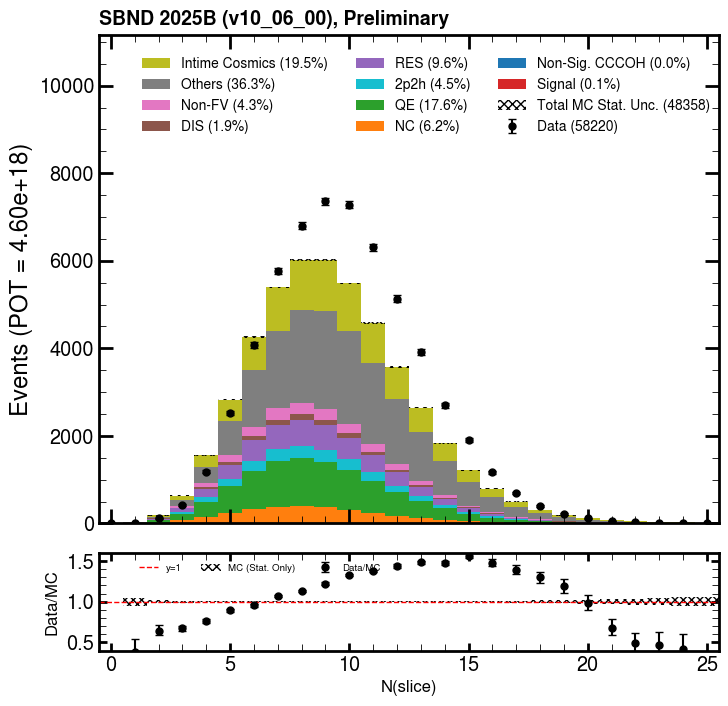

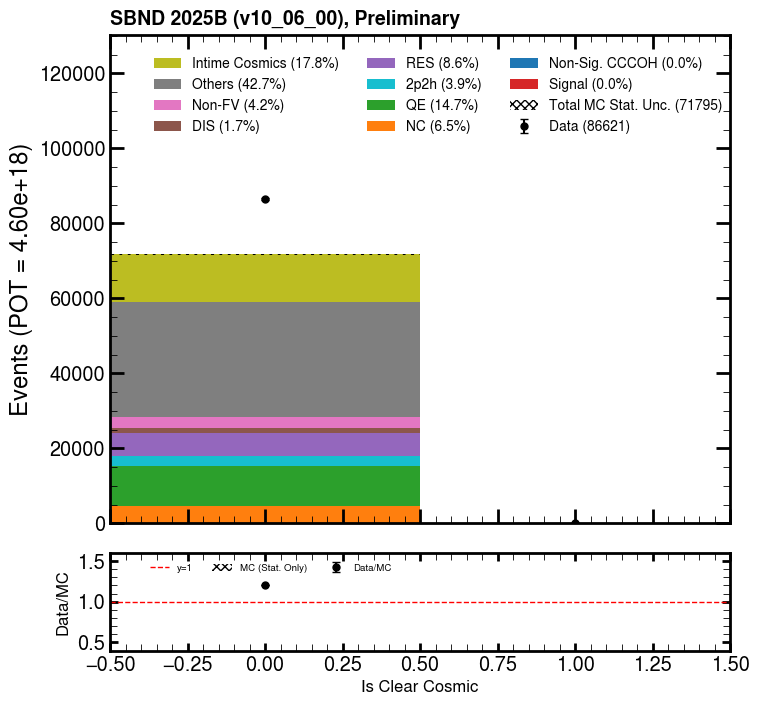

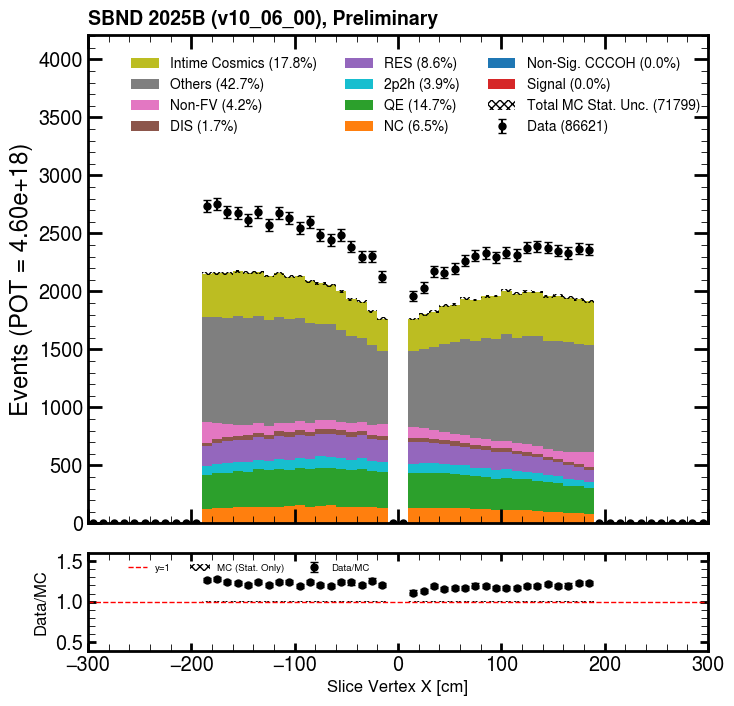

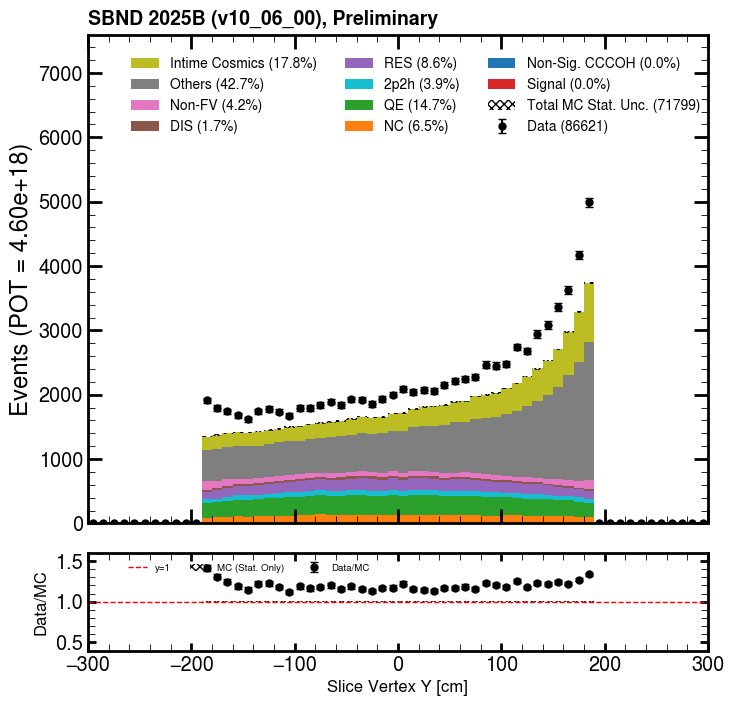

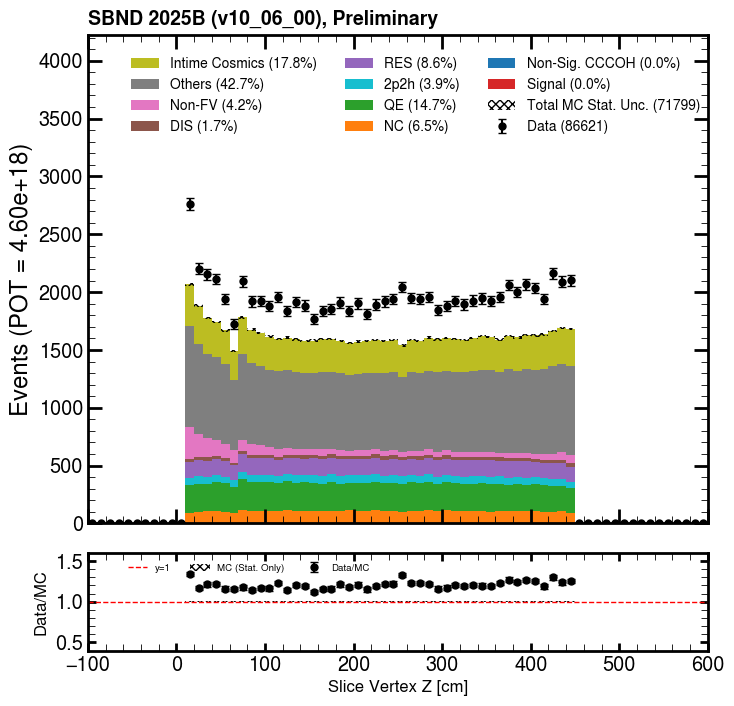

...

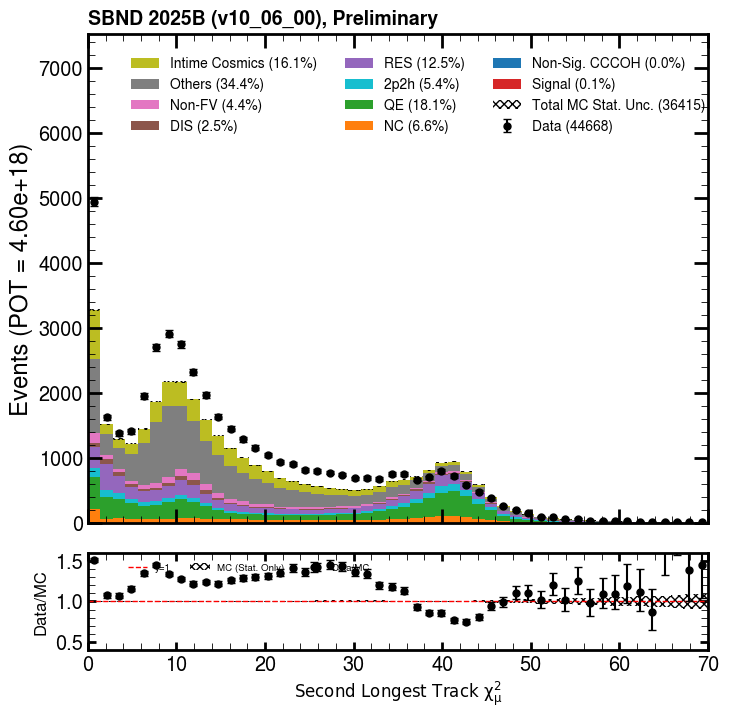

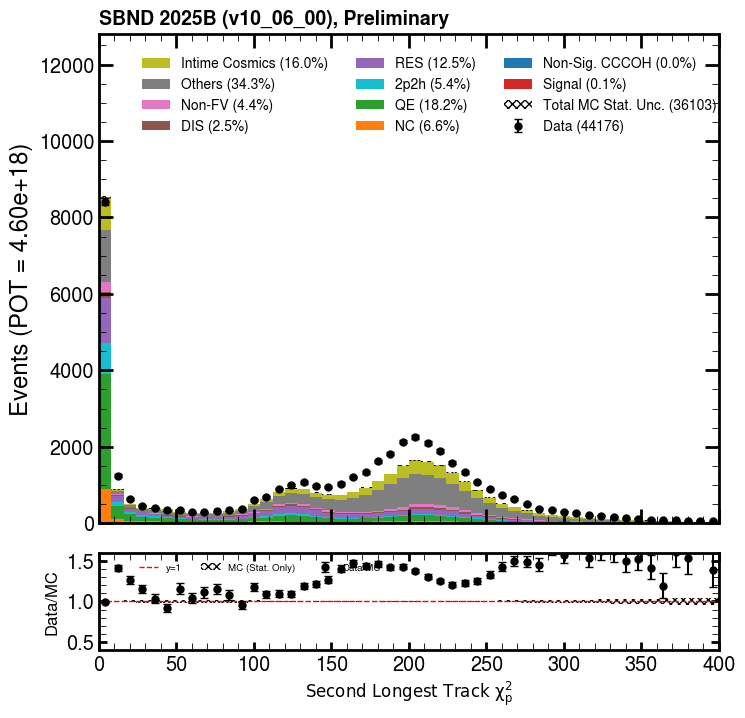

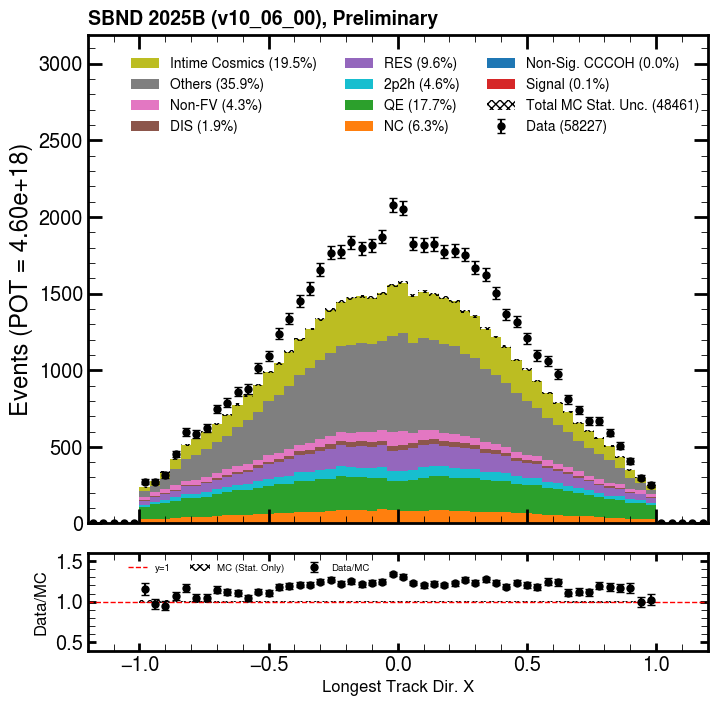

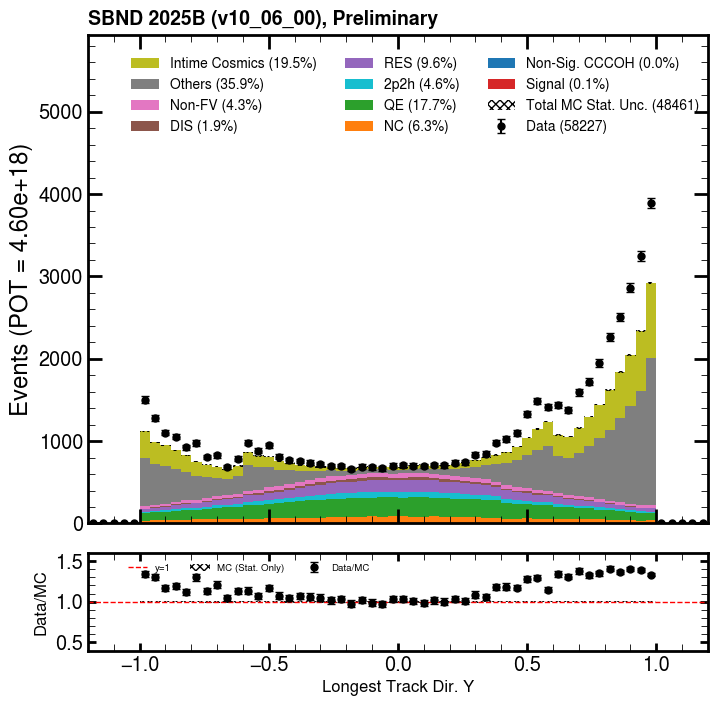

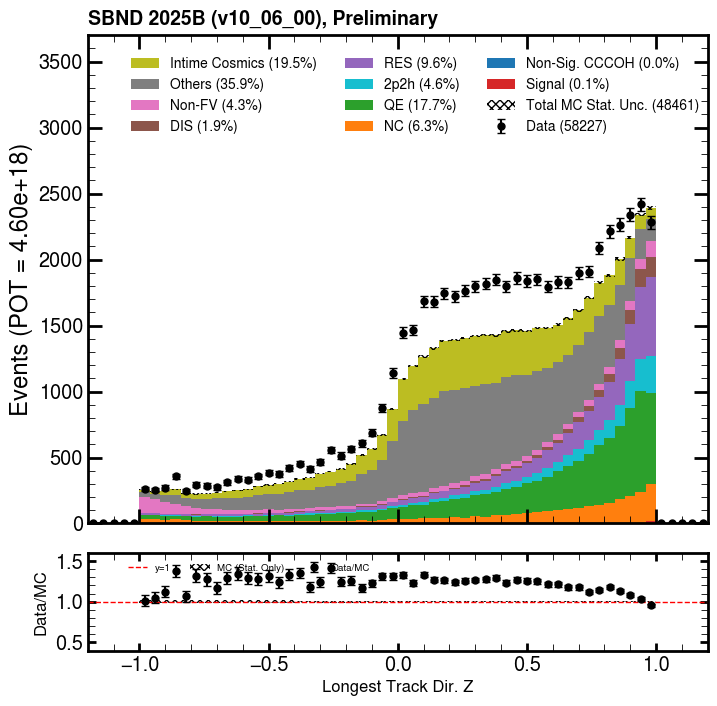

/tmp/ipykernel_3984300/631541511.py:191: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  ax_main.set_ylim(0.0, max_y * 1.5)


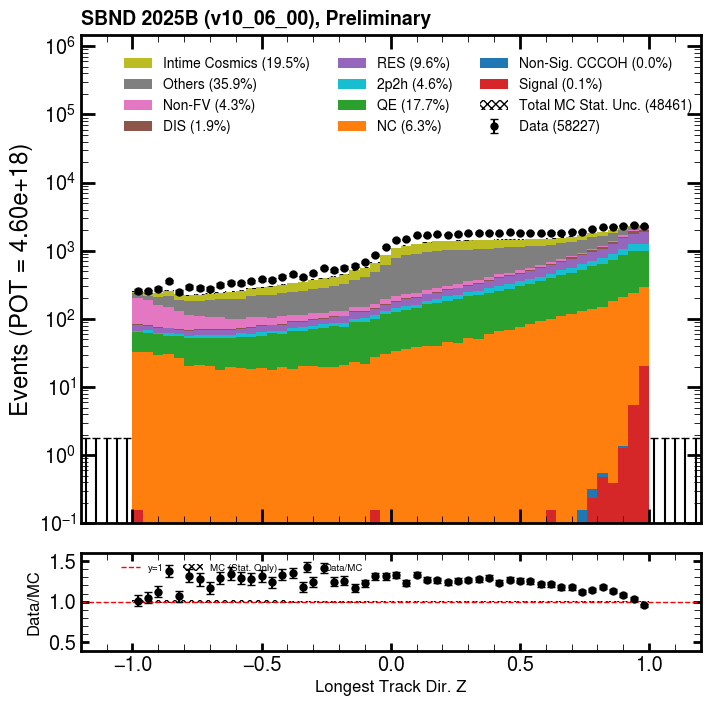

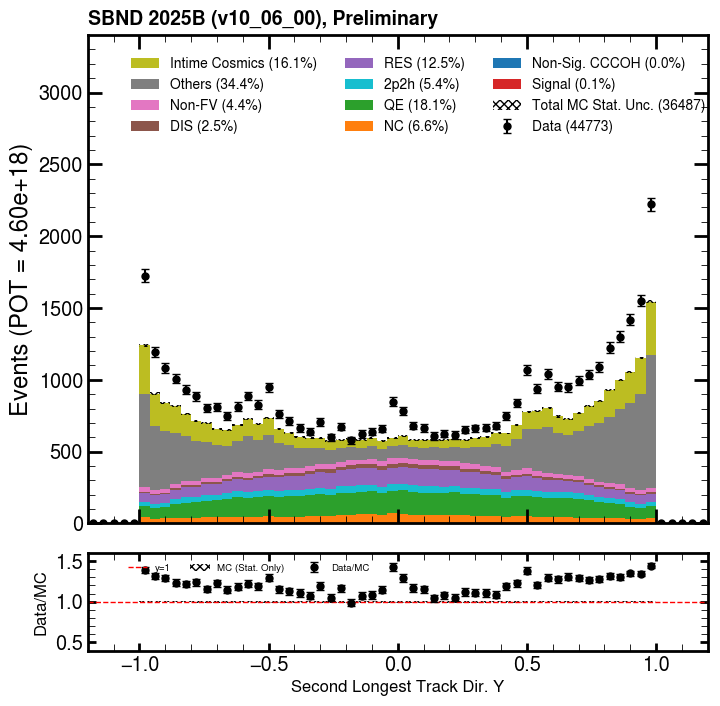

/tmp/ipykernel_3984300/631541511.py:191: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  ax_main.set_ylim(0.0, max_y * 1.5)


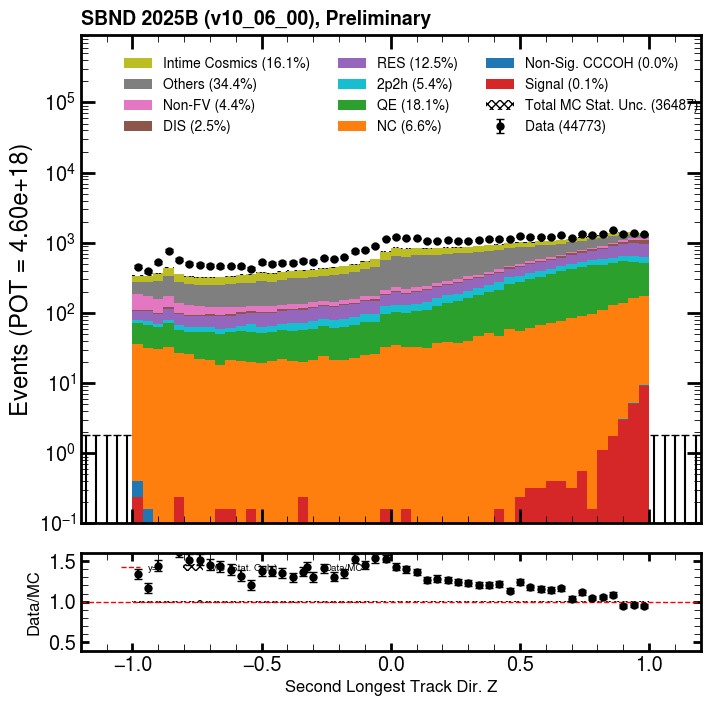

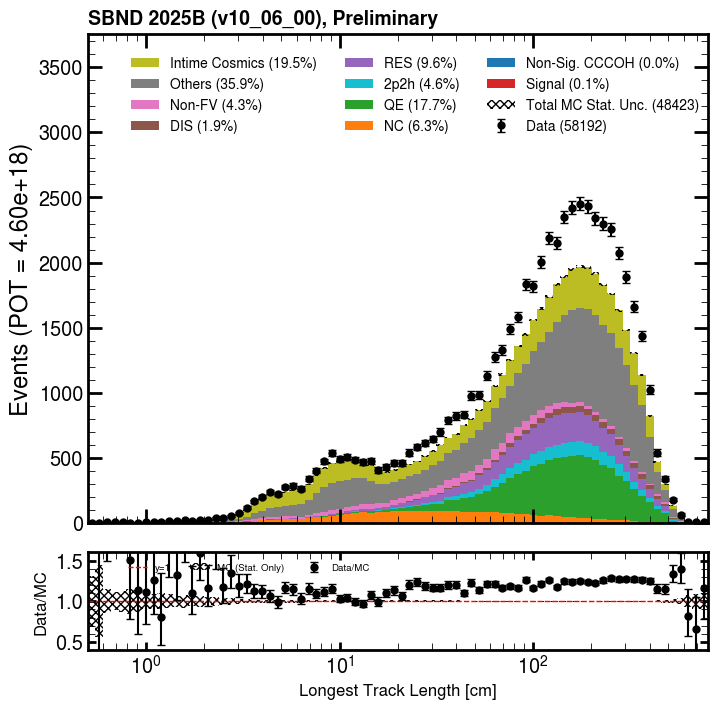

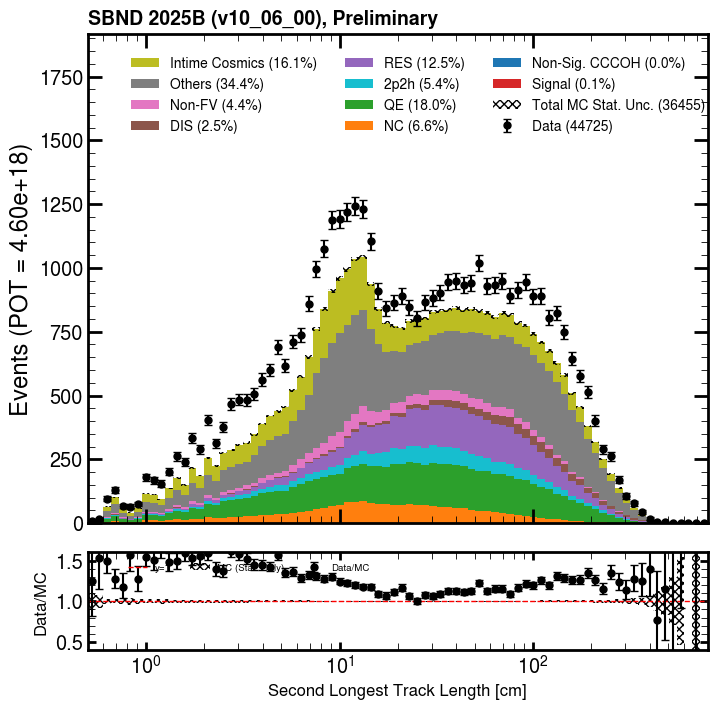

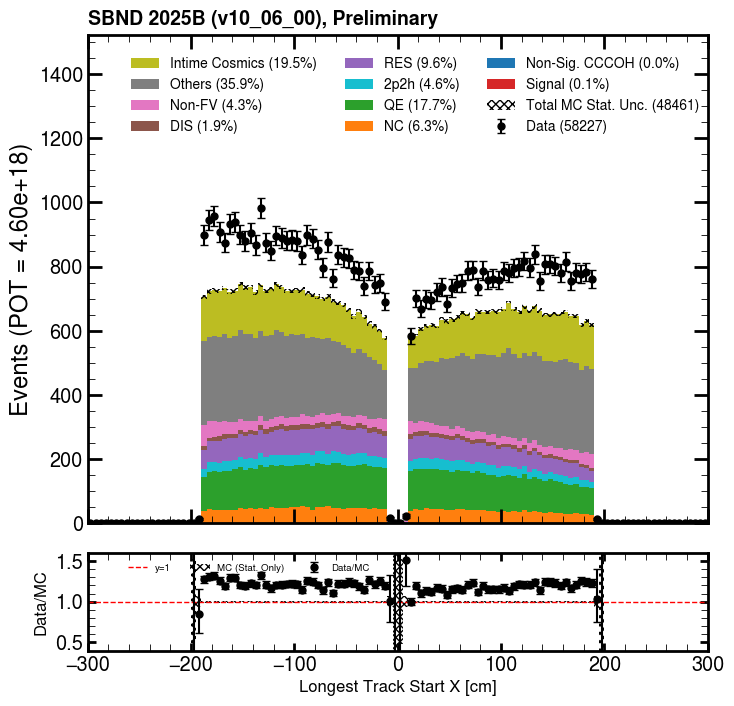

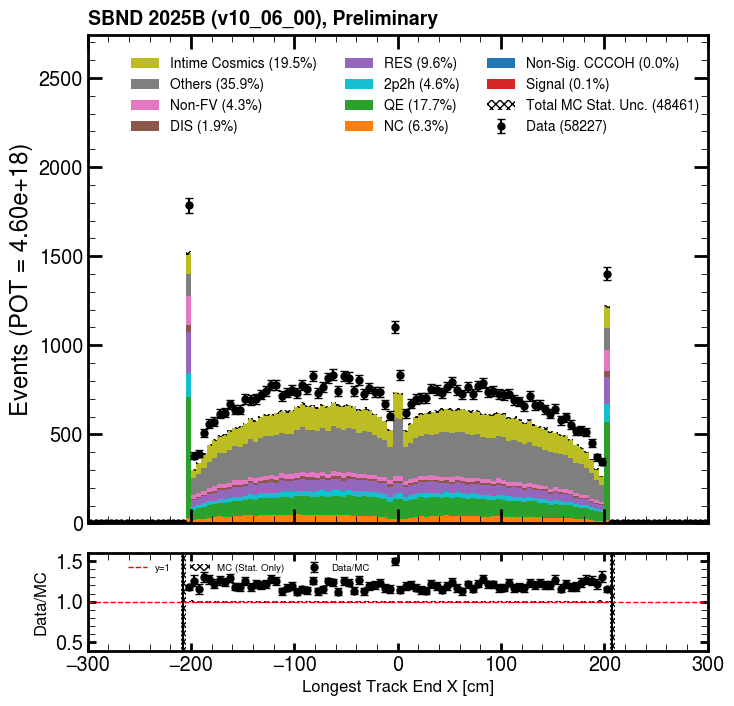

...

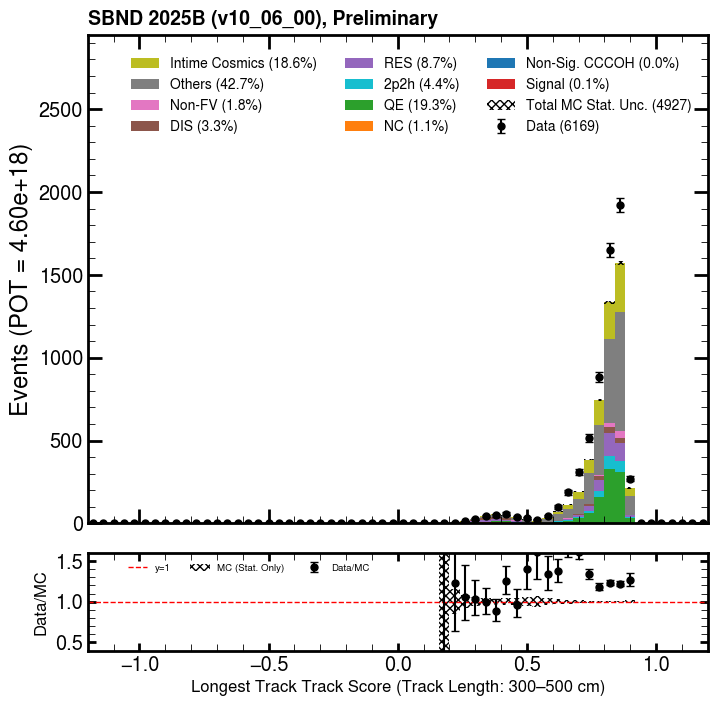

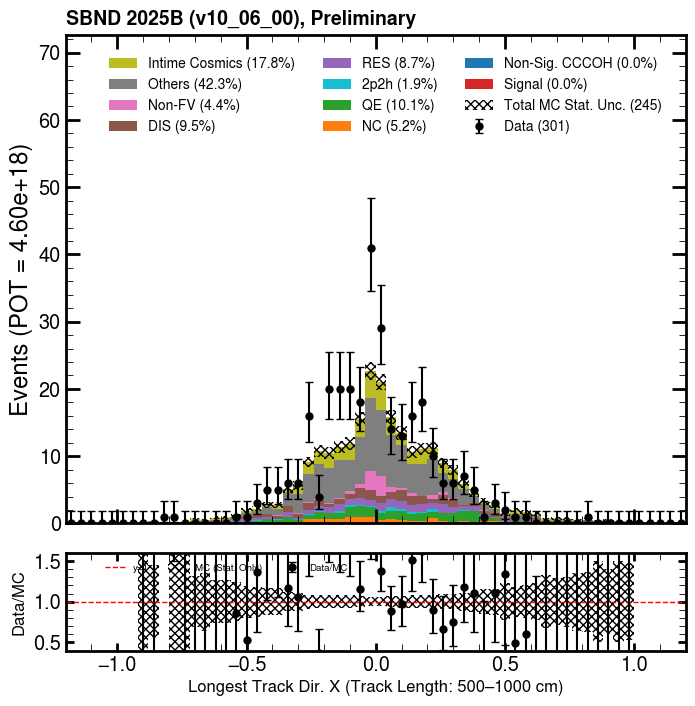

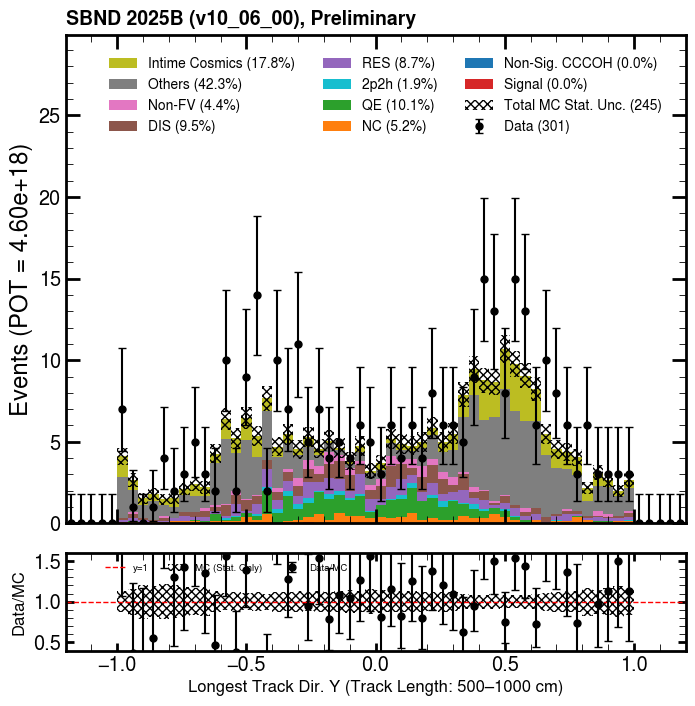

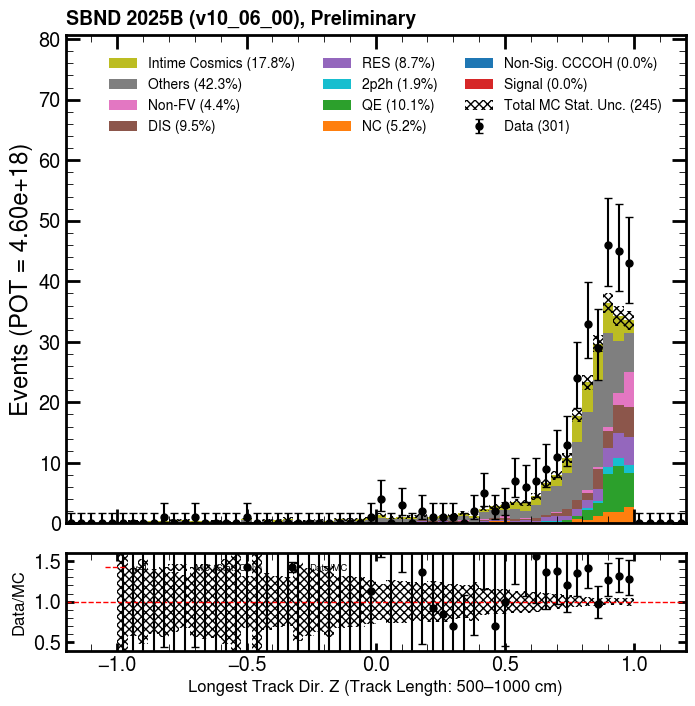

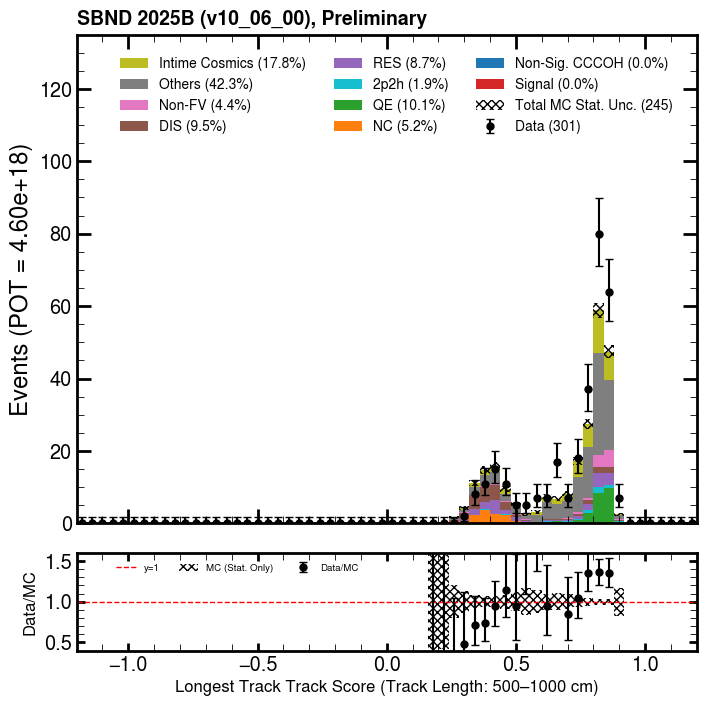

In [19]:
draw_reco_valid_plots(mc_reco_df, mc_intime_reco_df, data_reco_df, "a_vtx_fv_and_not_clear_cosmic")

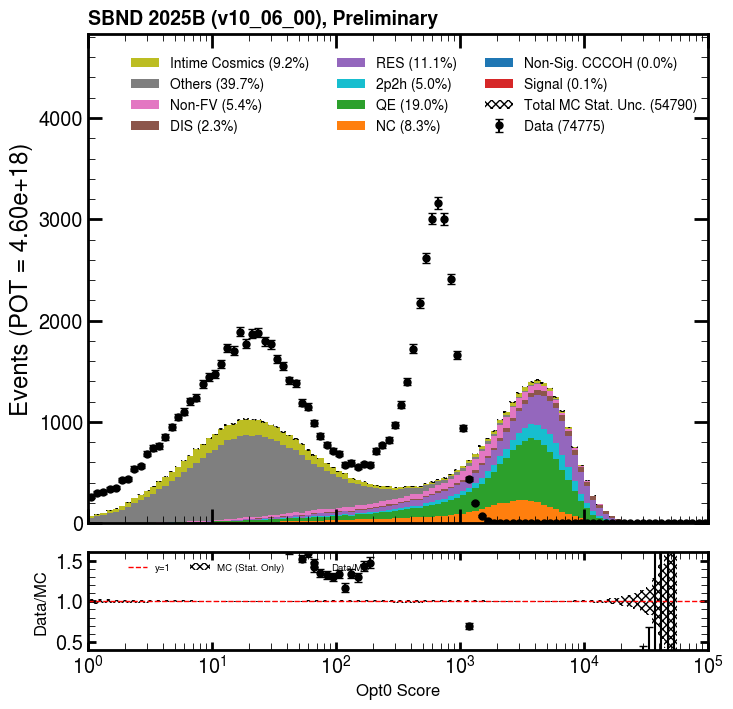

/tmp/ipykernel_3984300/631541511.py:191: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  ax_main.set_ylim(0.0, max_y * 1.5)


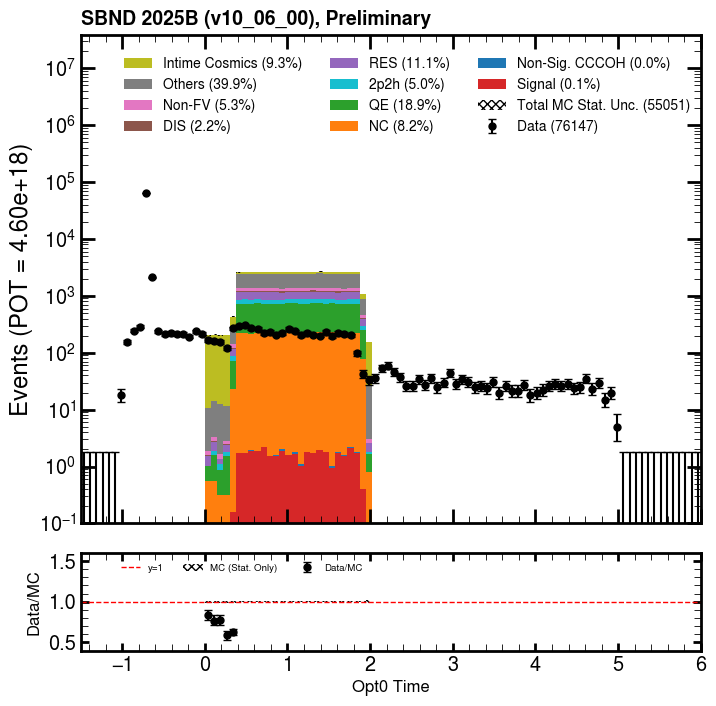

/tmp/ipykernel_3984300/631541511.py:191: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  ax_main.set_ylim(0.0, max_y * 1.5)


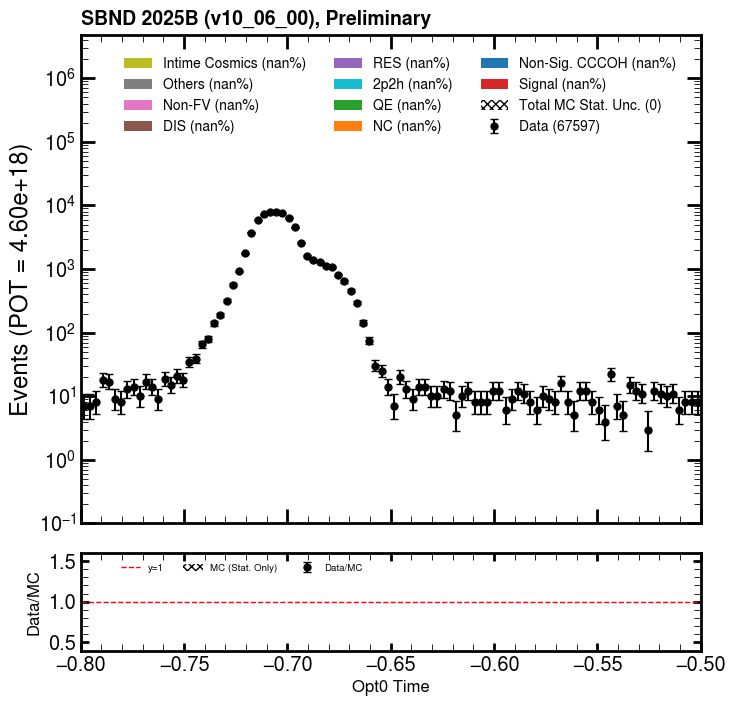

In [20]:
opt0_score_col = ('slc', 'opt0', 'score', '', '', '')
opt0_time_col = ('slc', 'opt0', 'time', '', '', '')

draw_mc_data_shape_comp_per_slc(mc_reco_df, mc_intime_reco_df, data_reco_df, opt0_score_col, "Opt0 Score", "A.U.", 1., 100000., 100, "a_vtx_fv_and_not_clear_cosmic_opt0_score", True, False)
draw_mc_data_shape_comp_per_slc(mc_reco_df, mc_intime_reco_df, data_reco_df, opt0_time_col, "Opt0 Time", "A.U.", -1.5, 6., 100, "a_vtx_fv_and_not_clear_cosmic_opt0_time", False, True)
draw_mc_data_shape_comp_per_slc(mc_reco_df, mc_intime_reco_df, data_reco_df, opt0_time_col, "Opt0 Time", "A.U.", -0.8, -0.5, 100, "a_vtx_fv_and_not_clear_cosmic_opt0_time_data_zoom", False, True)



In [21]:
def pass_slc_with_n_pfps(df, n = 2):
    group_levels = ['__ntuple', 'entry', 'rec.slc..index']
    
    # Count how many pfps per slice
    pfp_counts = df.groupby(level=group_levels).size()

    # Get only slices with at least 2 pfps
    valid_slices = pfp_counts[pfp_counts == n].index

    # Apply the mask to original DataFrame
    filtered_df = df.loc[df.index.droplevel('rec.slc.reco.pfp..index').isin(valid_slices)]

    return filtered_df

In [22]:
## 3) n trk with len > 4 cm and vtx dist < 6 cm
mc_reco_df = mc_reco_df[(mc_reco_df.pfp.trk.len > 4.) & (mc_reco_df.pfp.dist_to_vertex < 6.)]
mc_intime_reco_df = mc_intime_reco_df[(mc_intime_reco_df.pfp.trk.len > 4.) & (mc_intime_reco_df.pfp.dist_to_vertex < 6.)]
data_reco_df = data_reco_df[(data_reco_df.pfp.trk.len > 4.) & (data_reco_df.pfp.dist_to_vertex < 6.)]
#draw_reco_valid_plots(mc_reco_df, mc_intime_reco_df, data_reco_df, "b_trk_len_and_distvtx")

In [23]:
## 4) only two pfp trks passing the len > 4 cm and vtx dist < 6cm cut
mc_reco_df = pass_slc_with_n_pfps(mc_reco_df)
mc_intime_reco_df = pass_slc_with_n_pfps(mc_intime_reco_df)
data_reco_df = pass_slc_with_n_pfps(data_reco_df)

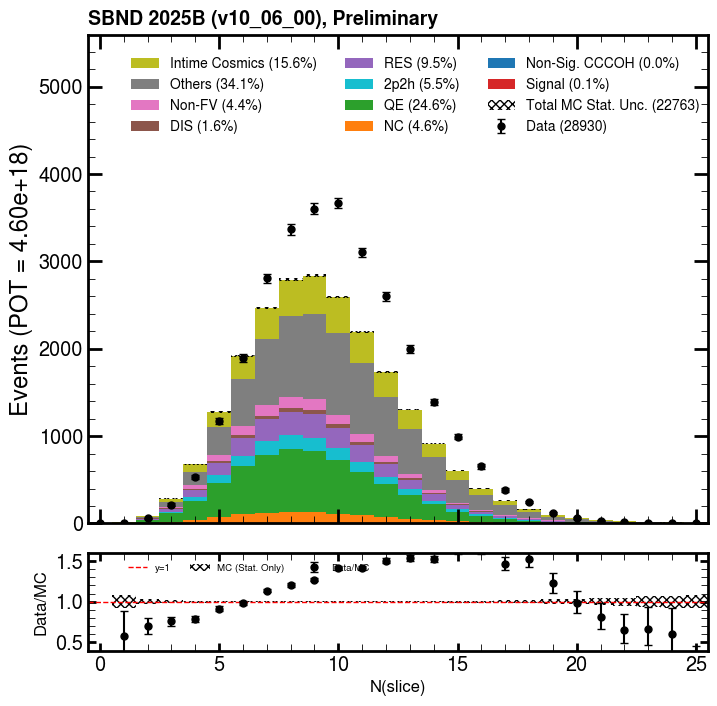

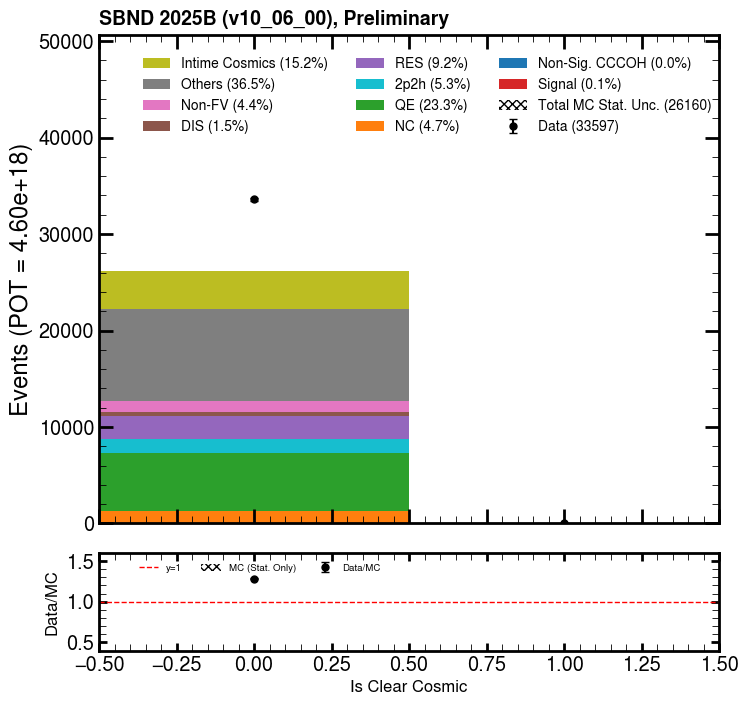

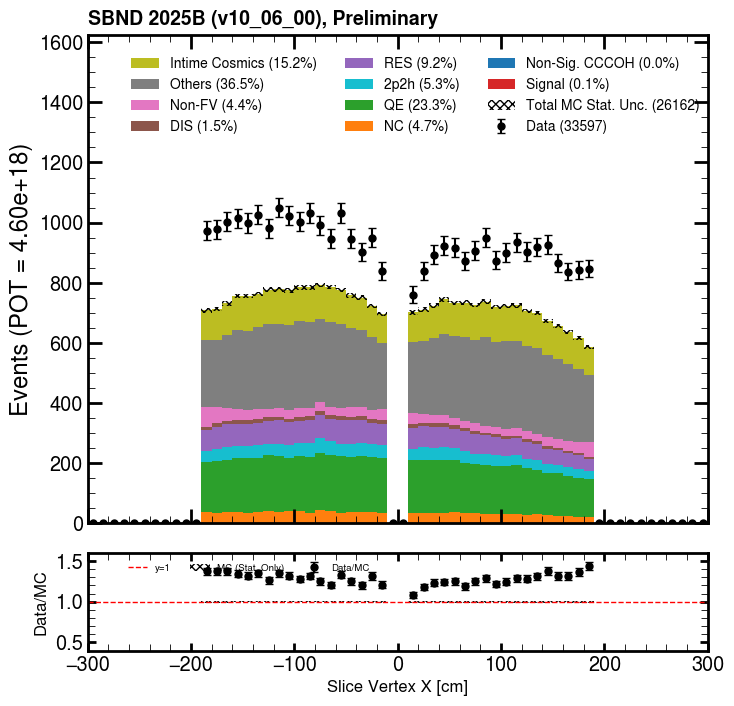

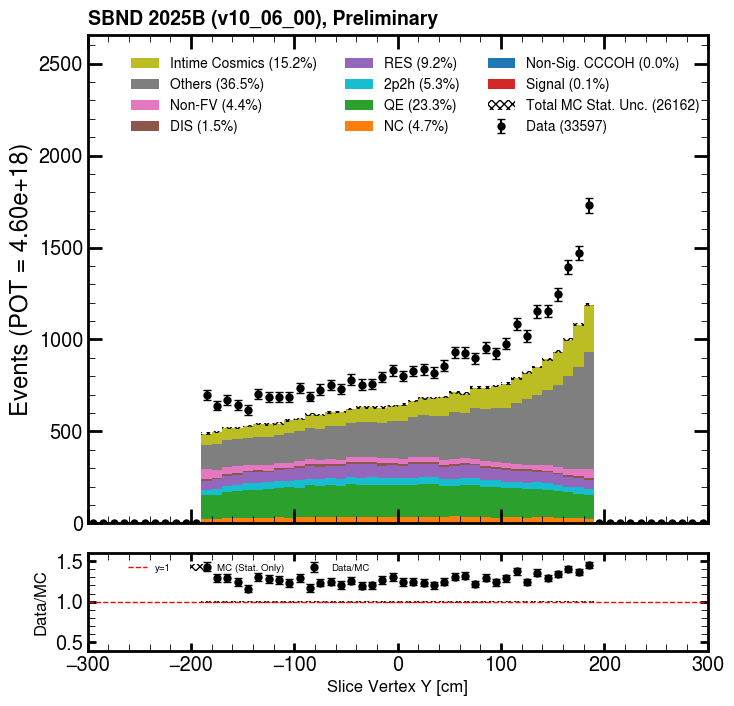

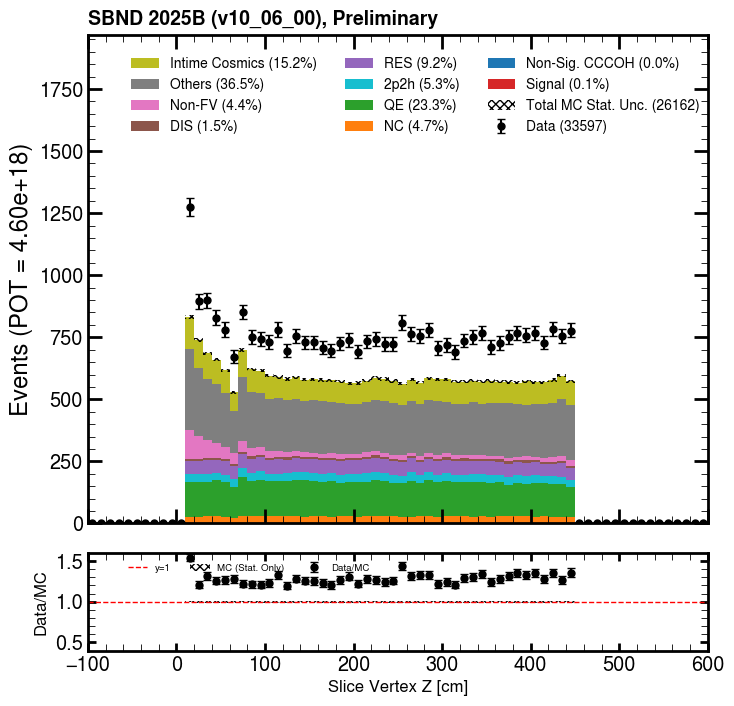

...

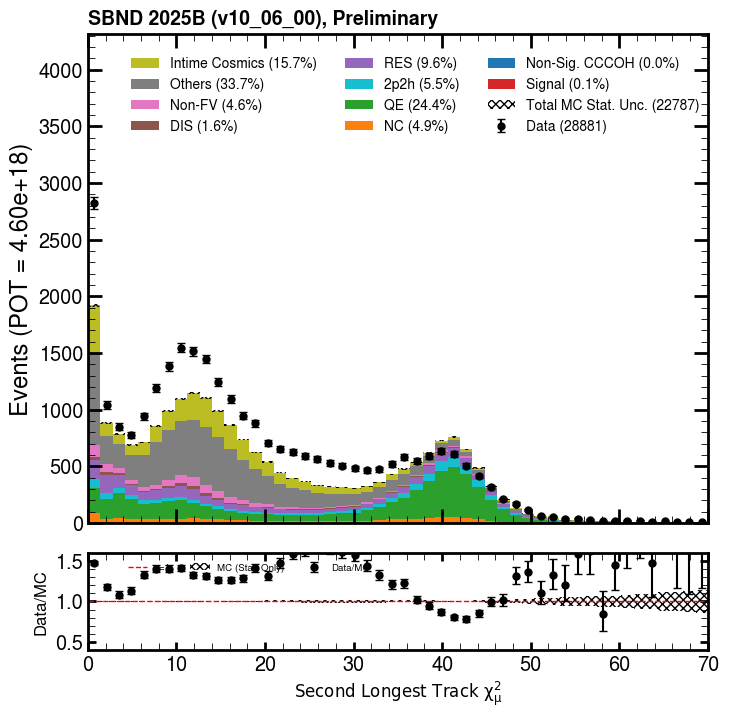

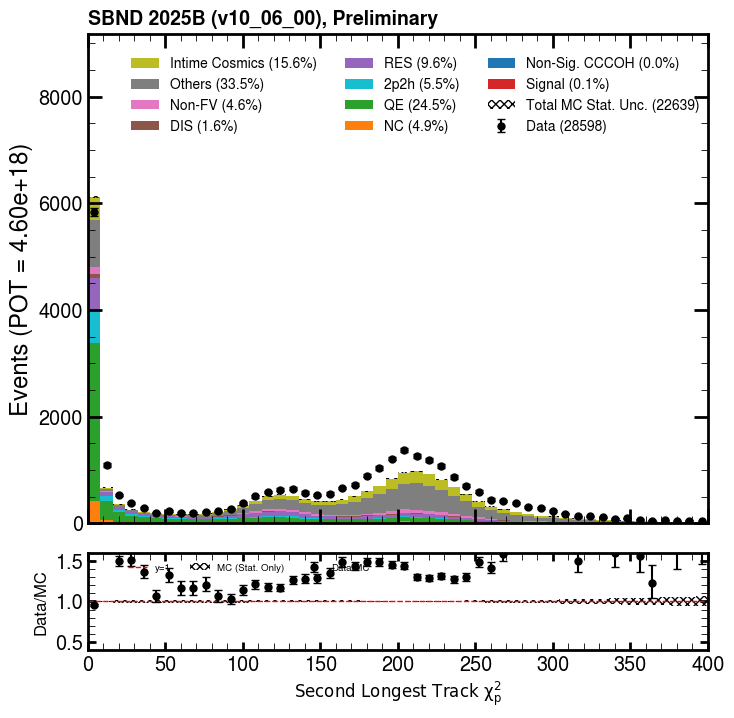

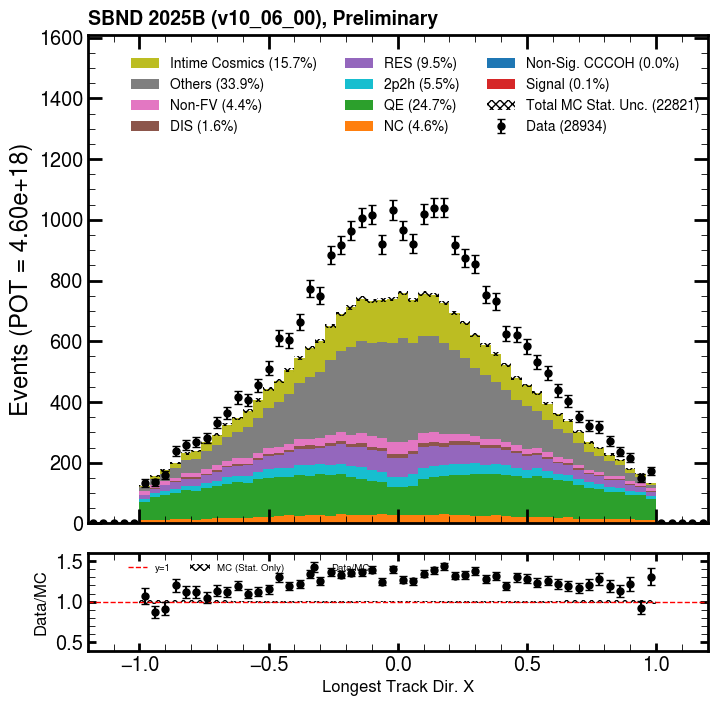

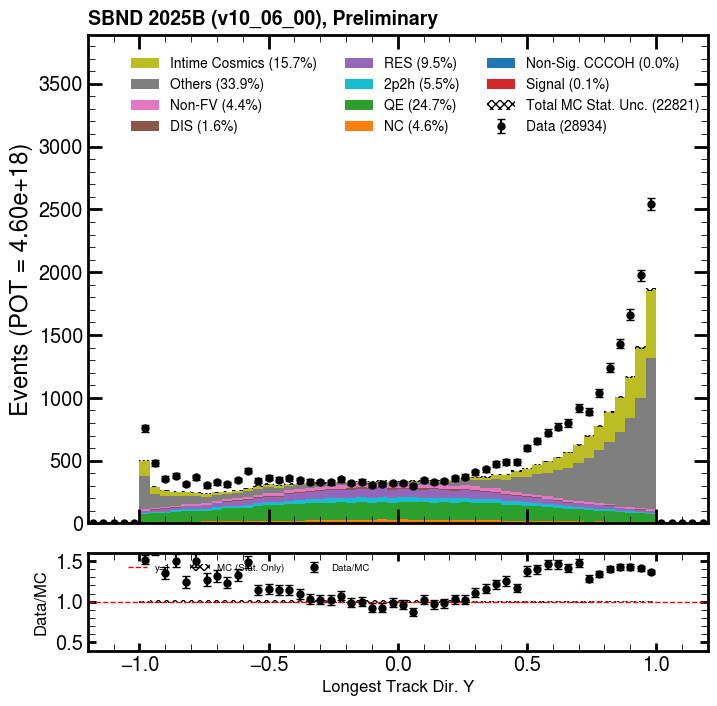

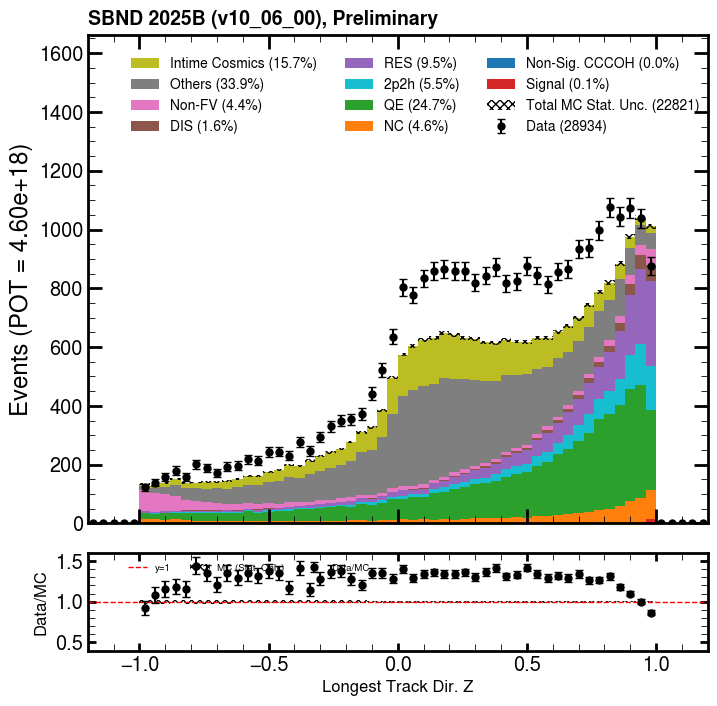

/tmp/ipykernel_3984300/631541511.py:191: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  ax_main.set_ylim(0.0, max_y * 1.5)


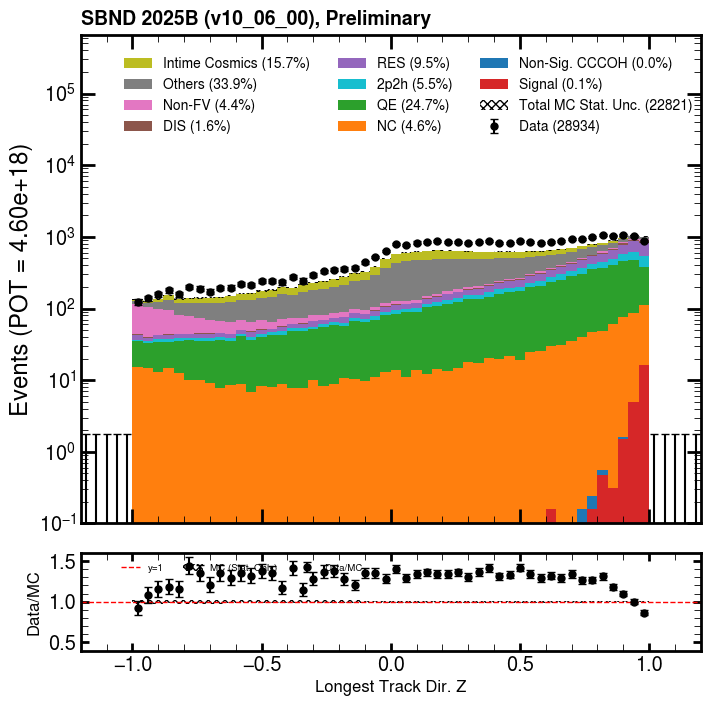

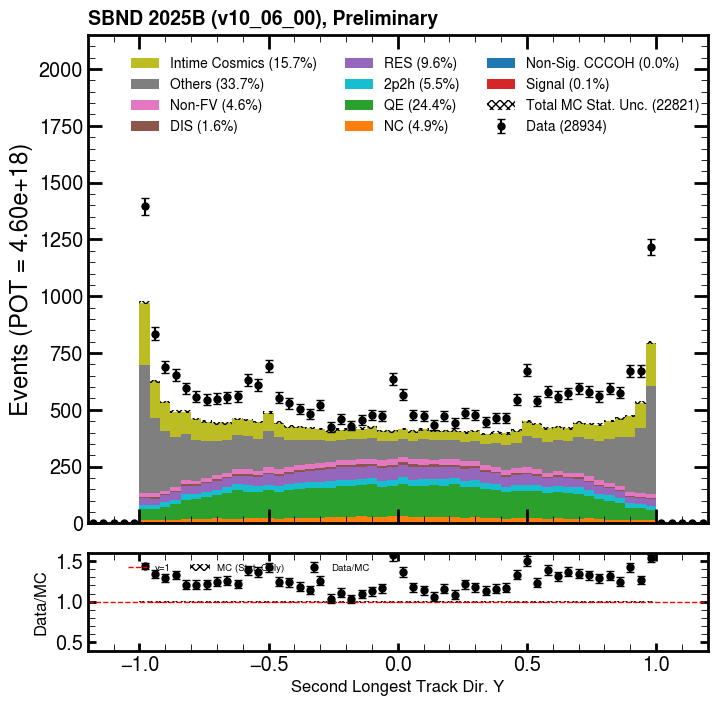

/tmp/ipykernel_3984300/631541511.py:191: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  ax_main.set_ylim(0.0, max_y * 1.5)


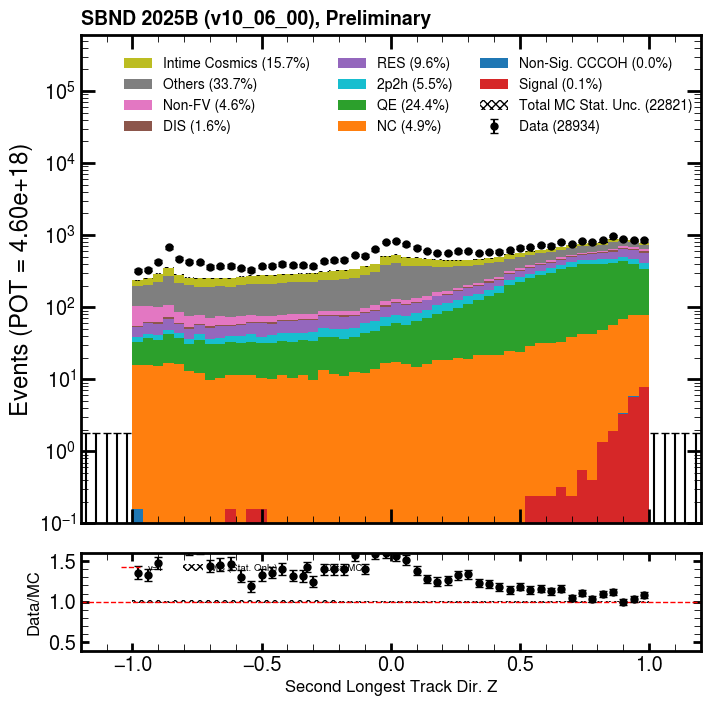

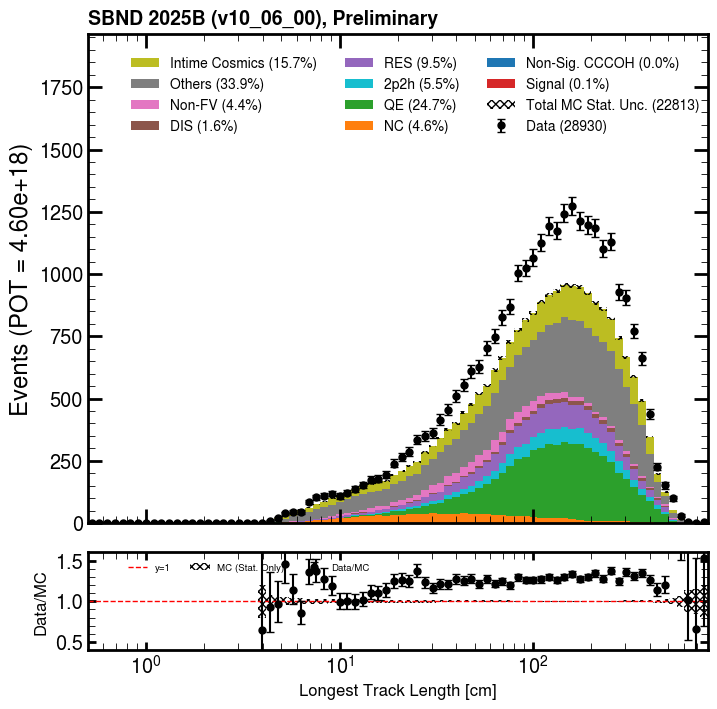

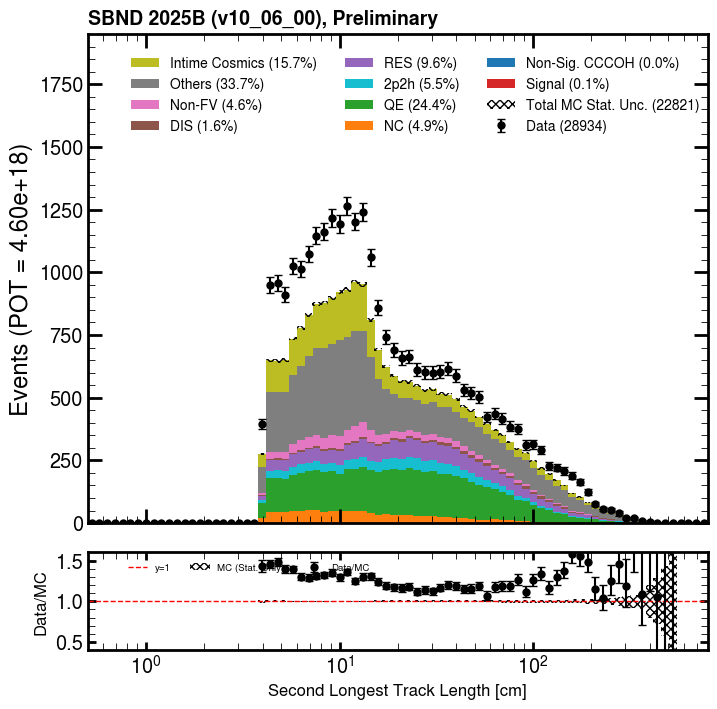

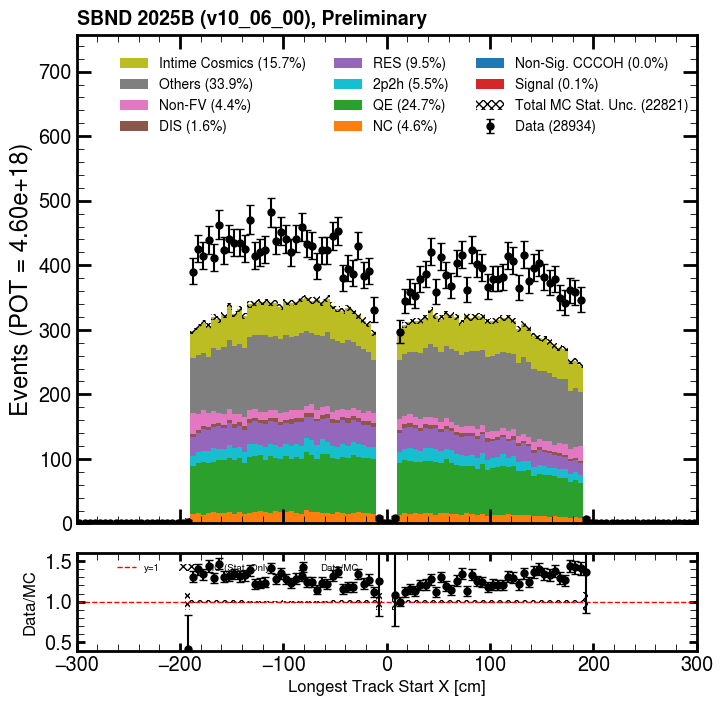

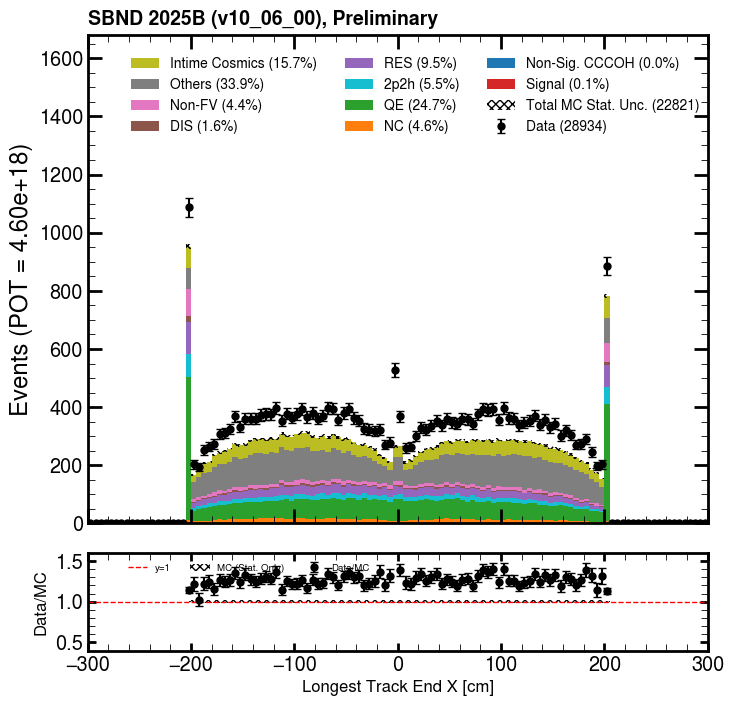

...

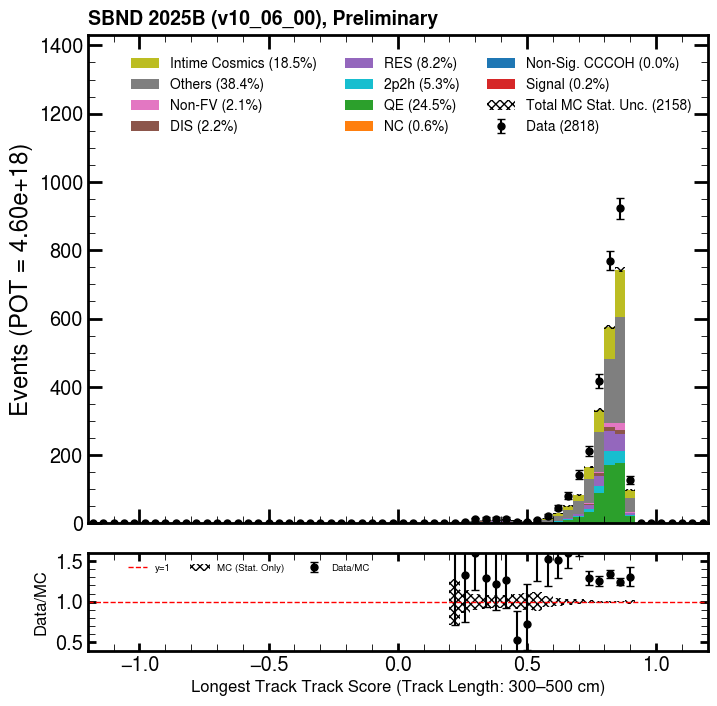

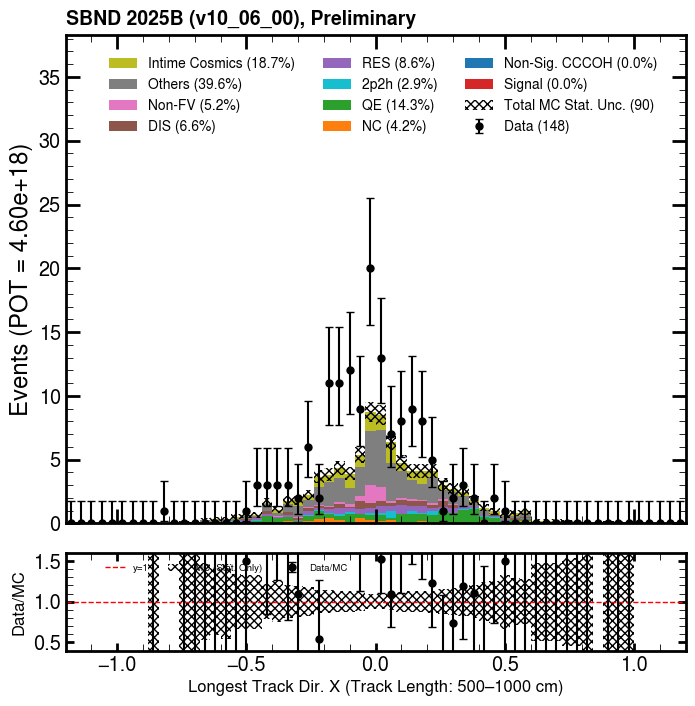

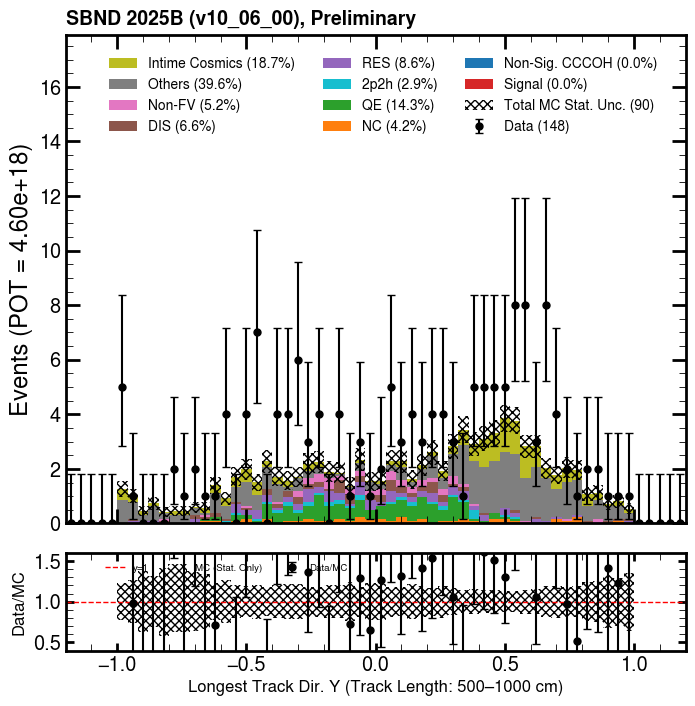

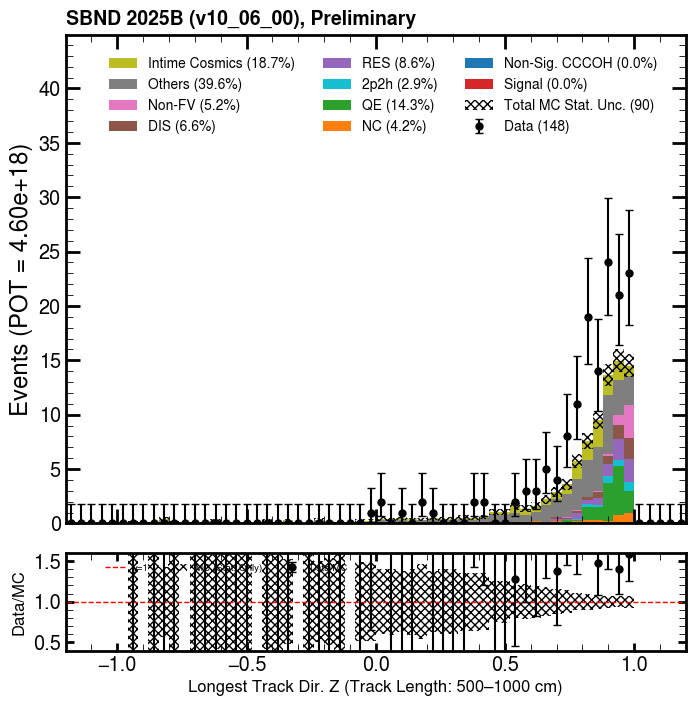

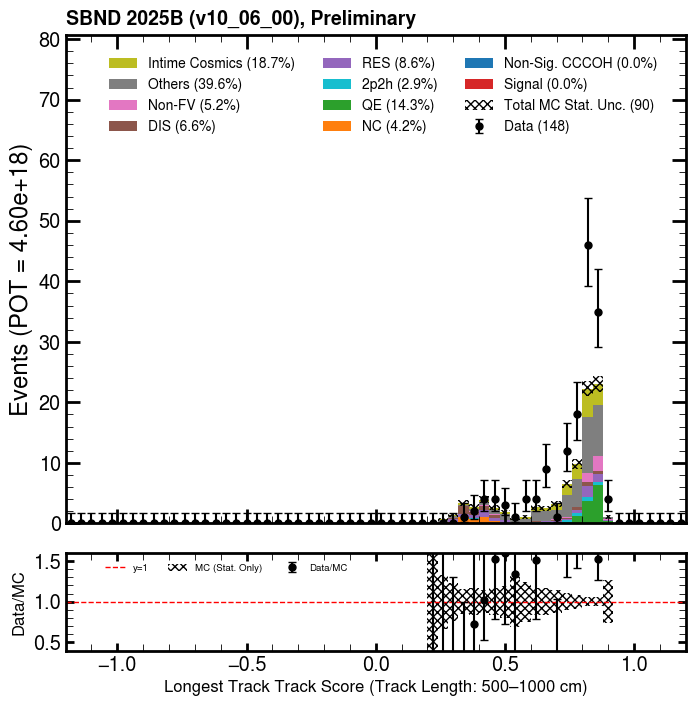

In [24]:
draw_reco_valid_plots(mc_reco_df, mc_intime_reco_df, data_reco_df, "c_n_trk_len_and_distvtx")

In [25]:
## 4) trk score > 0.5
mc_reco_df = mc_reco_df[(mc_reco_df.pfp.trackScore > 0.5)]
mc_intime_reco_df = mc_intime_reco_df[(mc_intime_reco_df.pfp.trackScore > 0.5)]
data_reco_df = data_reco_df[(data_reco_df.pfp.trackScore > 0.5)]
mc_reco_df = pass_slc_with_n_pfps(mc_reco_df)
mc_intime_reco_df = pass_slc_with_n_pfps(mc_intime_reco_df)
data_reco_df = pass_slc_with_n_pfps(data_reco_df)

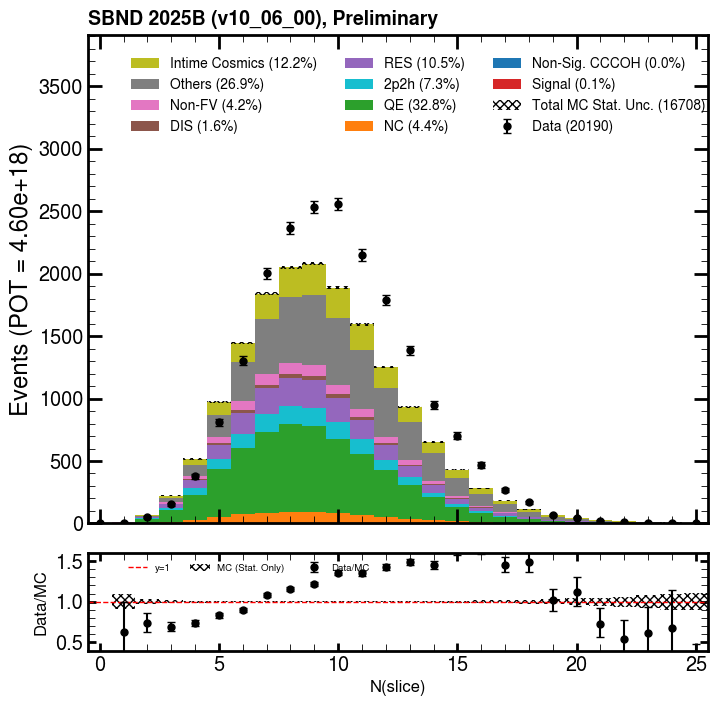

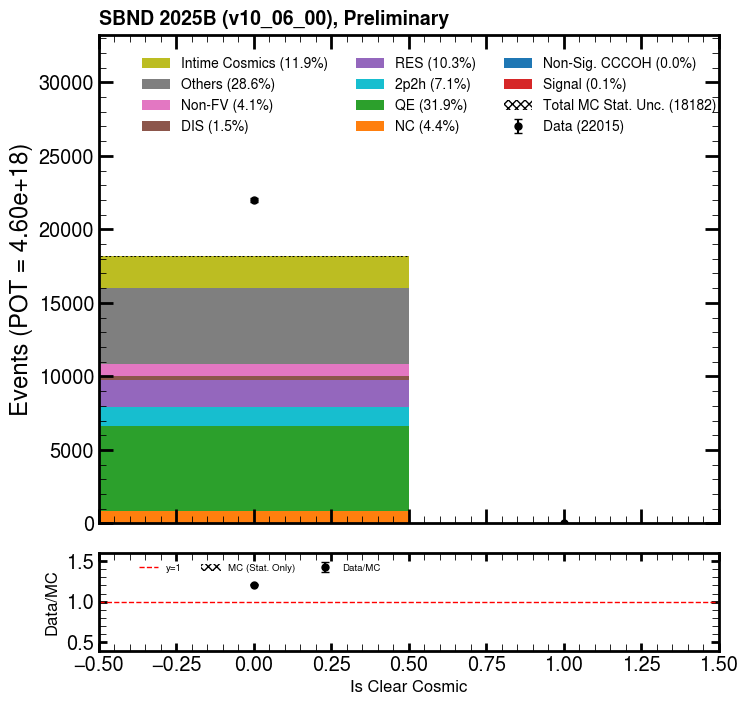

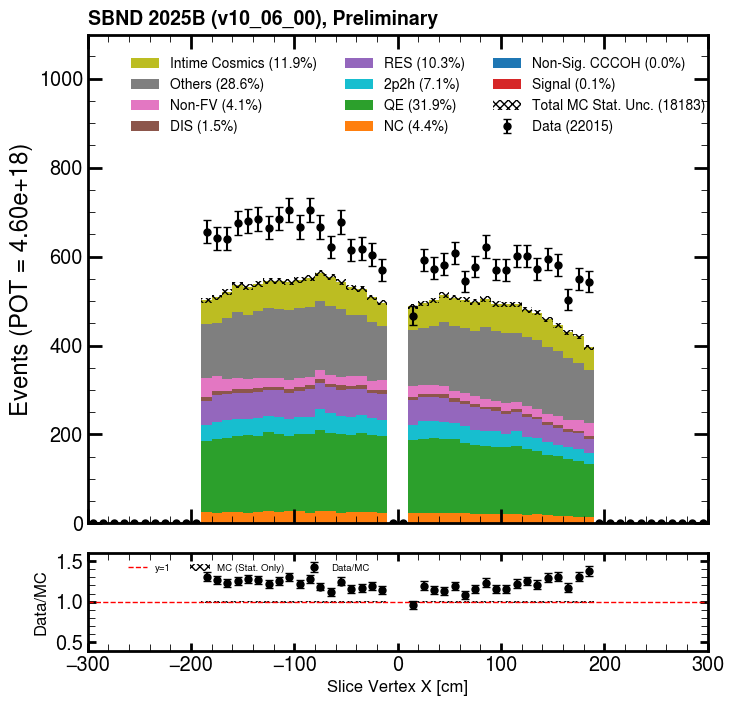

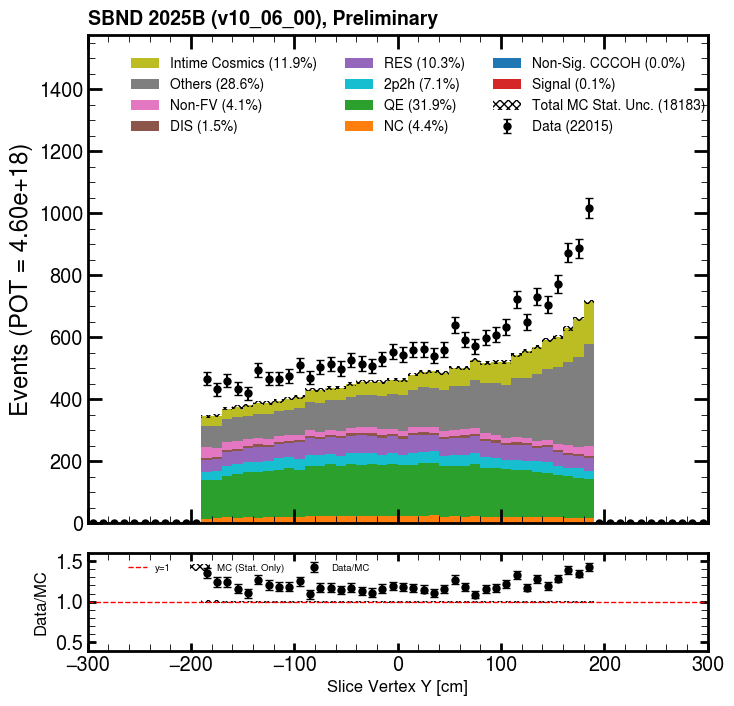

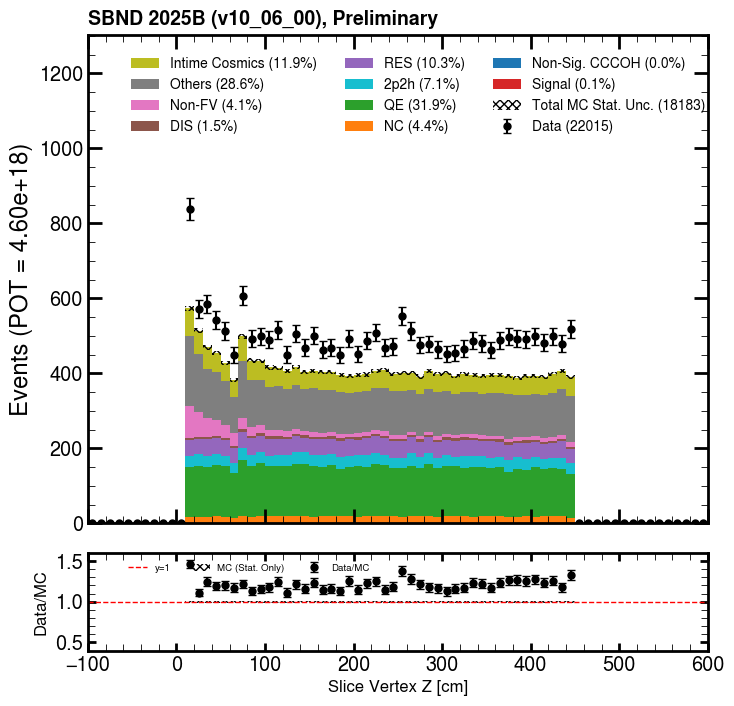

...

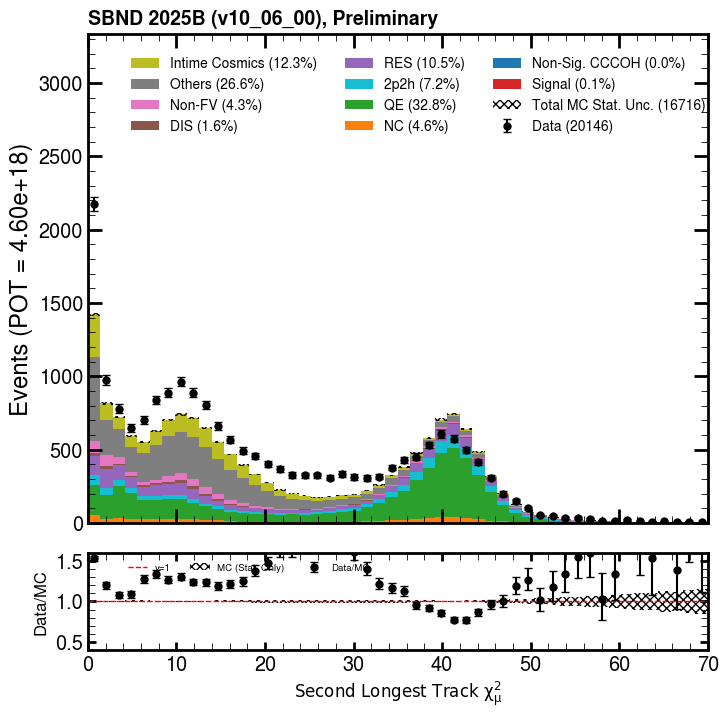

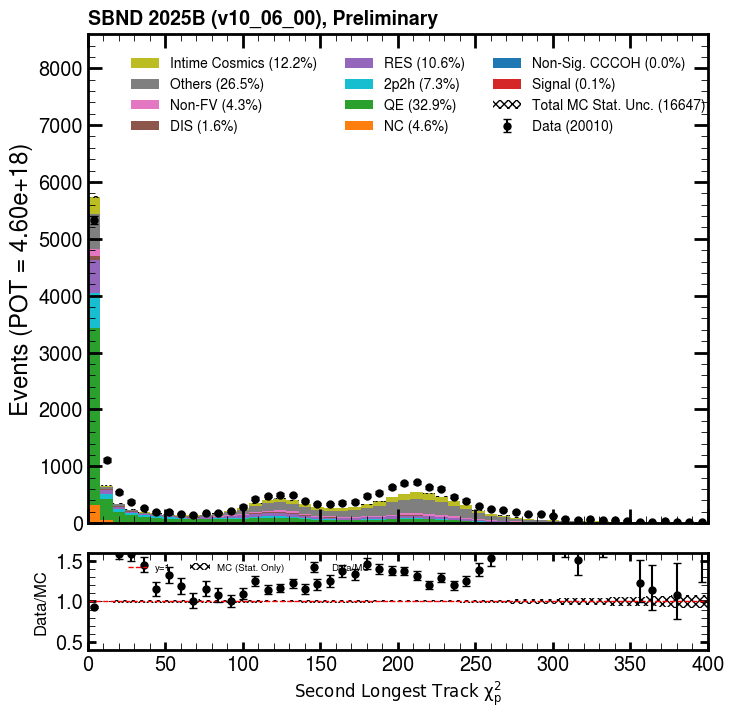

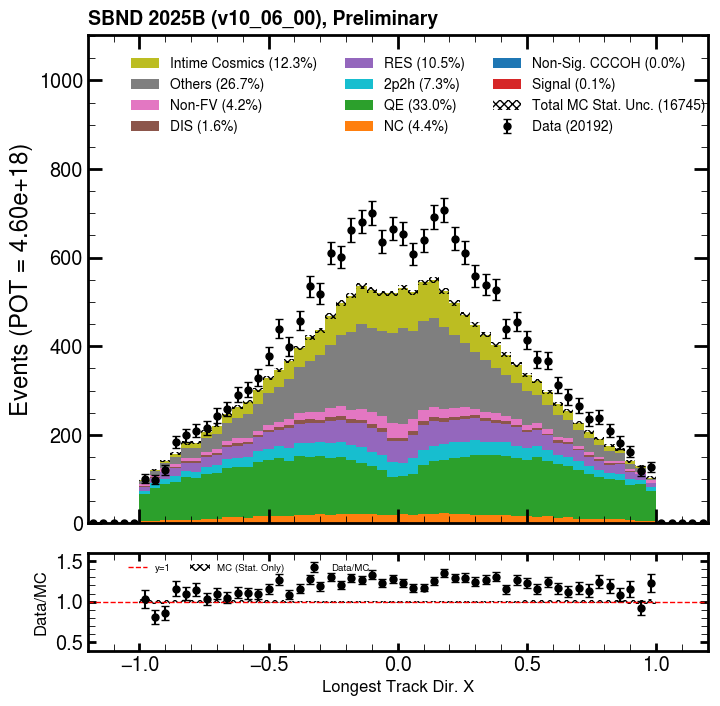

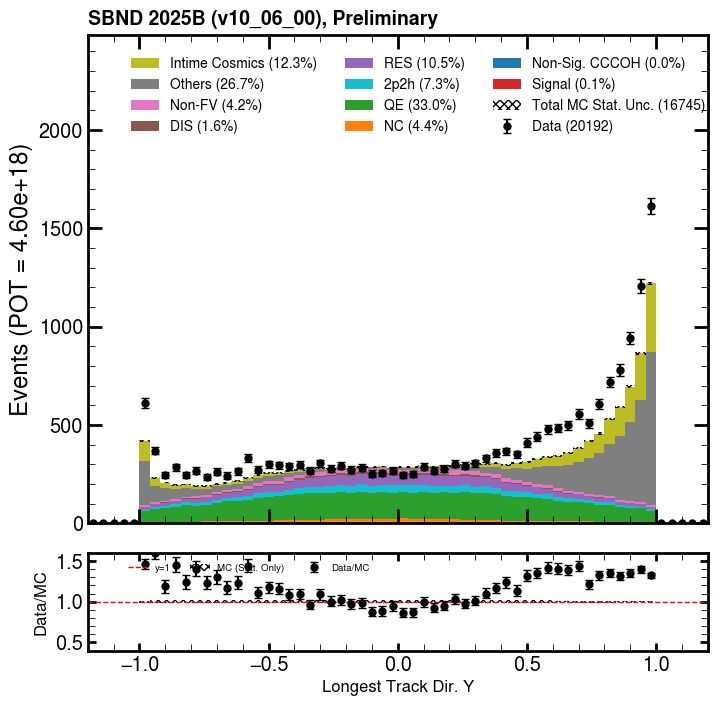

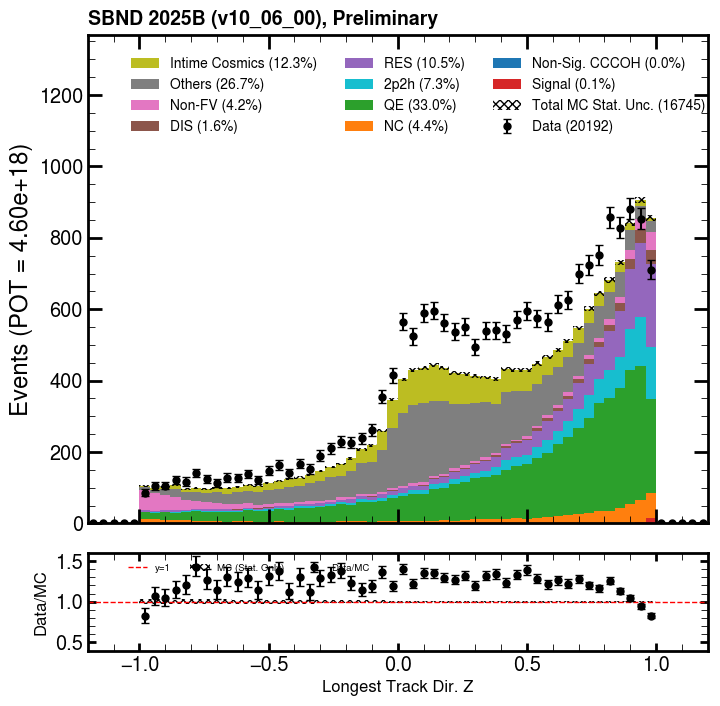

/tmp/ipykernel_3984300/631541511.py:191: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  ax_main.set_ylim(0.0, max_y * 1.5)


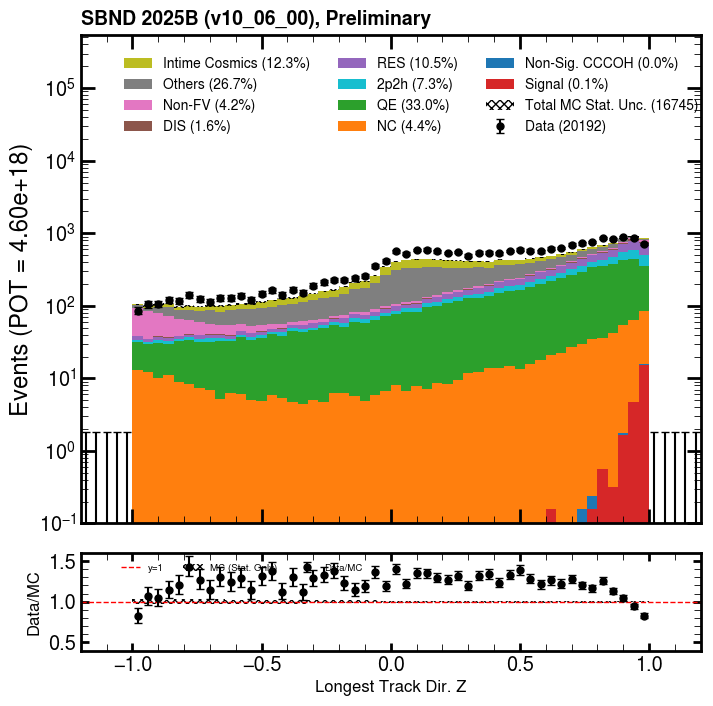

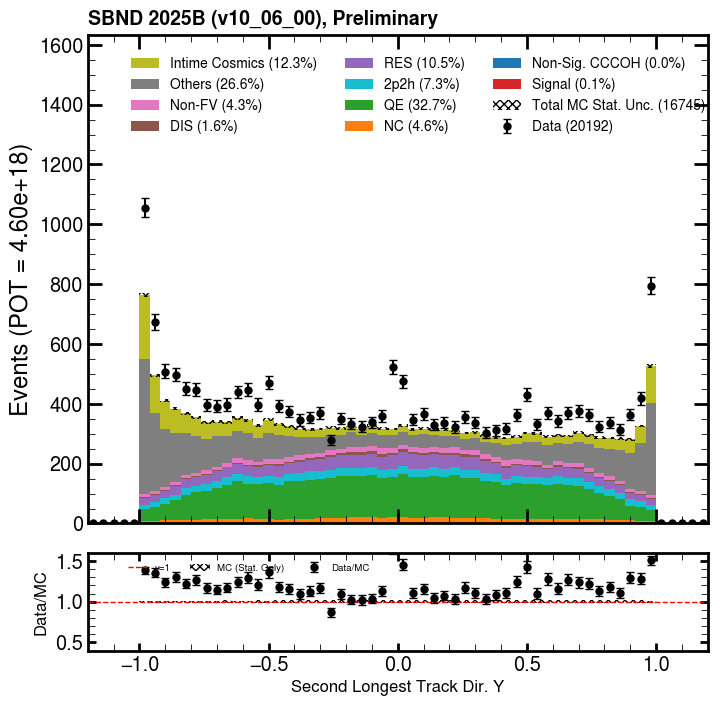

/tmp/ipykernel_3984300/631541511.py:191: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  ax_main.set_ylim(0.0, max_y * 1.5)


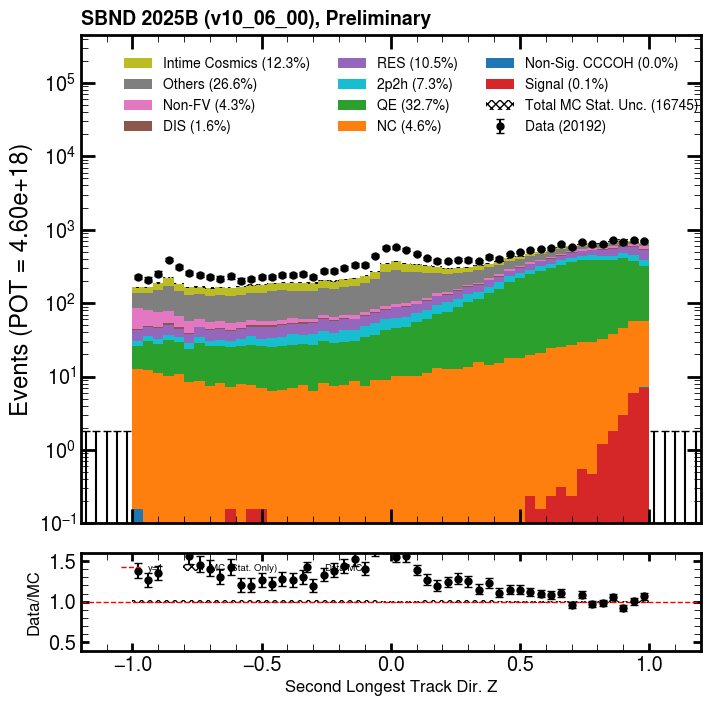

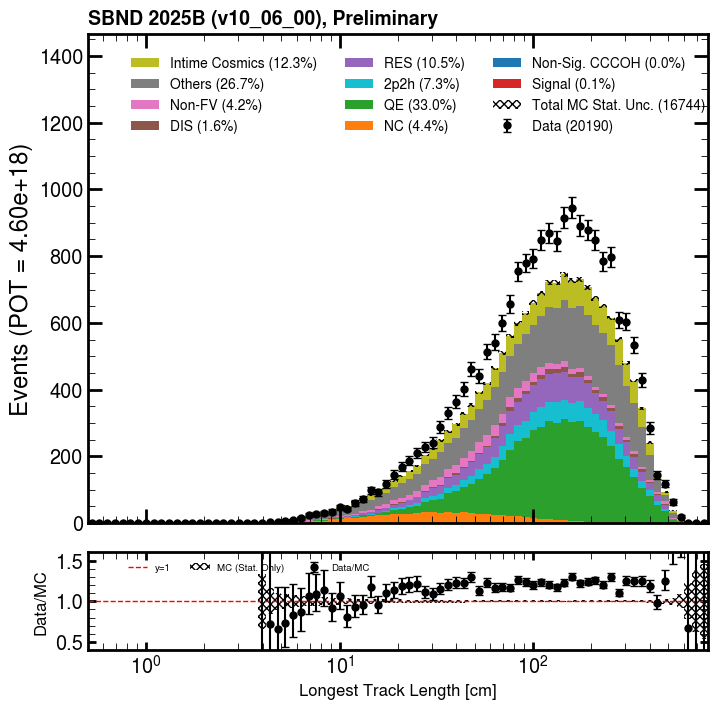

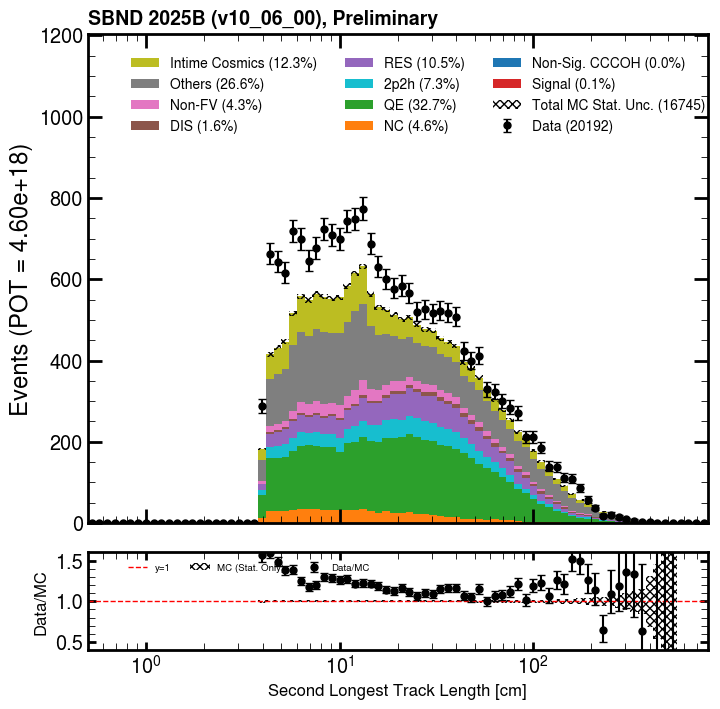

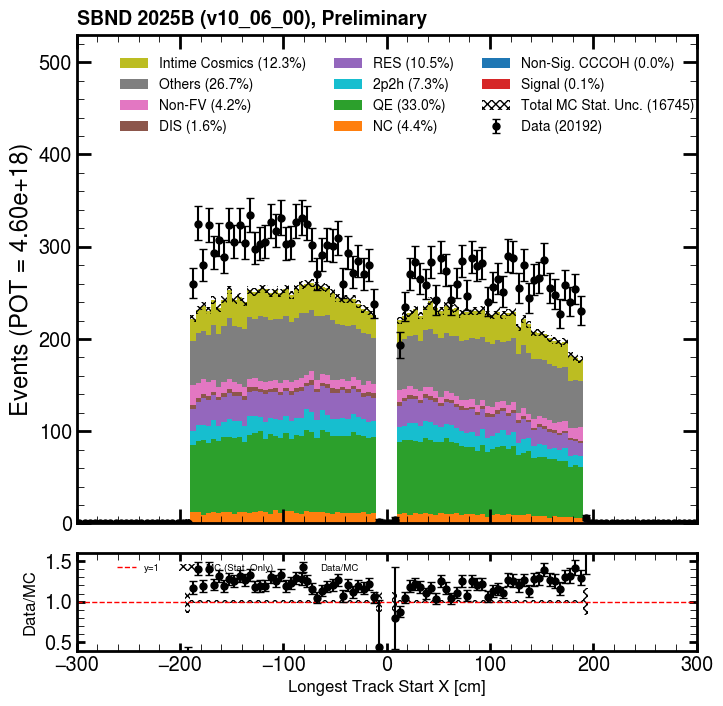

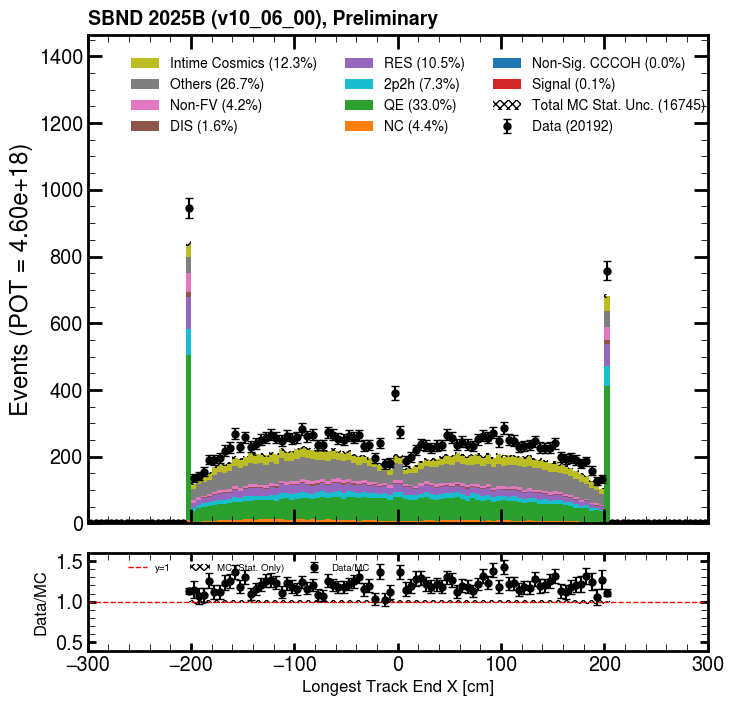

...

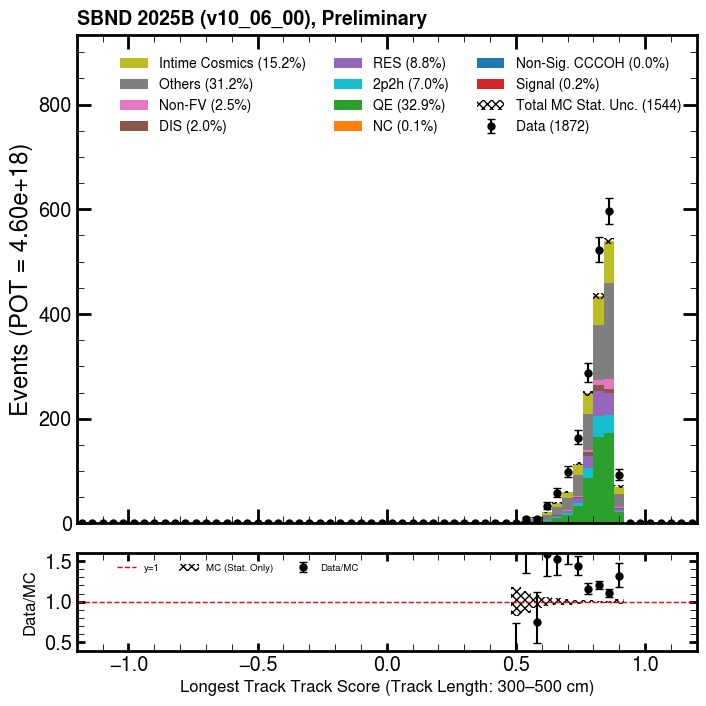

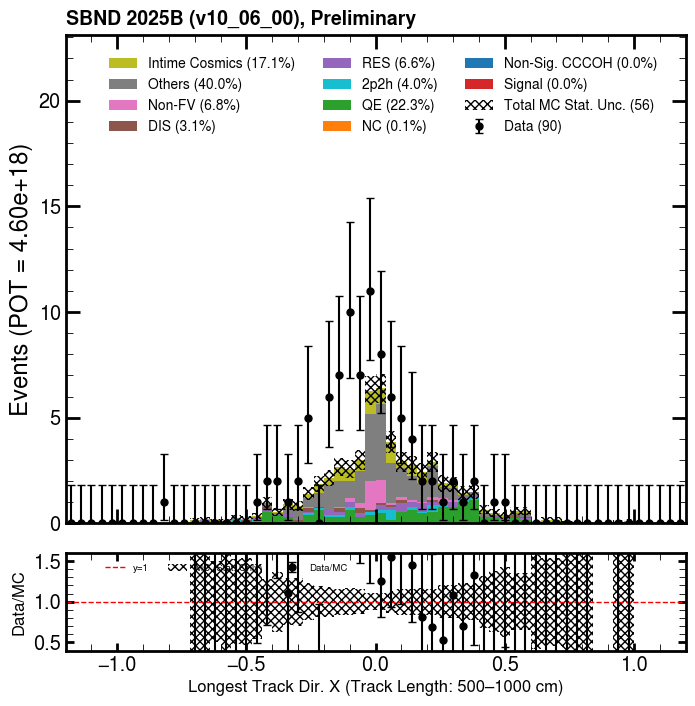

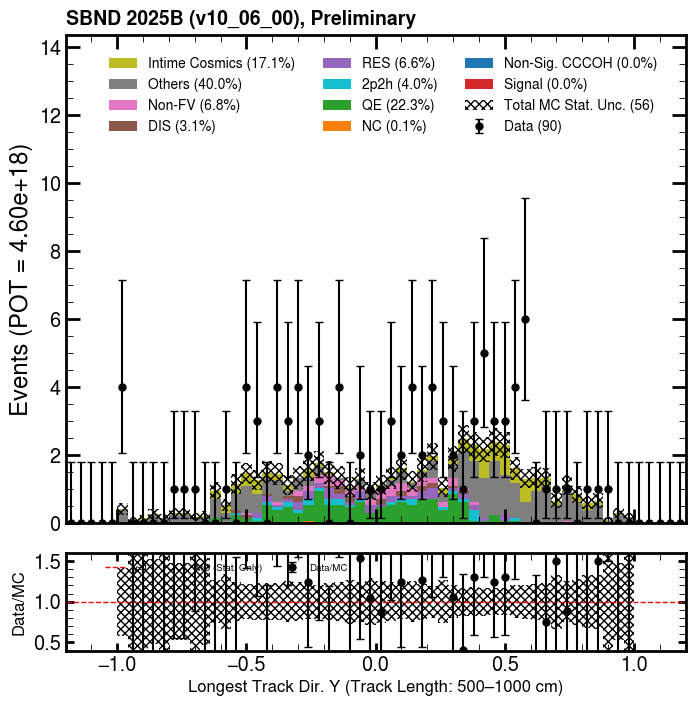

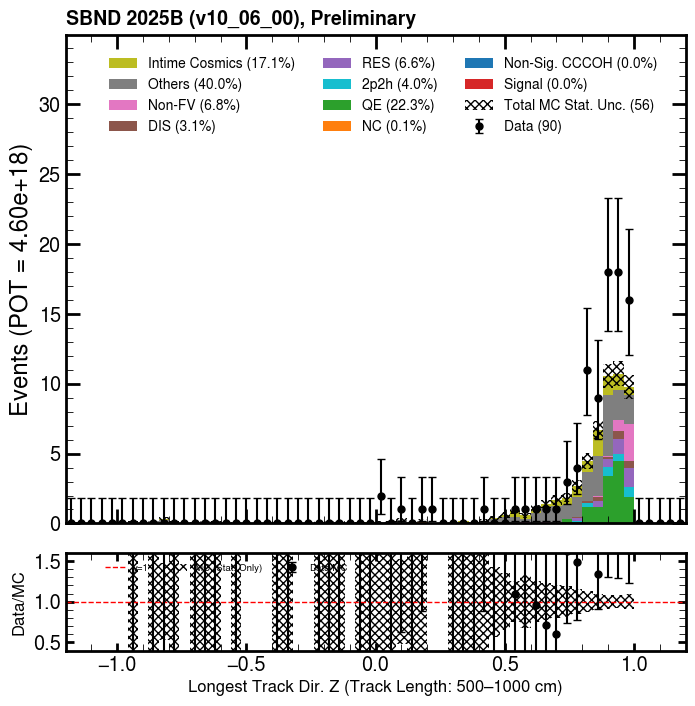

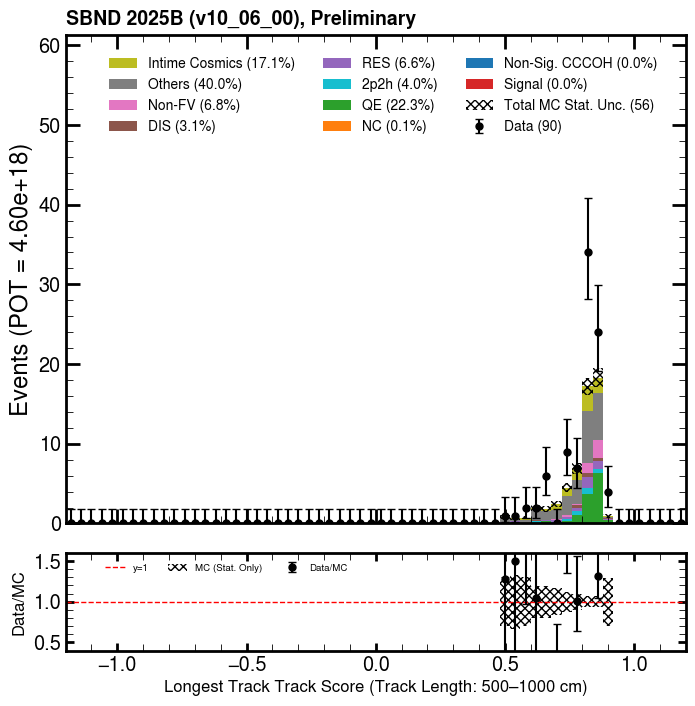

In [26]:
draw_reco_valid_plots(mc_reco_df, mc_intime_reco_df, data_reco_df, "d_n_trk_score_0p5")

In [27]:
## -- passing chi2 pid cuts
mc_reco_df = mc_reco_df[(mc_reco_df.pfp.trk.chi2pid.I2.chi2_muon < 25.) & (mc_reco_df.pfp.trk.chi2pid.I2.chi2_proton > 100.)]
mc_intime_reco_df = mc_intime_reco_df[(mc_intime_reco_df.pfp.trk.chi2pid.I2.chi2_muon < 25.) & (mc_intime_reco_df.pfp.trk.chi2pid.I2.chi2_proton > 100.)]
data_reco_df = data_reco_df[(data_reco_df.pfp.trk.chi2pid.I2.chi2_muon < 25.) & (data_reco_df.pfp.trk.chi2pid.I2.chi2_proton > 100.)]
mc_reco_df = pass_slc_with_n_pfps(mc_reco_df)
mc_intime_reco_df = pass_slc_with_n_pfps(mc_intime_reco_df)
data_reco_df = pass_slc_with_n_pfps(data_reco_df)


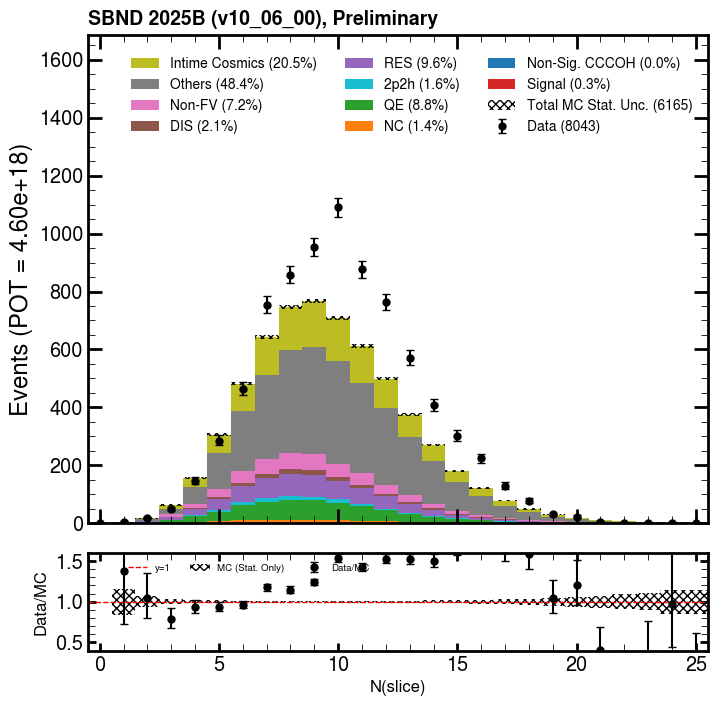

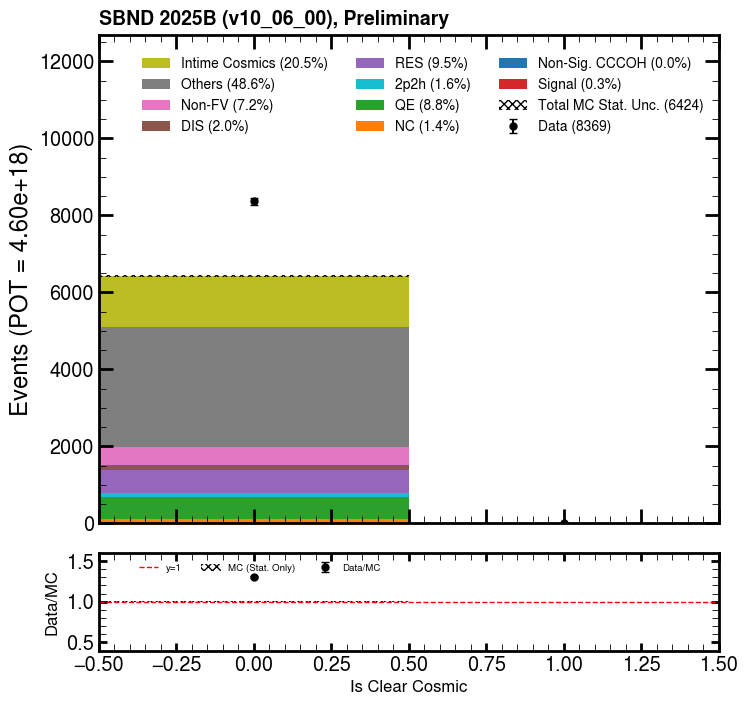

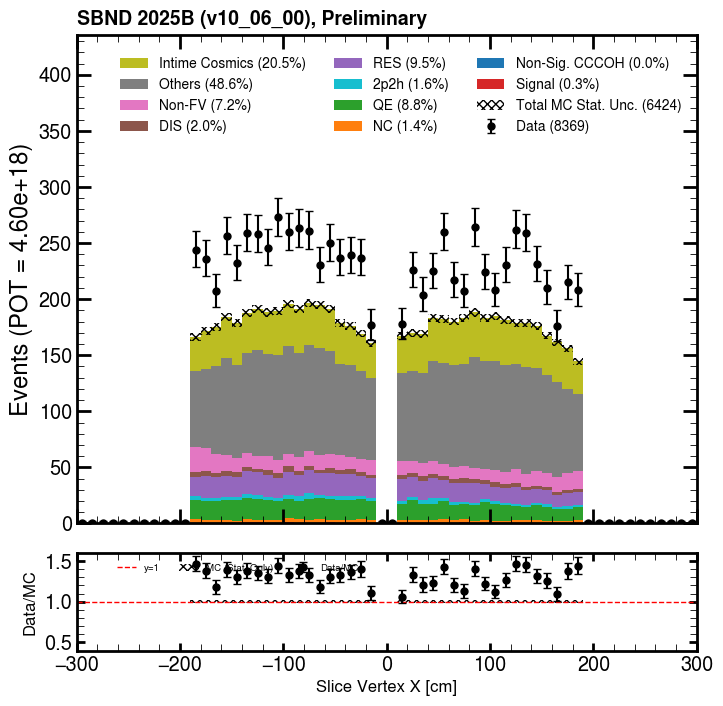

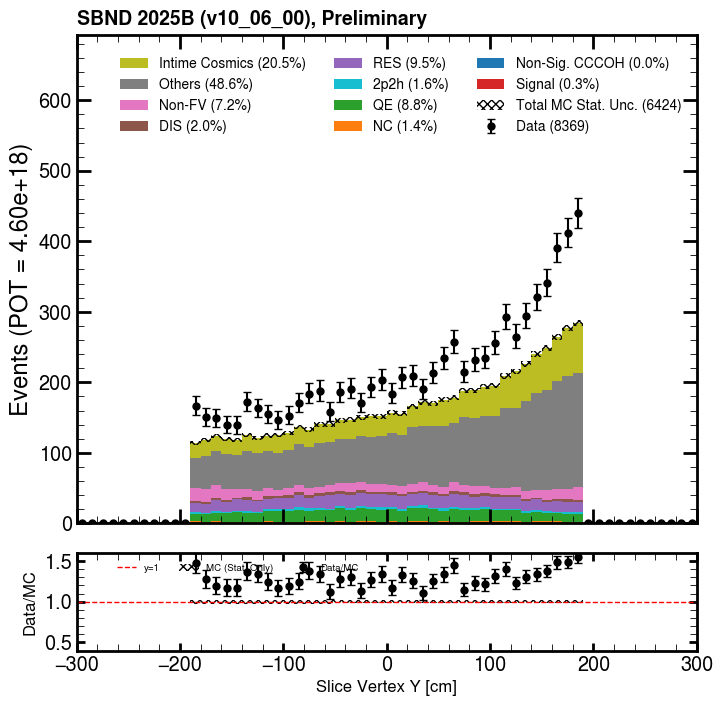

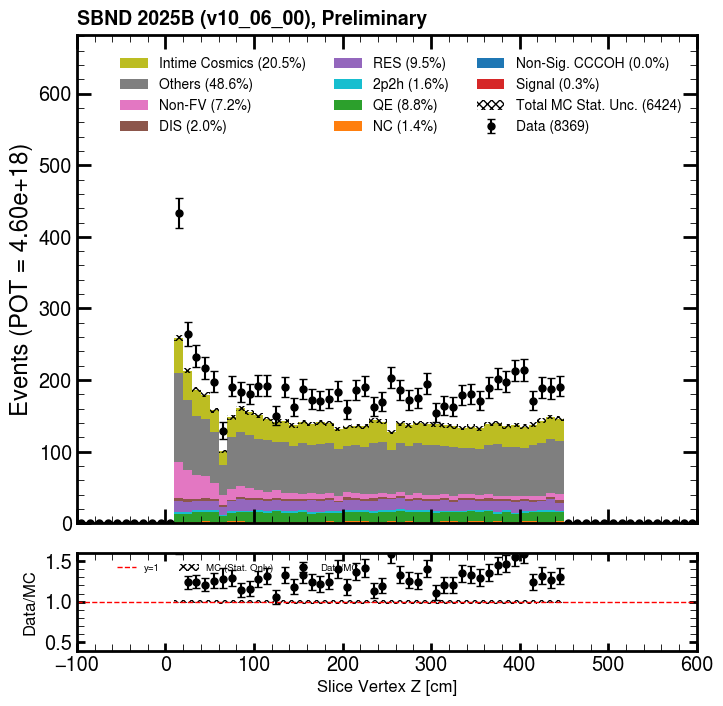

...

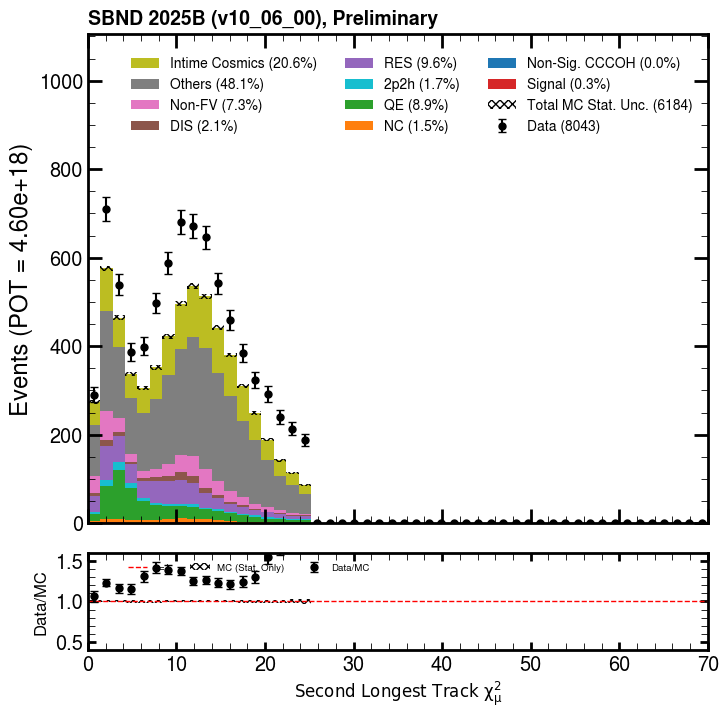

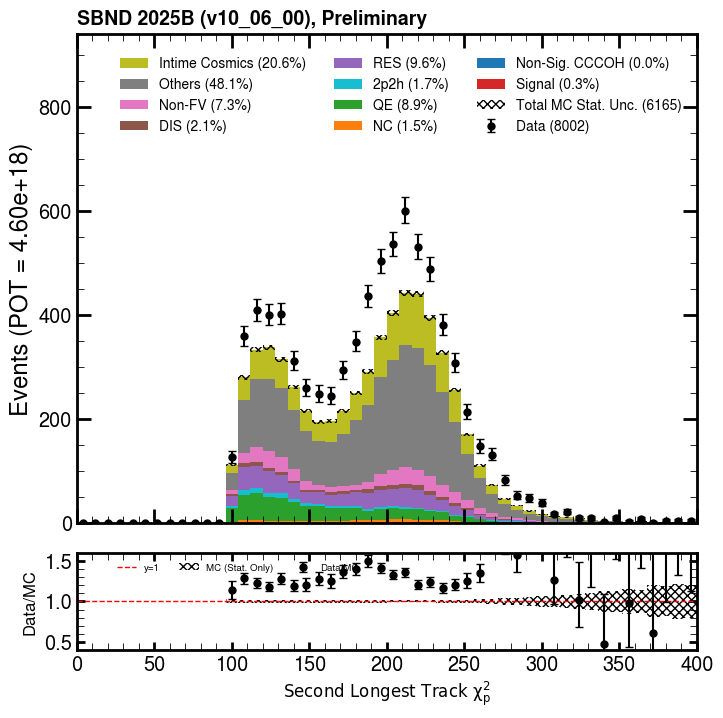

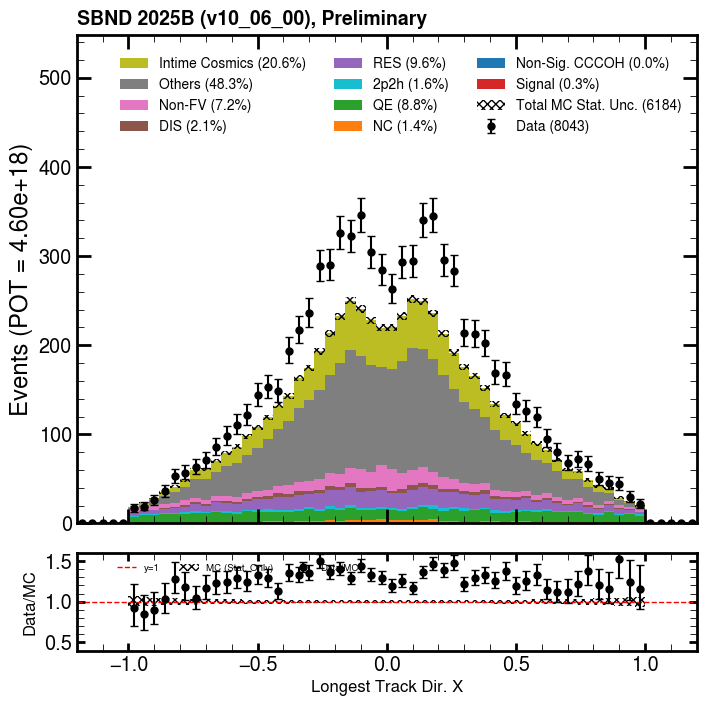

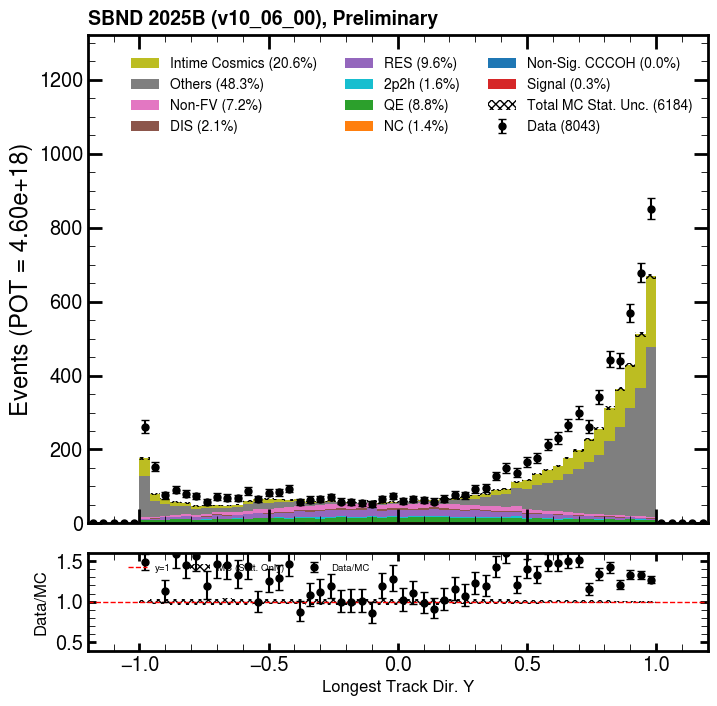

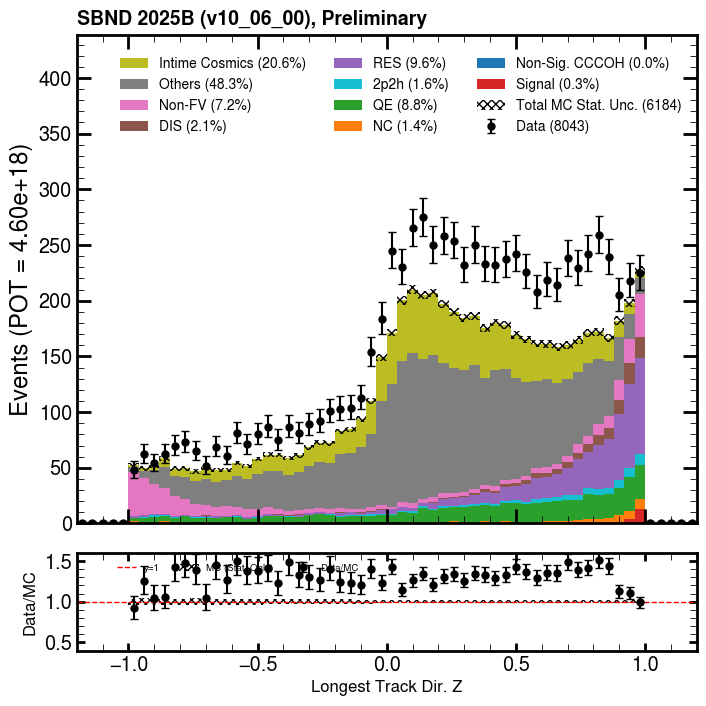

/tmp/ipykernel_3984300/631541511.py:191: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  ax_main.set_ylim(0.0, max_y * 1.5)


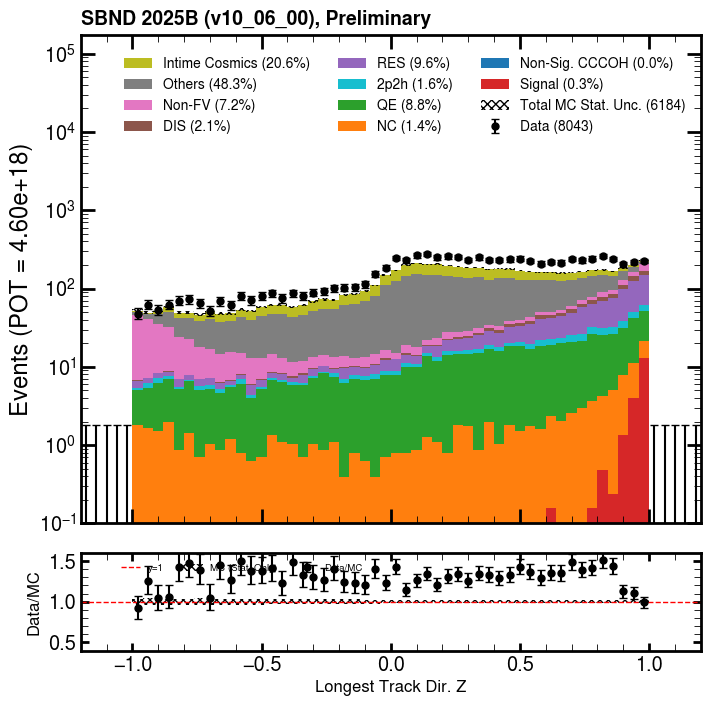

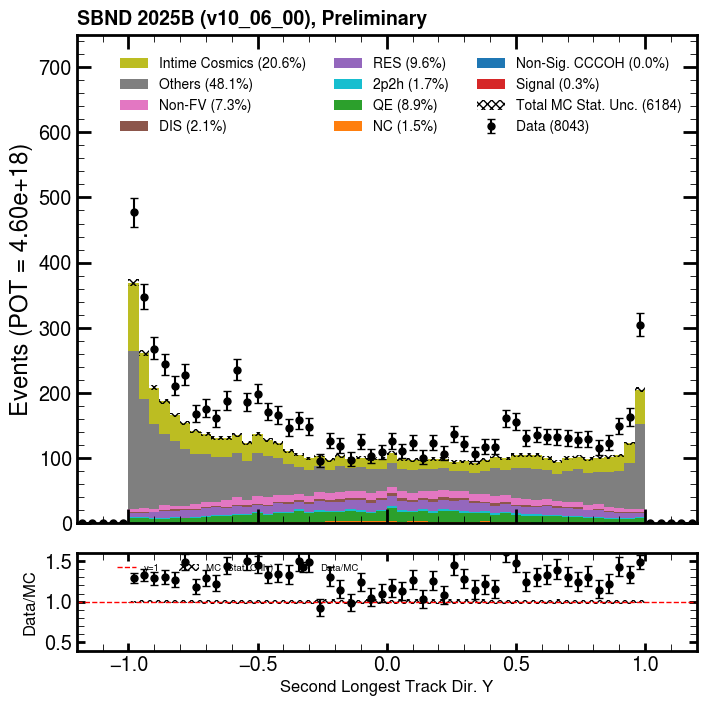

/tmp/ipykernel_3984300/631541511.py:191: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  ax_main.set_ylim(0.0, max_y * 1.5)


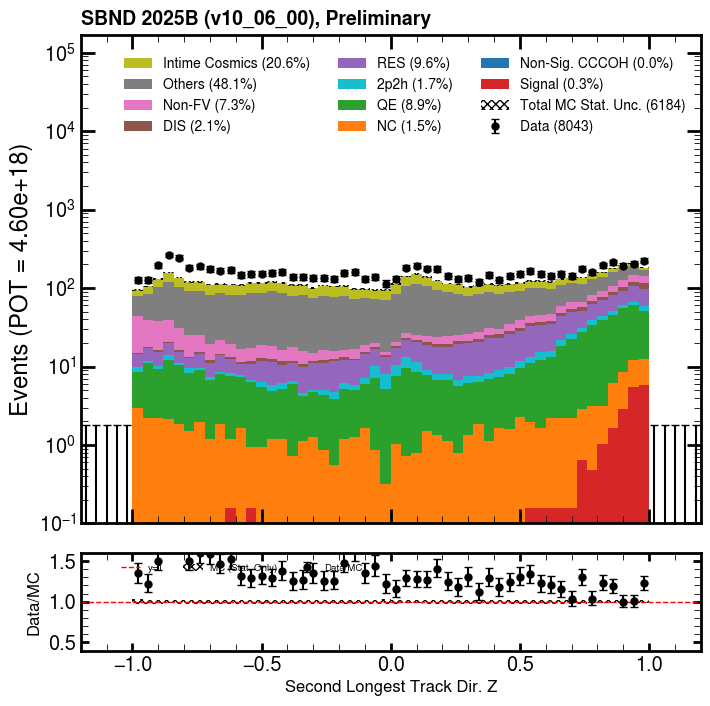

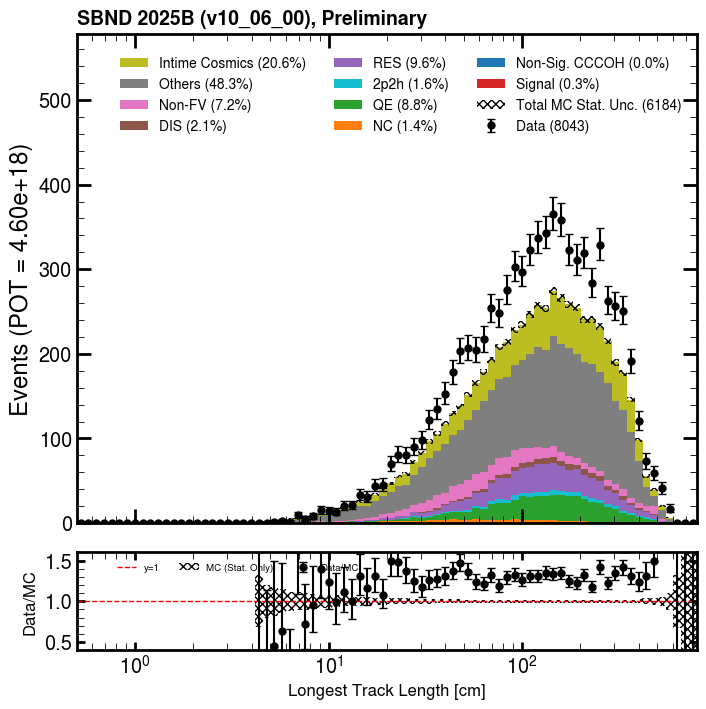

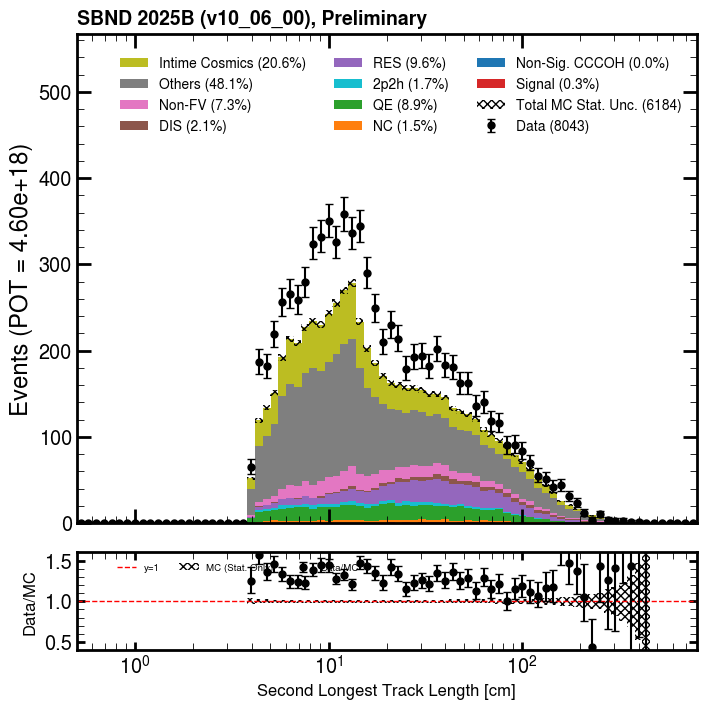

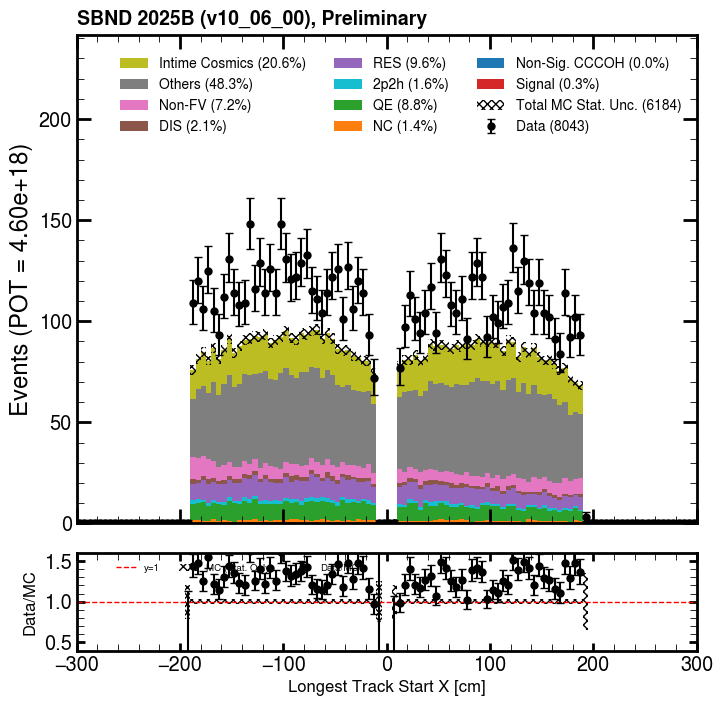

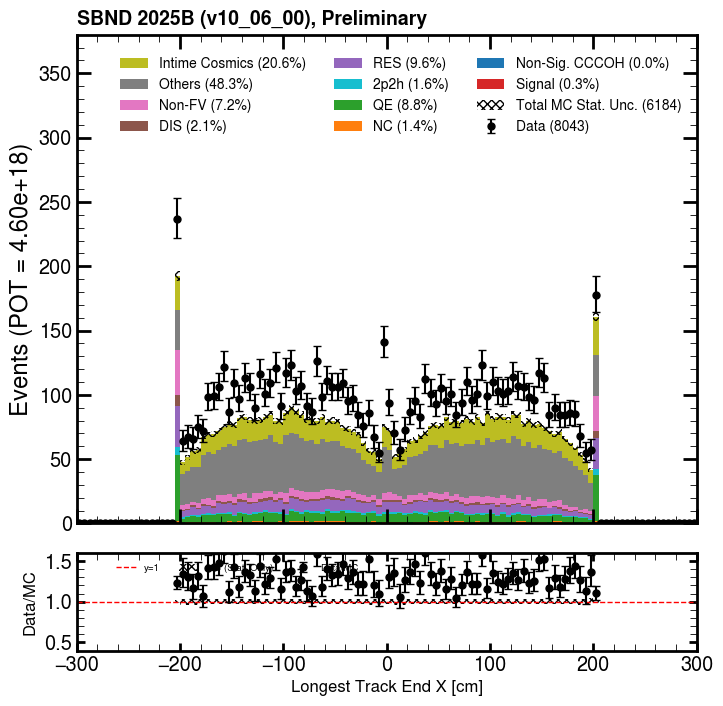

...

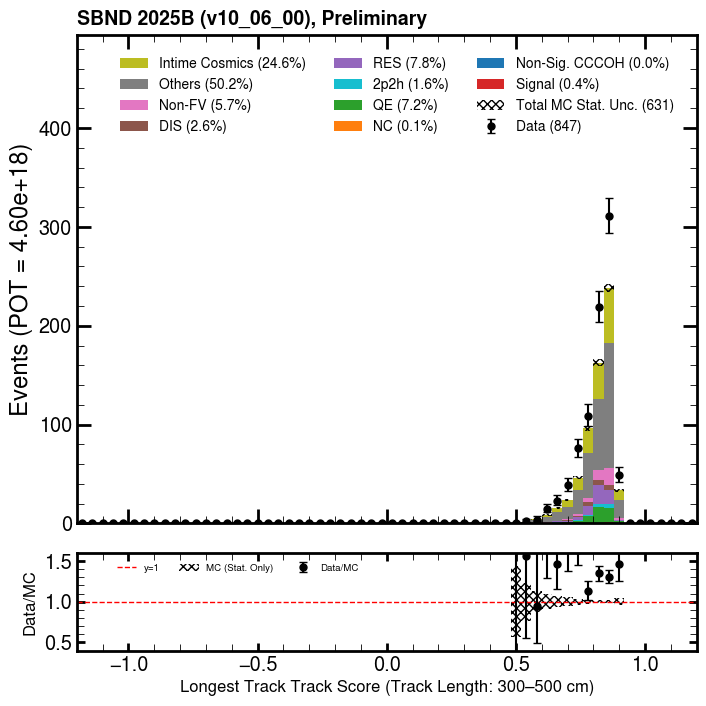

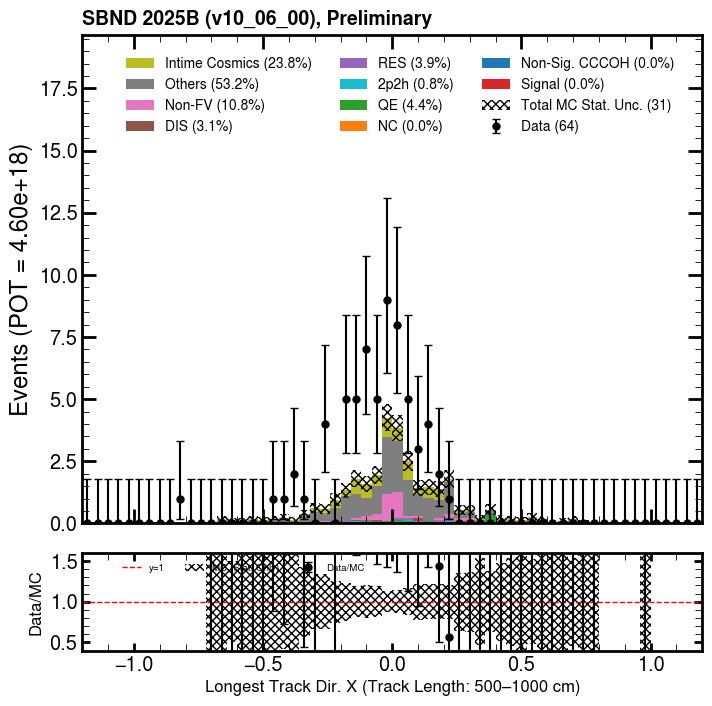

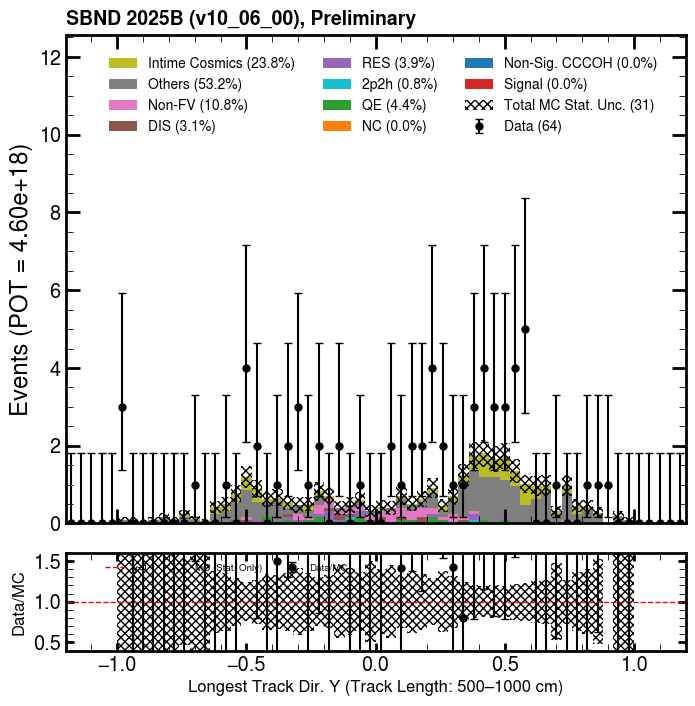

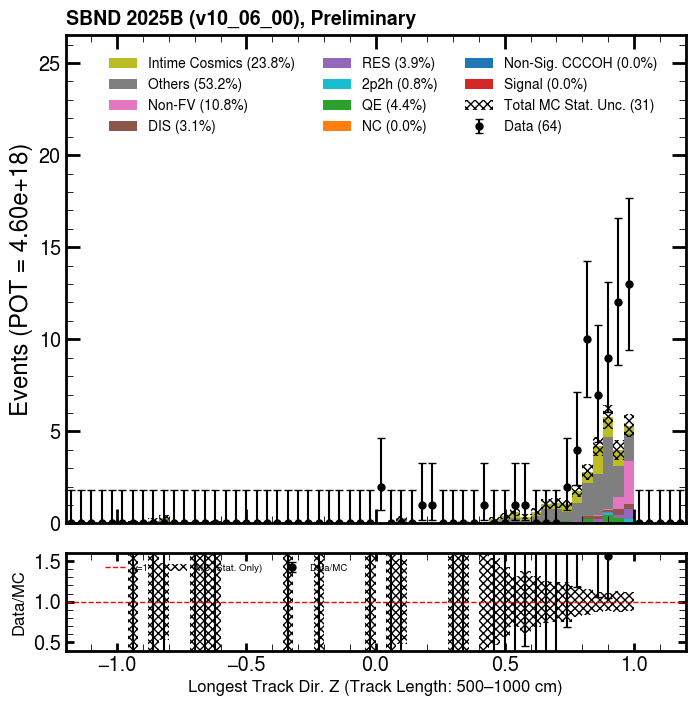

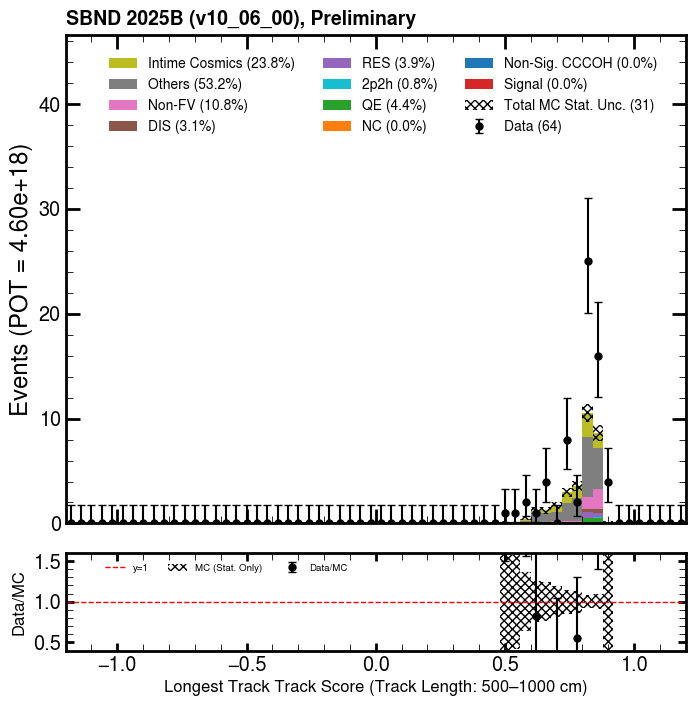

In [28]:
draw_reco_valid_plots(mc_reco_df, mc_intime_reco_df, data_reco_df, "e_n_chi2pid")

In [29]:
def apply_dir_z_cut(df):
    if '_trk_rank' in df.columns:
        df = df.drop(columns=[('_trk_rank', '', '', '', '', '')])

    df = df.sort_index()
    # Grouping by MultiIndex index levels
    group_keys = ['__ntuple', 'entry', 'rec.slc..index']  # passed as strings for MultiIndex levels

    # MultiIndex column names
    trk_dirz_col = ('pfp', 'trk', 'dir', 'z', '', '')
    trk_len_col  = ('pfp', 'trk', 'len', '', '', '')

    # Step 1: Rank track length descending per SLC group
    df['_trk_rank'] = df.groupby(level=group_keys)[[trk_len_col]] \
                        .rank(method='first', ascending=False)

    # Step 2: Apply cuts
    sel_longest  = (df['_trk_rank'] == 1) & (df[trk_dirz_col] > 0.7)
    sel_2nd_long = (df['_trk_rank'] == 2) & (df[trk_dirz_col] > 0.5)

    # Step 3: Keep only desired rows
    df = df[sel_longest | sel_2nd_long].drop(columns=['_trk_rank']).copy()

    if '_trk_rank' in df.columns:
        df = df.drop(columns=[('_trk_rank', '', '', '', '', '')])

    return df

In [30]:
mc_reco_df = apply_dir_z_cut(mc_reco_df)
mc_intime_reco_df = apply_dir_z_cut(mc_intime_reco_df)
data_reco_df = apply_dir_z_cut(data_reco_df)

/tmp/ipykernel_3984300/3343850982.py:22: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  df = df[sel_longest | sel_2nd_long].drop(columns=['_trk_rank']).copy()
/tmp/ipykernel_3984300/3343850982.py:22: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  df = df[sel_longest | sel_2nd_long].drop(columns=['_trk_rank']).copy()
/tmp/ipykernel_3984300/3343850982.py:22: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  df = df[sel_longest | sel_2nd_long].drop(columns=['_trk_rank']).copy()


In [31]:
mc_reco_df = pass_slc_with_n_pfps(mc_reco_df)
mc_intime_reco_df = pass_slc_with_n_pfps(mc_intime_reco_df)
data_reco_df = pass_slc_with_n_pfps(data_reco_df)

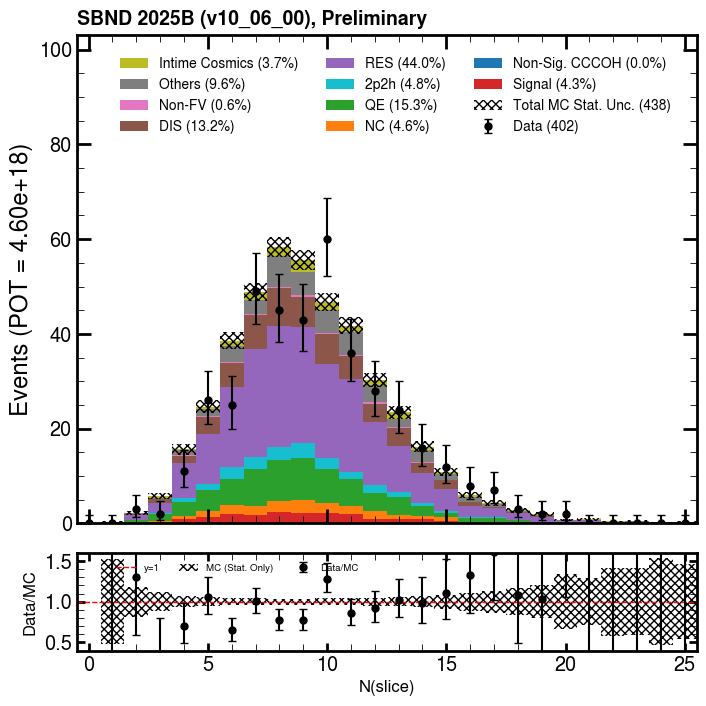

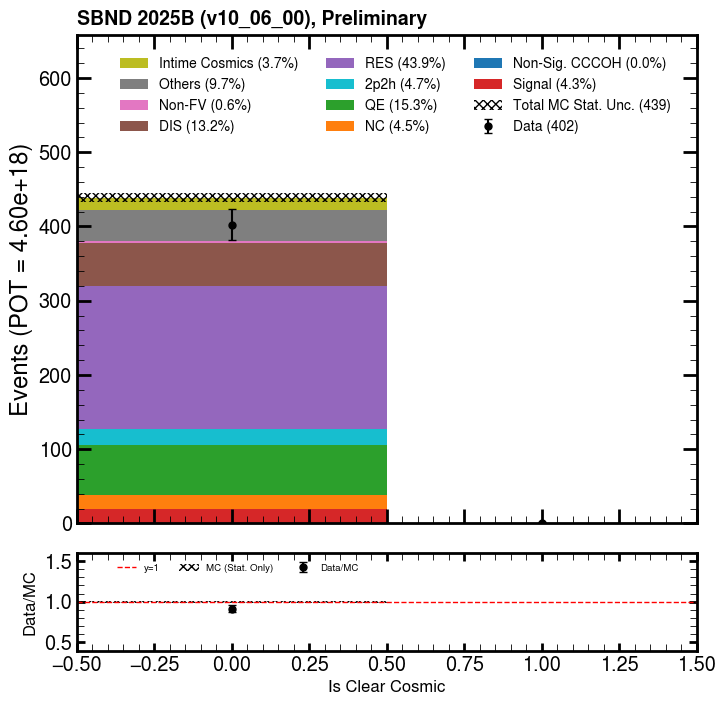

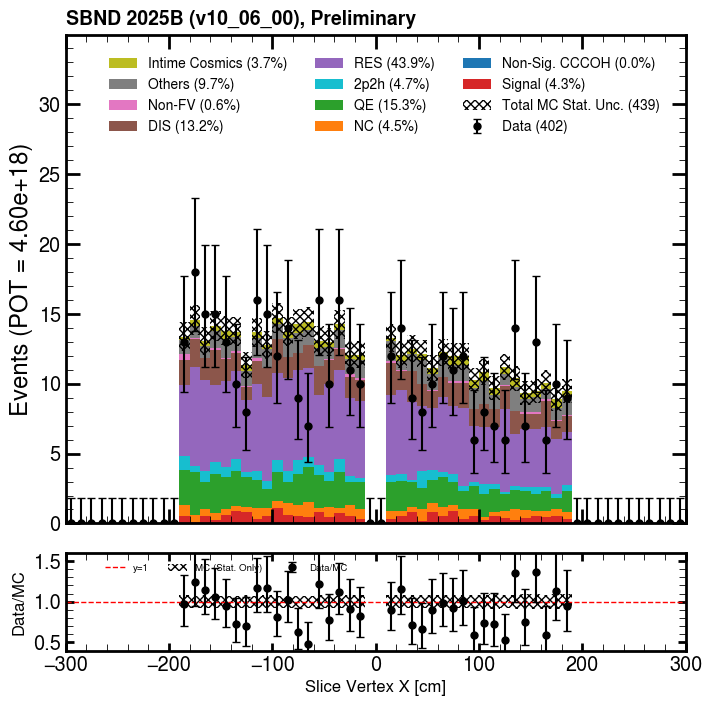

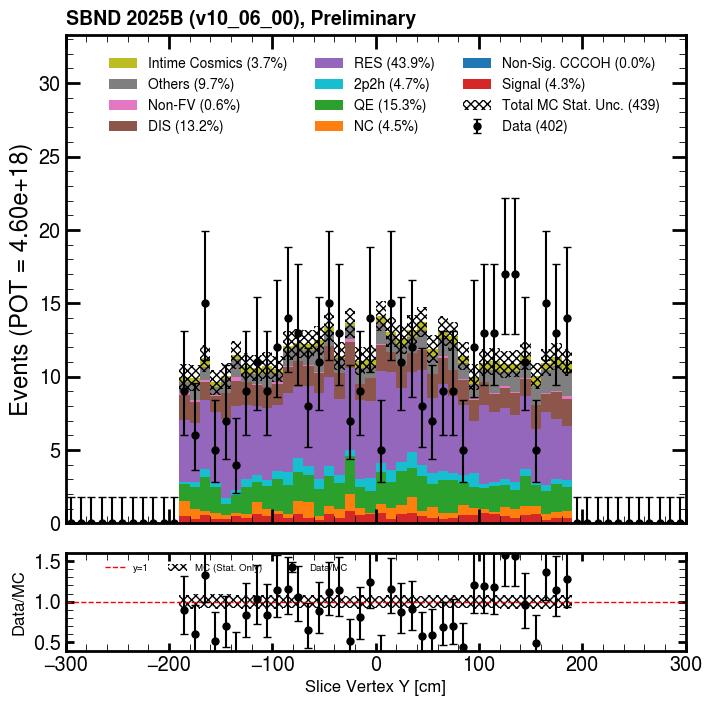

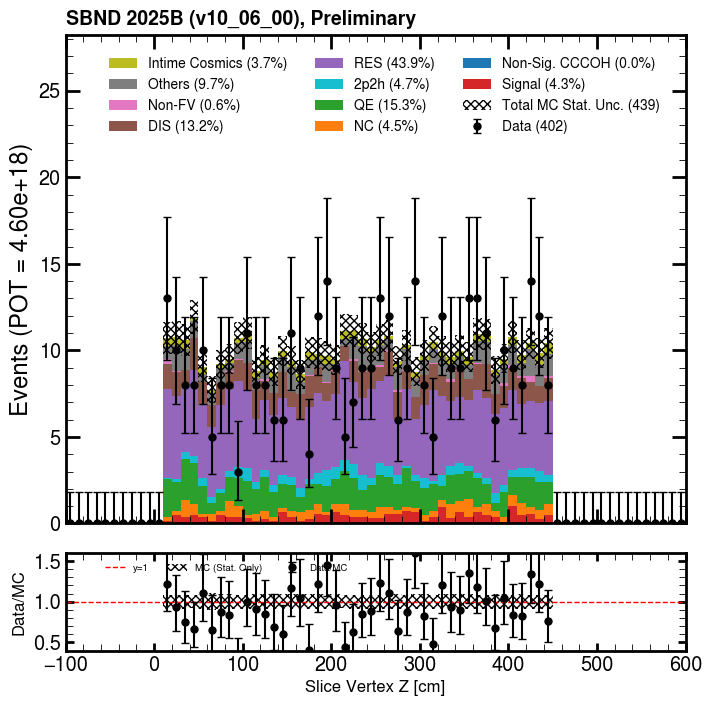

...

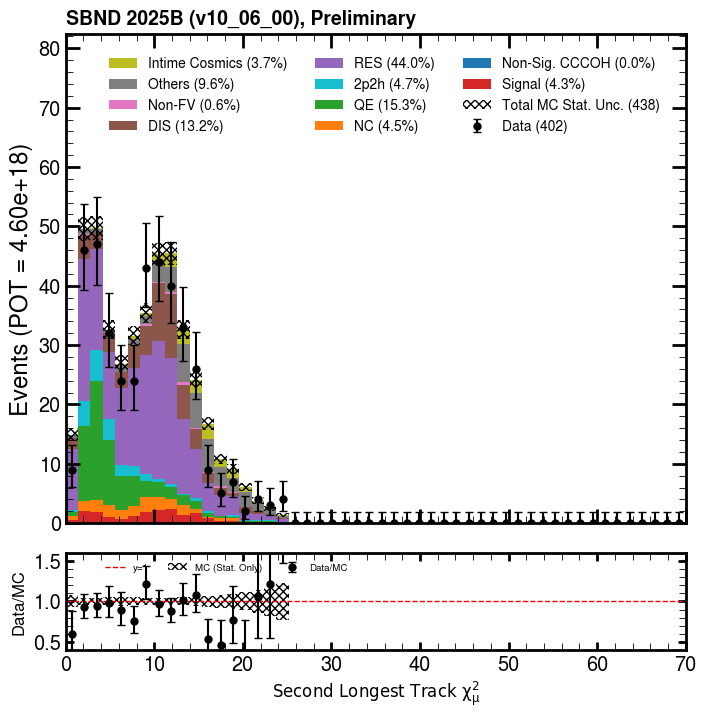

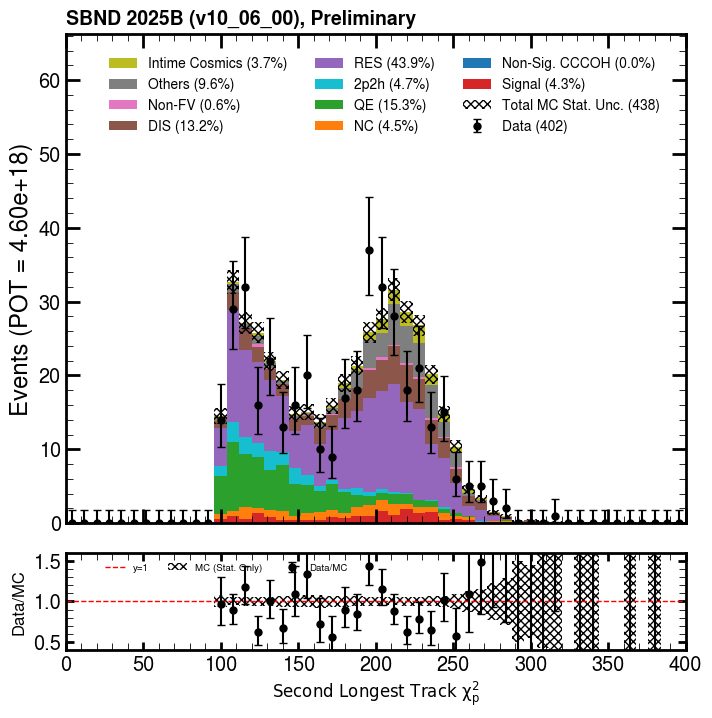

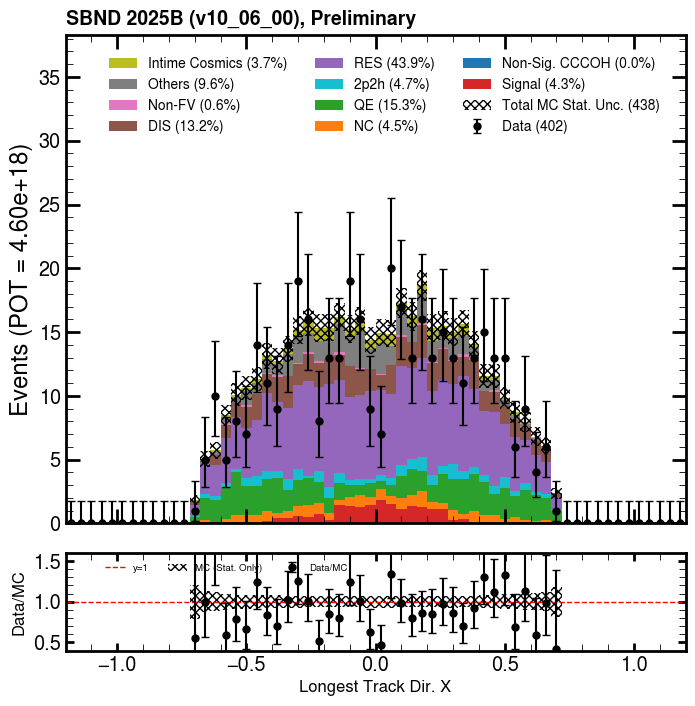

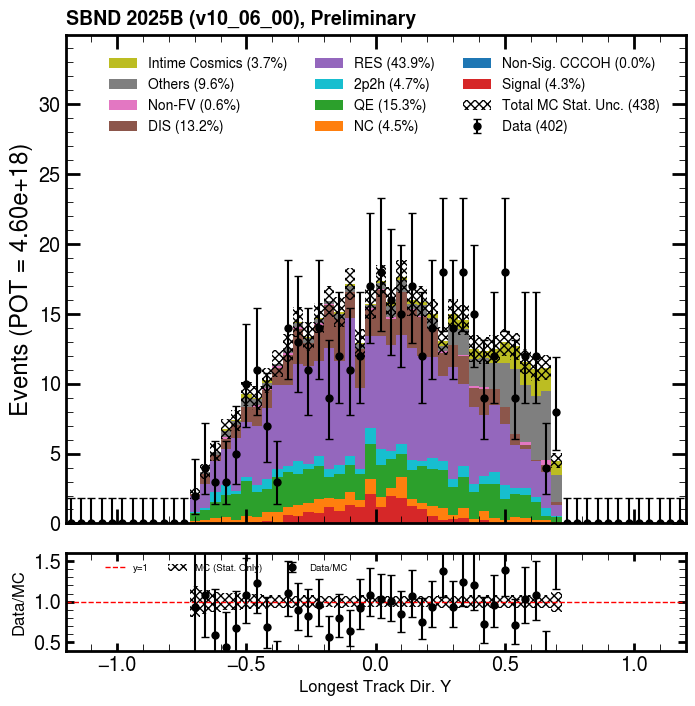

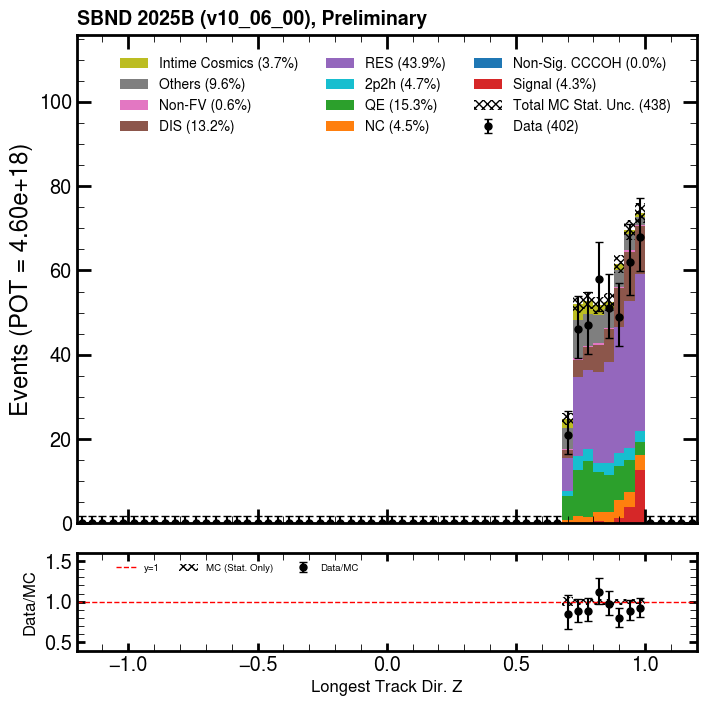

/tmp/ipykernel_3984300/631541511.py:191: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  ax_main.set_ylim(0.0, max_y * 1.5)


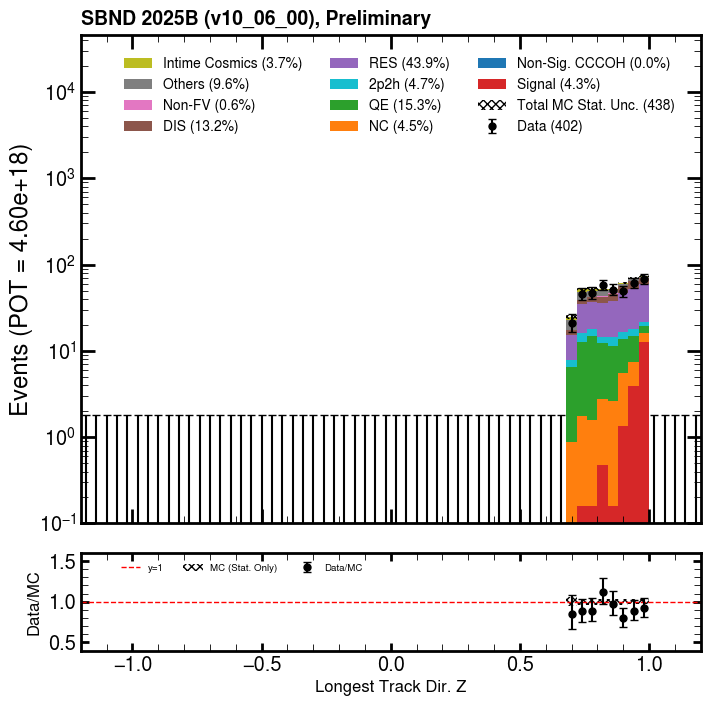

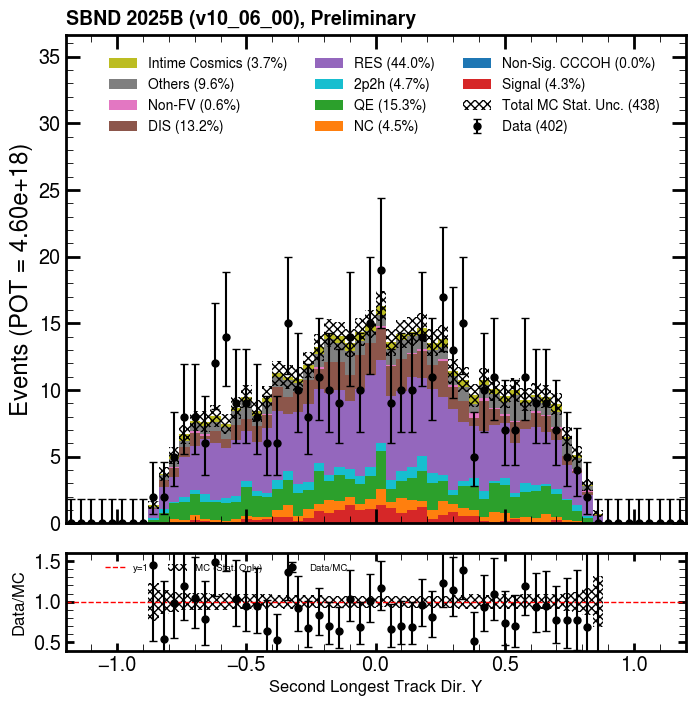

/tmp/ipykernel_3984300/631541511.py:191: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  ax_main.set_ylim(0.0, max_y * 1.5)


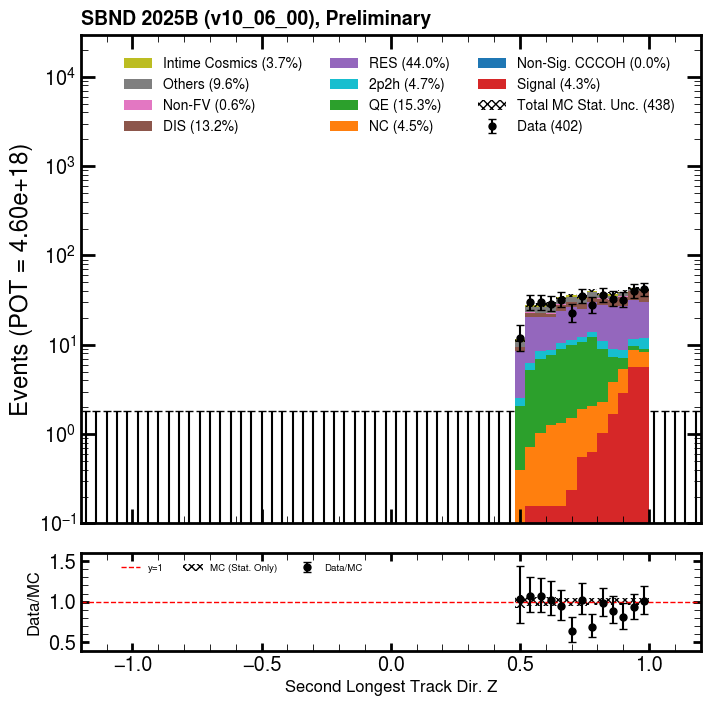

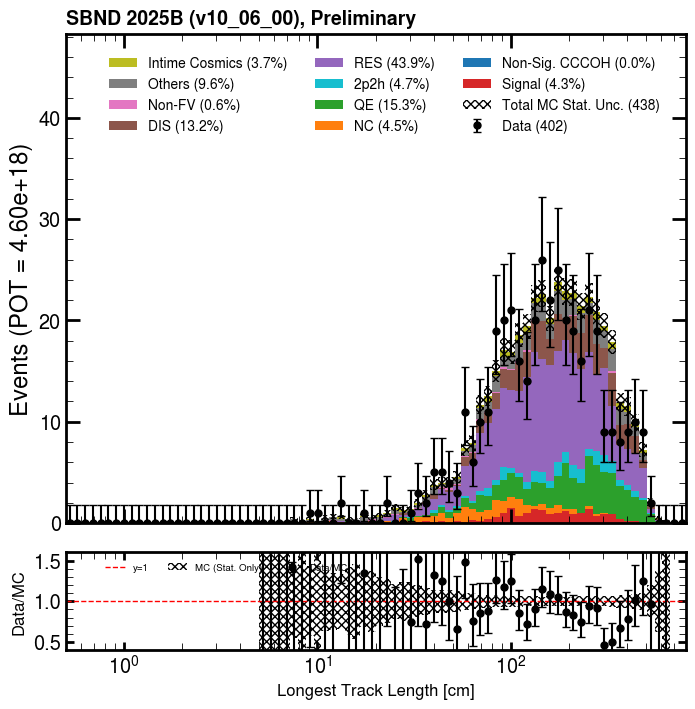

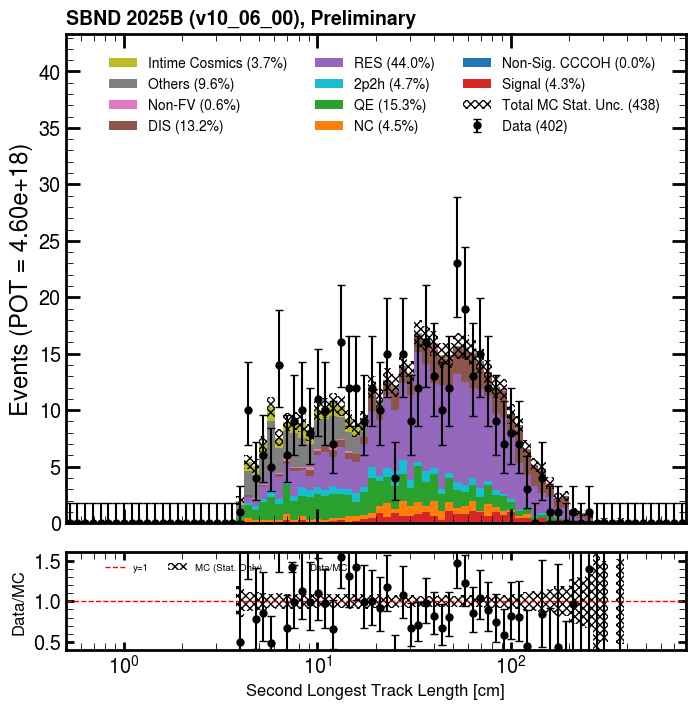

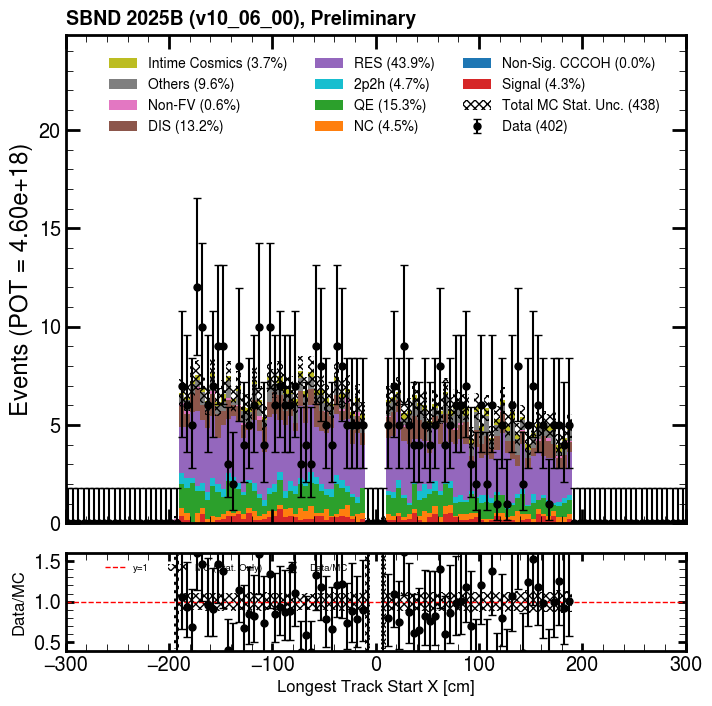

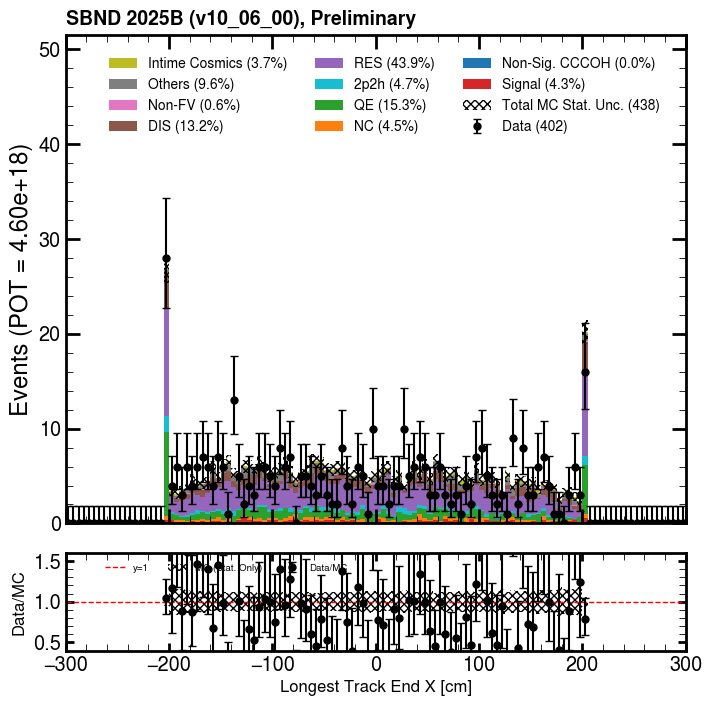

...

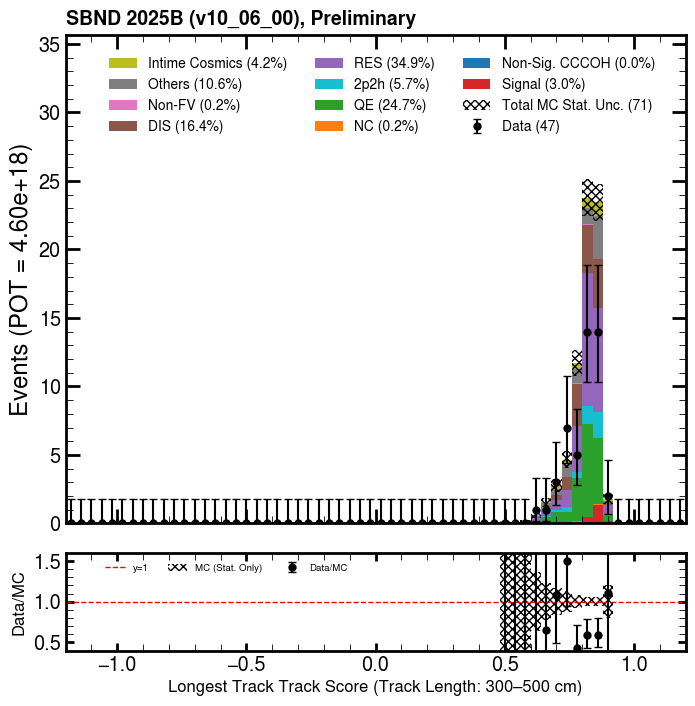

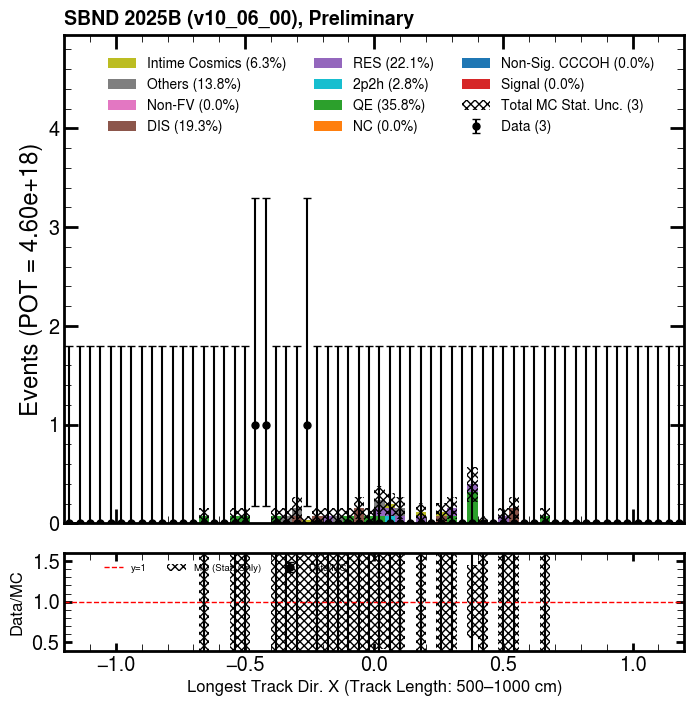

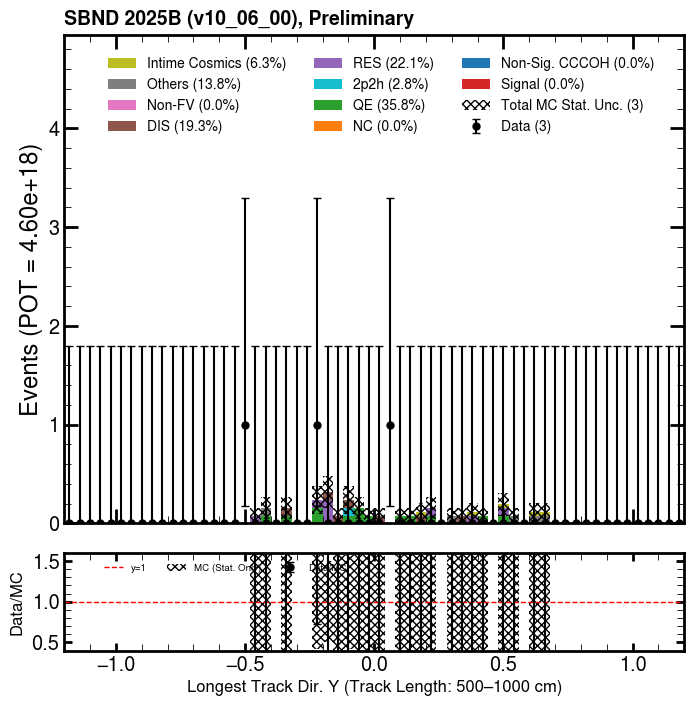

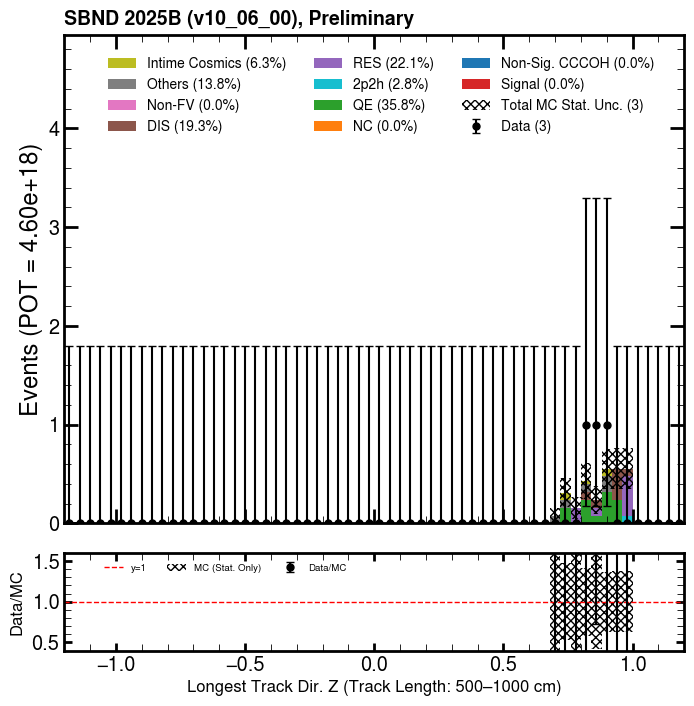

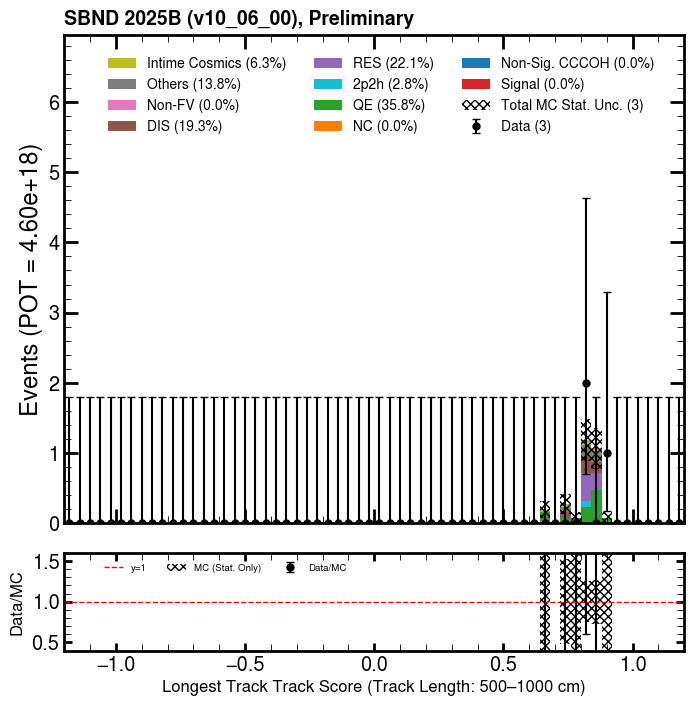

In [32]:
draw_reco_valid_plots(mc_reco_df, mc_intime_reco_df, data_reco_df, "f_dir_z")

In [33]:
mc_reco_t_series = mc_reco_df.groupby(['__ntuple', 'entry', 'rec.slc..index']).apply(cohreco.measure_reco_t)
mc_intime_reco_t_series = mc_intime_reco_df.groupby(['__ntuple', 'entry', 'rec.slc..index']).apply(cohreco.measure_reco_t)
data_reco_t_series = data_reco_df.groupby(['__ntuple', 'entry', 'rec.slc..index']).apply(cohreco.measure_reco_t)

In [34]:
mc_reco_df['reco_t'] = mc_reco_t_series
mc_intime_reco_df['reco_t'] = mc_intime_reco_t_series
data_reco_df['reco_t'] = data_reco_t_series

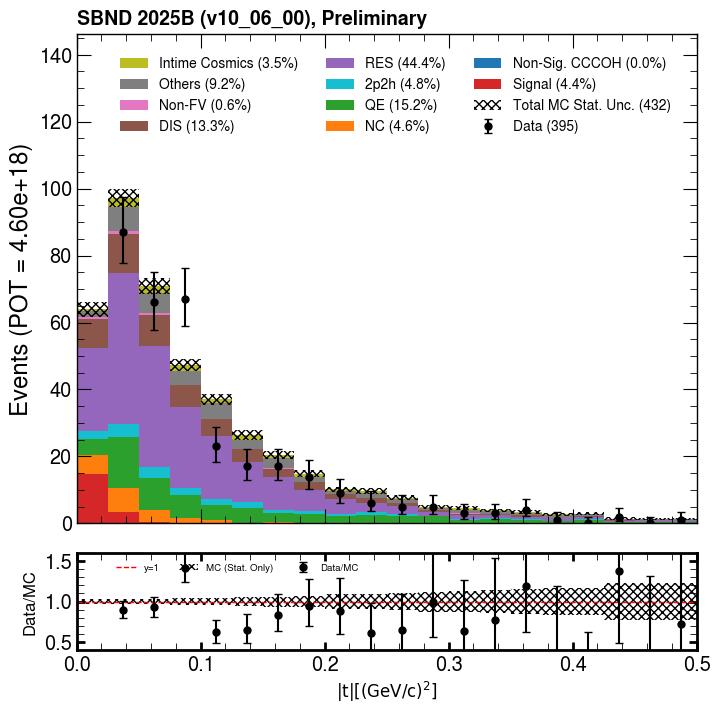

In [35]:
reco_t_col = ('reco_t', '', '', '', '', '')
#draw_mc_data_shape_comp_per_slc(mc_reco_df, mc_intime_reco_df, data_reco_df, reco_t_col, r"$\mathrm{|t| [(GeV/c)^2] }$", "A.U.", 0., 0.5, 20, "f_dir_z_reco_t", False, False)
draw_mc_data_shape_comp_per_slc_blind(mc_reco_df, mc_intime_reco_df, data_reco_df, reco_t_col, r"$\mathrm{|t| [(GeV/c)^2] }$", "A.U.", 0., 0.5, 20, "f_dir_z_reco_t", False, False, True, 0.1)

In [36]:
mc_open_angle_series = mc_reco_df.groupby(['__ntuple', 'entry', 'rec.slc..index']).apply(cohreco.measure_opening_angle)
mc_intime_open_angle_series = mc_intime_reco_df.groupby(['__ntuple', 'entry', 'rec.slc..index']).apply(cohreco.measure_opening_angle)
data_open_angle_series = data_reco_df.groupby(['__ntuple', 'entry', 'rec.slc..index']).apply(cohreco.measure_opening_angle)

mc_reco_df['open_ang'] = mc_open_angle_series
mc_intime_reco_df['open_ang'] = mc_intime_open_angle_series
data_reco_df['open_ang'] = data_open_angle_series

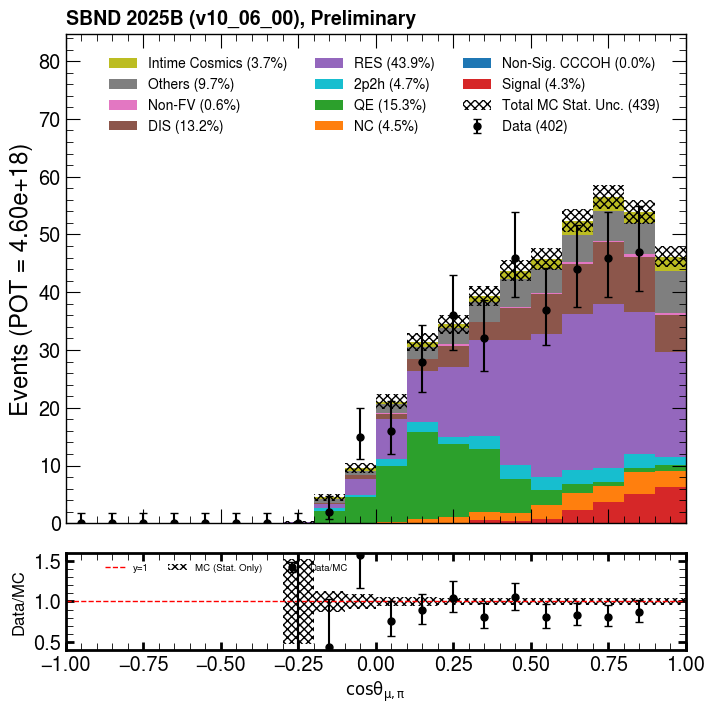

In [37]:
open_ang_col = ('open_ang', '', '', '', '', '')
draw_mc_data_shape_comp_per_slc_blind(mc_reco_df, mc_intime_reco_df, data_reco_df, open_ang_col, r"$\mathrm{cos\theta_{\mu,\pi} }$", "A.U.", -1., 1, 20, "f_dir_z_open_ang", False, False, True, 0.1)

In [38]:
mc_reco_df = mc_reco_df[mc_reco_df.open_ang > 0.5]
mc_intime_reco_df = mc_intime_reco_df[mc_intime_reco_df.open_ang > 0.5]
data_reco_df = data_reco_df[data_reco_df.open_ang > 0.5]


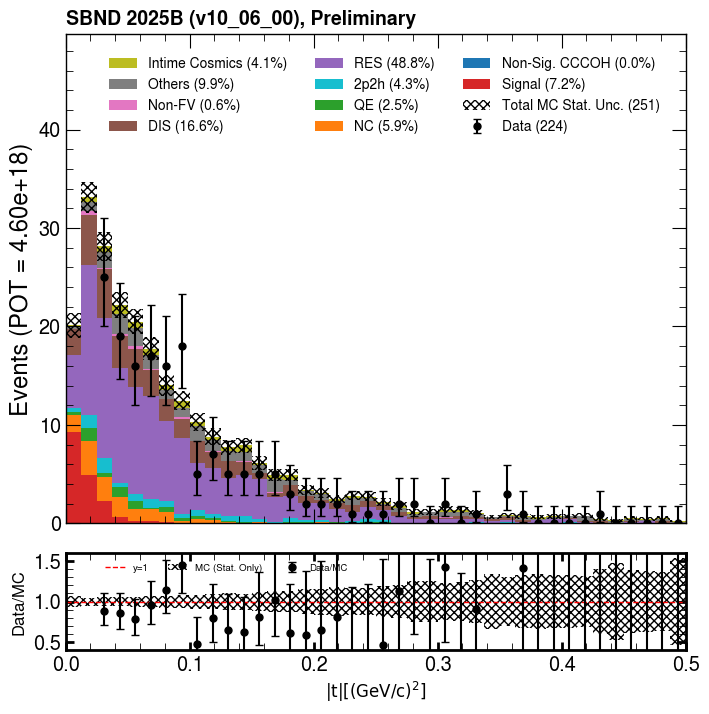

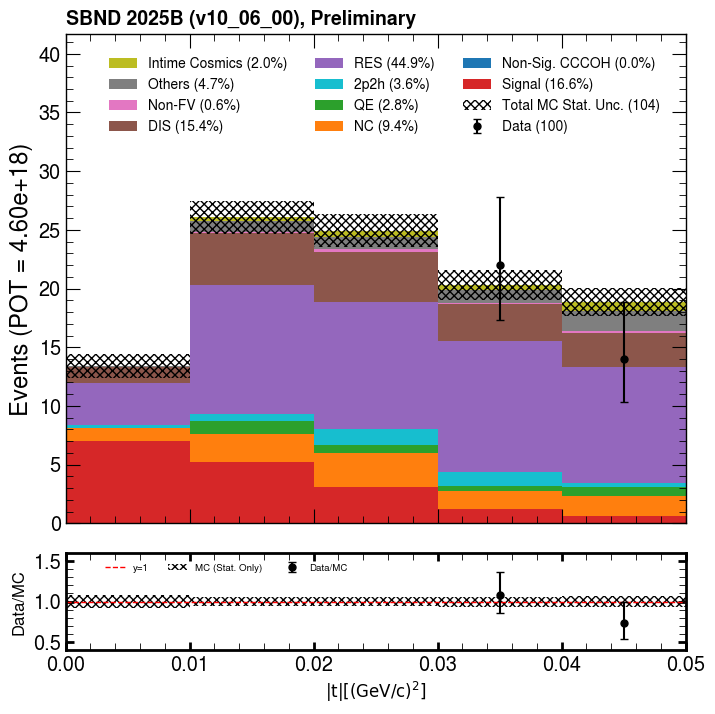

In [39]:
draw_mc_data_shape_comp_per_slc_blind(mc_reco_df, mc_intime_reco_df, data_reco_df, reco_t_col, r"$\mathrm{|t| [(GeV/c)^2] }$", "A.U.", 0., 0.5, 40, "g_open_angle_reco_t", False, False, True, 0.1)
draw_mc_data_shape_comp_per_slc_blind(mc_reco_df, mc_intime_reco_df, data_reco_df, reco_t_col, r"$\mathrm{|t| [(GeV/c)^2] }$", "A.U.", 0., 0.05, 5, "g_open_angle_reco_t_zoom", False, False, True)

In [40]:
def add_contained_col(df):
    containd = InFV_trk(df.pfp.trk.start) & InFV_trk(df.pfp.trk.end)
    df['containd'] = containd

In [41]:
## study track contained
add_contained_col(mc_reco_df)
add_contained_col(mc_intime_reco_df)
add_contained_col(data_reco_df)

In [42]:
mc_reco_df

slc  \
                                                      is_clear_cosmic   
                                                                        
                                                                        
                                                                        
                                                                        
__ntuple entry rec.slc..index rec.slc.reco.pfp..index                   
0        86    2              0                                     0   
                              1                                     0   
         254   1              0                                     0   
                              1                                     0   
         298   1              0                                     0   
..                                                                ...   
997      252   2              1                                     0   
998      102   0              0                                     0   
                              1                                     0   
999      636   1              0                                     0   
                              1                                     0   

                                                                               \
                                                           vertex               
                                                                x           y   
                                                                                
                                                                                
                                                                                
__ntuple entry rec.slc..index rec.slc.reco.pfp..index                           
0        86    2              0                       -117.487717   13.976361   
                              1                       -117.487717   13.976361   
         254   1              0                       -103.658310    7.415207   
                              1                       -103.658310    7.415207   
         298   1              0                        -72.704979  -80.194557   
..                                                            ...         ...   
997      252   2              1                        128.998199  106.277534   
998      102   0              0                       -138.006638 -129.928162   
                              1                       -138.006638 -129.928162   
999      636   1              0                         77.148178 -139.829117   
                              1                         77.148178 -139.829117   

                                                                        \
                                                                  self   
                                                                z        
                                                                         
                                                                         
                                                                         
__ntuple entry rec.slc..index rec.slc.reco.pfp..index                    
0        86    2              0                        431.055023   54   
                              1                        431.055023   54   
         254   1              0                         77.413338   28   
                              1                         77.413338   28   
         298   1              0                        140.333145   47   
..                                                            ...  ...   
997      252   2              1                         58.068371   69   
998      102   0              0                        430.015228   45   
                              1                        430.015228   45   
999      636   1              0                        426.995819   51   
                              1   

In [43]:
mc_reco_df = mc_reco_df[mc_reco_df.containd]
mc_intime_reco_df = mc_intime_reco_df[mc_intime_reco_df.containd]
data_reco_df = data_reco_df[data_reco_df.containd]

In [44]:
mc_reco_df = pass_slc_with_n_pfps(mc_reco_df)
mc_intime_reco_df = pass_slc_with_n_pfps(mc_intime_reco_df)
data_reco_df = pass_slc_with_n_pfps(data_reco_df)

In [45]:
#draw_reco_valid_plots(mc_reco_df, mc_intime_reco_df, data_reco_df, "h_n_contained_trk")

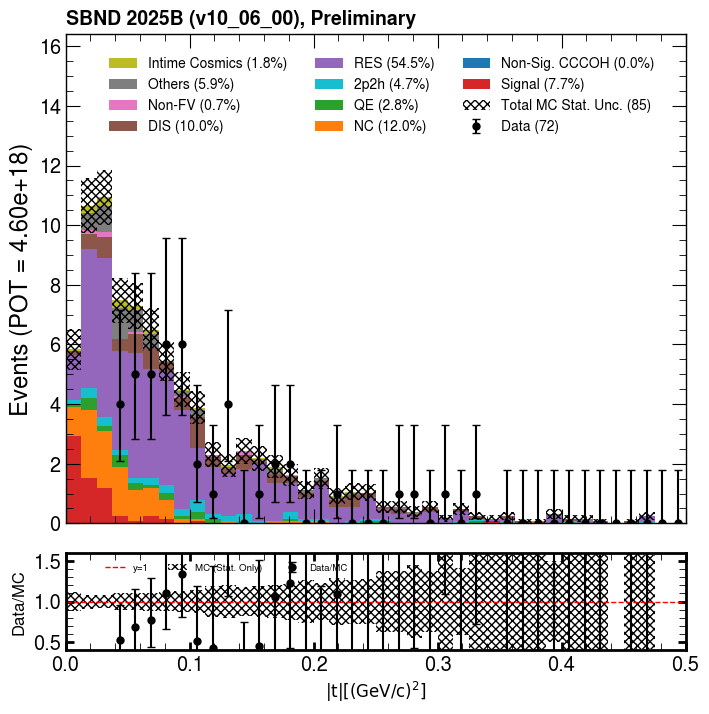

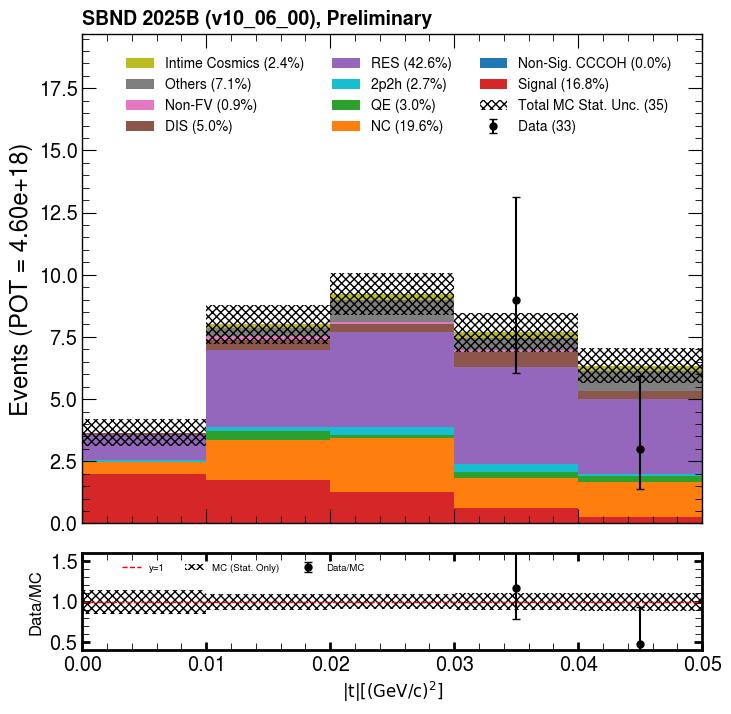

In [46]:
draw_mc_data_shape_comp_per_slc_blind(mc_reco_df, mc_intime_reco_df, data_reco_df, reco_t_col, r"$\mathrm{|t| [(GeV/c)^2] }$", "A.U.", 0., 0.5, 40, "h_n_contained_trk_reco_t", False, False, True)
draw_mc_data_shape_comp_per_slc_blind(mc_reco_df, mc_intime_reco_df, data_reco_df, reco_t_col, r"$\mathrm{|t| [(GeV/c)^2] }$", "A.U.", 0., 0.05, 5, "h_n_contained_trk_reco_t_zoom", False, False, True)